In [33]:
import scanpy as sc
import pandas as pd
import seaborn as sns
import numpy as np
from skimage import io
import matplotlib.pyplot as plt
import matplotlib.cm as cmx
import matplotlib.colors as colors
import sys
import os
os.environ['CUDA_LAUNCH_BLOCKING'] = "1"
import torch
import torch.optim as optim
import torch.nn as nn

import torchvision.transforms as transforms
import torchvision
from torch.utils.data import DataLoader
from torchvision.utils import make_grid
torch.manual_seed(0)
np.random.seed(0)
import random
random.seed(0)
# import PoE module
sys.path.append('/Users/siyuhe/Spatial_project')
import PoE.utils as utils
import PoE.dataloader_1002 as dataloader
import PoE.utils_plots as utils_plots
import PoE.main as main

import anndata
import json

In [141]:
sample_ids = [
            'MBC_1A',
             'CID444971',
        
            ]

In [165]:
# load all expression data  [spot x gene]
data_path = 'data'
sample_ids = [
             'MBC_1A',
             'MBC_1B',
             'MBC_2A',
             'MBC_2B',
             'MBC_3A',
             'MBC_3B',
             'MBC_4A',
             'MBC_4B',
             'CID4465',
             'CID444971',
             '1142243F',
             '1160920F'
            ]

In [35]:
lr_genes = pd.read_csv('~/Spatial_project/data/lr_genes.csv')

In [36]:
lr_genes

,Unnamed: 0,x
0,1,A2M
1,2,AANAT
2,3,ACE
3,4,ADAM10
4,5,ADAM12
...,...,...
1052,1053,ASGR1
1053,1054,TNFRSF11B
1054,1055,MPL
1055,1056,SIRPB1


In [37]:
# load all expression data  [spot x gene]
data_path = 'data'

for sample_id in sample_ids:
    data_path = '../data'
    if sample_id.startswith('MBC'):

        adata_sample = sc.read_visium(path=os.path.join(data_path, sample_id),library_id =  sample_id)
        adata_sample.var_names_make_unique()
        adata_sample.obs['sample']=sample_id
        #adata_sample.obs_names  = adata_sample.obs_names+'-'+sample_id
    else:
        adata_sample = sc.read_h5ad(os.path.join(data_path,sample_id, sample_id+'.h5ad'))
        adata_sample.var_names_make_unique()
        adata_sample.obs['sample']=sample_id
        #adata_sample.obs_names  = adata_sample.obs_names+'-'+sample_id
        
    cluster_id = pd.DataFrame((np.zeros(len(adata_sample.obs_names))*(-1)).astype(int),columns=['clusters'],index=adata_sample.obs_names)
    
    col_order_df = pd.read_csv('../results/03_hubs/'+'RNA_alltumors_bicluster_res_col_orders_individual.csv')
    row_order_df = pd.read_csv('../results/03_hubs/'+'RNA_alltumors_bicluster_res_row_orders_individual.csv')
    
    map_info = pd.read_csv("../results/02_PoE_factor/"+sample_id+'map_info.csv',index_col=0)
    


    exp_df_B = adata_sample.to_df()
    exp_df_B = exp_df_B[exp_df_B.columns.intersection(lr_genes.x)]
    
    exp_df_B.to_csv('../results/04_pairs/'+sample_id+'gexp.csv')

In [361]:
exp_df_B

,AGRN,TNFRSF14,CORT,NPPA,NPPB,TNFRSF1B,EPHA2,MFAP2,CELA3B,EPHA8,...,CELSR1,PLXNB2,ADM2,APP,DSCAM,SLC37A1,ITGB2,COL18A1,COL6A1,COL6A2
AAACACCAATAACTGC-1-MBC_1A,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,2.0,0.0,0.0,0.0,1.0,5.0,8.0
AAACAGCTTTCAGAAG-1-MBC_1A,4.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0,...,2.0,3.0,0.0,0.0,0.0,0.0,3.0,6.0,7.0,5.0
AAACAGGGTCTATATT-1-MBC_1A,5.0,1.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,...,3.0,3.0,0.0,7.0,0.0,1.0,0.0,1.0,1.0,4.0
AAACATGGTGAGAGGA-1-MBC_1A,2.0,0.0,0.0,0.0,0.0,2.0,0.0,3.0,0.0,0.0,...,0.0,4.0,1.0,7.0,0.0,1.0,3.0,8.0,23.0,21.0
AAACCGGGTAGGTACC-1-MBC_1A,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5.0,2.0,7.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTGTTCAGTGTGCTAC-1-MBC_1A,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,2.0
TTGTTGTGTGTCAAGA-1-MBC_1A,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,2.0,3.0
TTGTTTCACATCCAGG-1-MBC_1A,2.0,1.0,0.0,0.0,0.0,0.0,1.0,7.0,0.0,0.0,...,0.0,2.0,2.0,1.0,0.0,0.0,2.0,1.0,65.0,69.0
TTGTTTCATTAGTCTA-1-MBC_1A,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,13.0,16.0


## Plot image reconstructionfig


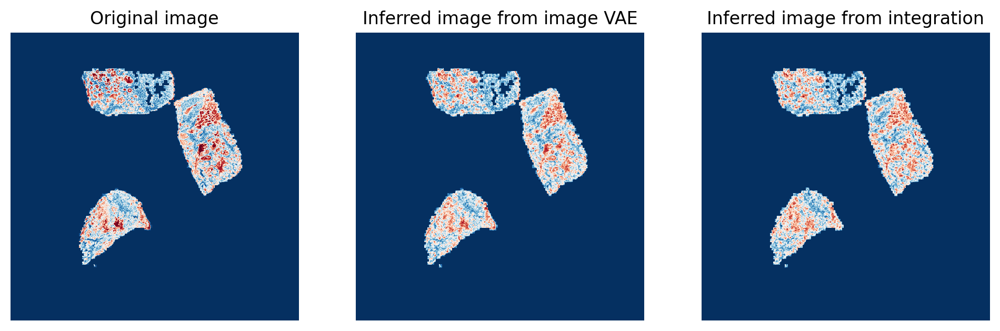

In [38]:

for sample_id in sample_ids:
    wholeimg_stitch  = np.load("../results/02_PoE_factor/"+sample_id+'wholeimg_stitch.npy')
    recon_wholeimg_stitch = np.load("../results/02_PoE_factor/"+sample_id+'recon_wholeimg_stitch.npy')
    recon_poe_wholeimg_stitch = np.load("../results/02_PoE_factor/"+sample_id+'recon_poe_wholeimg_stitch.npy')

    fig,axs=plt.subplots(1,3,figsize=(12,5),dpi=200)
    image_slide_z = 0
    vmax = 0.8
    vmin = 0

    ax=axs[0]
    ax.imshow(wholeimg_stitch[:,:,image_slide_z],cmap='RdBu_r',vmax=vmax,vmin=vmin)
    ax.axis('off')
    ax.set_title('Original image')

    ax=axs[1]
    ax.imshow(recon_wholeimg_stitch[:,:,image_slide_z],cmap='RdBu_r',vmax=vmax,vmin=vmin)
    ax.axis('off')
    ax.set_title('Inferred image from image VAE')

    ax=axs[2]
    ax.imshow(recon_poe_wholeimg_stitch[:,:,image_slide_z],cmap='RdBu_r',vmax=vmax,vmin=vmin)
    ax.axis('off')
    ax.set_title('Inferred image from integration')

## Plot rna reconstructionfig

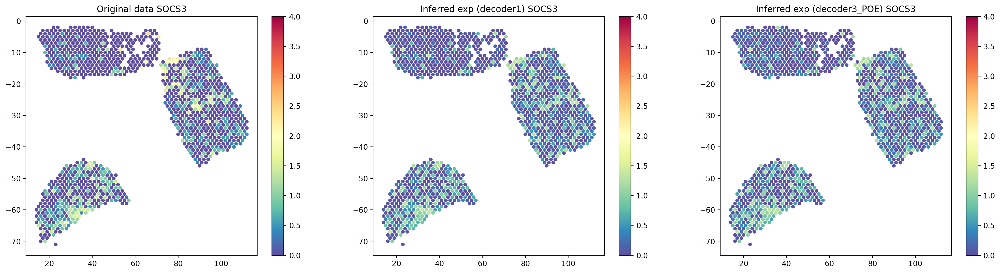

In [39]:


for sample_id in sample_ids:
    
    plotted_gene='SOCS3'

    c_max = 4
    c_min = 0

    fig,axs=plt.subplots(1,3,figsize=(24,6),dpi=200)

    ax=axs[0]
    
    adata_df_concat = pd.read_csv("../results/02_PoE_factor/"+sample_id+'adata_df_concat.csv')
    adata_df_concat.index = adata_df_concat.iloc[:,0]
    adata_df_concat = adata_df_concat.drop(adata_df_concat.columns[0], axis=1)
    
    map_info = pd.read_csv("../results/02_PoE_factor/"+sample_id+'map_info.csv')
    recon_exp_stack = np.load("../results/02_PoE_factor/"+sample_id+'recon_exp_stack.npy')
    recon_poe_rna_stack = np.load("../results/02_PoE_factor/"+sample_id+'recon_poe_rna_stack.npy')

    
    
    all_spot = np.array(adata_df_concat[ [spot_id.split('-')[-1]==sample_id for spot_id in adata_df_concat.index ]])
    all_loc = np.array(map_info.loc[map_info['sample']==sample_id,['array_col','array_row']])

    g=ax.scatter(all_loc[:,0],-all_loc[:,1],s=15,c=all_spot[:,np.where(adata_df_concat.columns==plotted_gene)[0][0]],cmap='Spectral_r',vmax=c_max,vmin=c_min)
    plt.colorbar(g, ax=ax)
    ax.set_title('Original data '+plotted_gene)


    ax=axs[1]
    all_spot = recon_exp_stack[ [spot_id.split('-')[-1]==sample_id for spot_id in adata_df_concat.index ]]
    all_loc = np.array(map_info.loc[map_info['sample']==sample_id,['array_col','array_row']])
    g=ax.scatter(all_loc[:,0],-all_loc[:,1],s=15,c=all_spot[:,np.where(adata_df_concat.columns==plotted_gene)[0][0]],cmap='Spectral_r',vmax=c_max,vmin=c_min)
    plt.colorbar(g, ax=ax)
    ax.set_title('Inferred exp (decoder1) '+plotted_gene)

    ax=axs[2]
    all_spot = recon_poe_rna_stack[ [spot_id.split('-')[-1]==sample_id for spot_id in adata_df_concat.index ]]
    all_loc = np.array(map_info.loc[map_info['sample']==sample_id,['array_col','array_row']])
    g=ax.scatter(all_loc[:,0],-all_loc[:,1],s=15,c=all_spot[:,np.where(adata_df_concat.columns==plotted_gene)[0][0]],cmap='Spectral_r',vmax=c_max,vmin=c_min)
    plt.colorbar(g, ax=ax)
    ax.set_title('Inferred exp (decoder3_POE) '+plotted_gene)
    
    
    wholeimg_stitch  = np.load("../results/02_PoE_factor/"+sample_id+'wholeimg_stitch.npy')
    recon_wholeimg_stitch = np.load("../results/02_PoE_factor/"+sample_id+'recon_wholeimg_stitch.npy')
    recon_poe_wholeimg_stitch = np.load("../results/02_PoE_factor/"+sample_id+'recon_poe_wholeimg_stitch.npy')
    

In [192]:
adata_df_concat.loc[:,plot_genes]

,BUB3,LYST,DEDD,HLA-DRA,PAPOLA,SOX4,ACTR3B,EIF3D,CACYBP,APOE,...,CD74,SPARC,YBX1,HLA-A,CRABP1,KRT17,HLA-DPB1,COL6A1,MFGE8,CYBA
Unnamed: 0,,,,,,,,,,,,,,,,,,,,,
AACATTGGTCAGCCGT-1-CID444971,0.000000,0.0,0.000000,4.016650,0.000000,0.000000,0.000000,0.000000,0.000000,2.682986,...,2.682986,0.000000,2.682986,2.682986,0.000000,0.000000,2.682986,2.682986,0.000000,0.000000
CATCGAATGGATCTCT-1-CID444971,0.000000,0.0,1.671277,1.671277,0.000000,1.671277,0.000000,1.671277,0.000000,2.905579,...,2.265704,2.265704,0.000000,1.671277,0.000000,1.671277,2.635972,1.671277,0.000000,1.671277
CGGGTTGTAGCTTTGG-1-CID444971,0.000000,0.0,0.000000,2.011071,0.000000,1.443538,0.000000,1.231610,0.000000,2.443727,...,2.443727,1.618313,0.592727,2.292338,0.962345,1.443538,1.896480,0.592727,1.443538,0.962345
CCTAAGTGTCTAACCG-1-CID444971,0.000000,0.0,0.000000,2.519936,0.000000,2.519936,0.000000,0.000000,0.000000,2.519936,...,2.519936,0.000000,0.000000,2.519936,0.000000,2.519936,0.000000,0.000000,0.000000,0.000000
TCTGTGACTGACCGTT-1-CID444971,0.000000,0.0,0.000000,1.931606,0.906299,0.906299,0.000000,1.373789,0.906299,2.287560,...,1.931606,0.906299,0.906299,1.373789,0.000000,2.427103,0.906299,0.000000,1.691098,2.125338
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TGCAGTGGTAGGGAAC-1-CID444971,0.000000,0.0,0.000000,2.605988,0.000000,0.000000,1.128419,0.000000,1.128419,3.338612,...,3.177989,3.539575,0.000000,2.875040,0.000000,2.438325,1.984073,0.000000,2.438325,1.984073
AGCGAGACGTGAAGGC-1-CID444971,1.193657,0.0,0.000000,2.525379,0.000000,1.492609,0.000000,1.193657,0.000000,2.694272,...,3.269203,2.613387,1.193657,2.964912,1.909218,3.536233,1.722454,2.322045,1.193657,0.000000
CAGTGTTAATCTCTCA-1-CID444971,0.000000,0.0,0.000000,1.509917,1.509917,0.000000,0.000000,0.000000,0.000000,2.449198,...,2.449198,1.509917,0.000000,2.449198,0.000000,1.509917,0.000000,1.509917,1.509917,1.509917


working on  CID444971


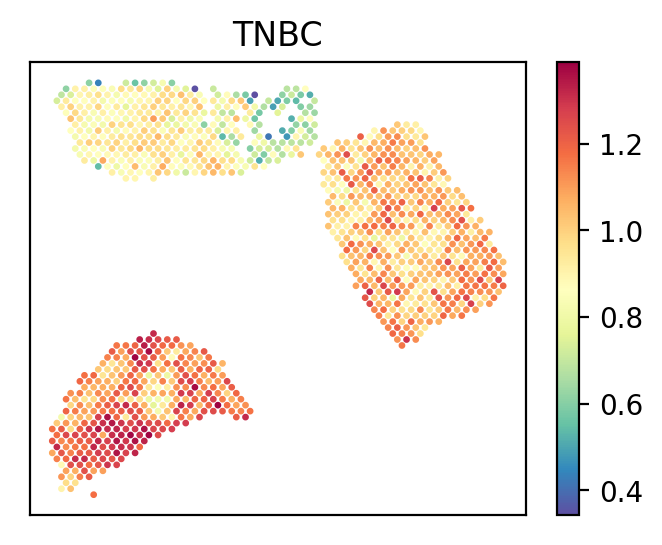

In [64]:
# TNBC
plot_genes = ['BUB3', 'LYST', 'DEDD', 'HLA-DRA', 'PAPOLA', 'SOX4', 'ACTR3B',
       'EIF3D', 'CACYBP', 'APOE', 'ATP1B1', 'SAA2', 'CENPW', 'HMGA1',
       'ATP6V0E2', 'MTCH2', 'ZG16B', 'S100A2', 'GSPT1', 'ARPC1B', 'NIT1',
       'NEAT1', 'DSC2', 'MAL2', 'TMEM176B', 'CYP1B1',
       'EIF3L', 'FKBP4', 'WFDC2', 'PCSK1N', 'GLTP', 'SPTLC1', 'S1PR1',
        'F11R', 'CCL20', 'CCL22', 'FDCSP', 'VIM', 'LDHB',
       'SAA1', 'RARRES1', 'HLA-B', 'APOE', 'CRYAB', 'HLA-DRA', 'IGFBP7',
       'S100A4', 'COL1A2', 'CALD1', 'CD74', 'SPARC', 'YBX1', 'HLA-A',
       'CRABP1', 'KRT17', 'HLA-DPB1', 'COL6A1', 'MFGE8', 'CYBA']
# load all expression data  [spot x gene]
for sample_id in sample_ids:
    
    print('working on ', sample_id)
    adata_df_concat = pd.read_csv("../results/02_PoE_factor/"+sample_id+'adata_df_concat.csv')
    adata_df_concat.index = adata_df_concat.iloc[:,0]
    adata_df_concat = adata_df_concat.drop(adata_df_concat.columns[0], axis=1)
    
    
    map_info = pd.read_csv("../results/02_PoE_factor/"+sample_id+'map_info.csv')
    all_loc = np.array(map_info.loc[map_info['sample']==sample_id,['array_col','array_row']])
    
    test = adata_df_concat.loc[:,plot_genes].mean(axis=1)
    
    fig,ax= plt.subplots(1,1,figsize=(4,3),dpi=200)
    for i in range(1):
        for j in range(1):
                plotted_cell_idx = 24
            
                g=ax.scatter(all_loc[:,0],-all_loc[:,1],s=2,
                             #c=adata_sample.to_df().loc[:,plot_gene],
                             c = test,
                             cmap='Spectral_r',
                             #vmin=0, vmax=120
                            )
                plt.colorbar(g, ax=ax)
                ax.set_title('TNBC')
                ax.set_xticks([])
                ax.set_yticks([]) 

working on  CID444971


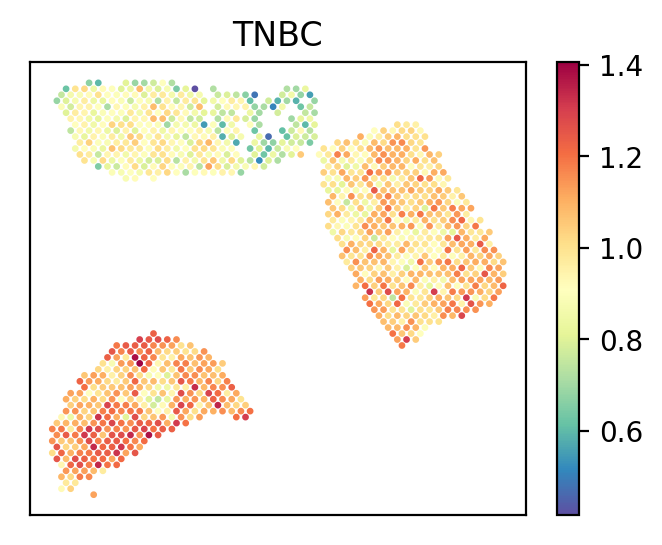

In [105]:
# TNBC
plot_genes = ['BUB3', 'LYST', 'DEDD', 'HLA-DRA', 'PAPOLA', 'SOX4', 'ACTR3B',
       'EIF3D', 'CACYBP', 'APOE', 'ATP1B1', 'SAA2', 'CENPW', 'HMGA1',
       'ATP6V0E2', 'MTCH2', 'ZG16B', 'S100A2', 'GSPT1', 'ARPC1B', 'NIT1',
       'NEAT1', 'DSC2', 'MAL2', 'TMEM176B', 'CYP1B1',
       'EIF3L', 'FKBP4', 'WFDC2', 'PCSK1N', 'GLTP', 'SPTLC1', 'S1PR1',
        'F11R', 'CCL20', 'CCL22', 'FDCSP', 'VIM', 'LDHB',
       'SAA1', 'RARRES1', 'HLA-B', 'APOE', 'CRYAB', 'HLA-DRA', 'IGFBP7',
       'S100A4', 'COL1A2', 'CALD1', 'CD74', 'SPARC', 'YBX1', 'HLA-A',
       'CRABP1', 'KRT17', 'HLA-DPB1', 'COL6A1', 'MFGE8', 'CYBA']


# load all expression data  [spot x gene]
for sample_id in sample_ids:
    
    print('working on ', sample_id)
    recon_exp_stack = np.load("../results/02_PoE_factor/"+sample_id+'recon_exp_stack.npy')
    
    recon_exp_stack_df = pd.DataFrame(recon_exp_stack,columns=adata_df_concat.columns,index= adata_df_concat.index) 
    
    
    map_info = pd.read_csv("../results/02_PoE_factor/"+sample_id+'map_info.csv')
    all_loc = np.array(map_info.loc[map_info['sample']==sample_id,['array_col','array_row']])
    
    test = recon_exp_stack_df.loc[:,plot_genes].mean(axis=1)
    
    fig,ax= plt.subplots(1,1,figsize=(4,3),dpi=200)
    for i in range(1):
        for j in range(1):
                plotted_cell_idx = 24
            
                g=ax.scatter(all_loc[:,0],-all_loc[:,1],s=2,
                             #c=adata_sample.to_df().loc[:,plot_gene],
                             c = test,
                             cmap='Spectral_r',
                             #vmin=0, vmax=120
                            )
                plt.colorbar(g, ax=ax)
                ax.set_title('TNBC')
                ax.set_xticks([])
                ax.set_yticks([]) 

working on  CID444971


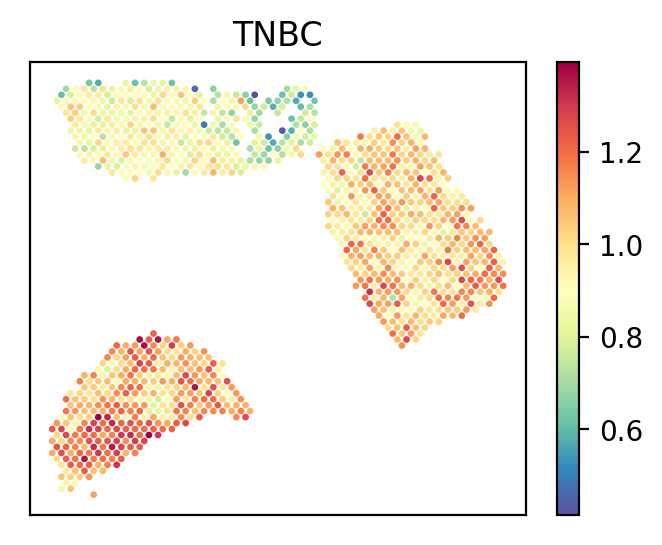

In [42]:
# TNBC
plot_genes = ['BUB3', 'LYST', 'DEDD', 'HLA-DRA', 'PAPOLA', 'SOX4', 'ACTR3B',
       'EIF3D', 'CACYBP', 'APOE', 'ATP1B1', 'SAA2', 'CENPW', 'HMGA1',
       'ATP6V0E2', 'MTCH2', 'ZG16B', 'S100A2', 'GSPT1', 'ARPC1B', 'NIT1',
       'NEAT1', 'DSC2', 'MAL2', 'TMEM176B', 'CYP1B1',
       'EIF3L', 'FKBP4', 'WFDC2', 'PCSK1N', 'GLTP', 'SPTLC1', 'S1PR1',
        'F11R', 'CCL20', 'CCL22', 'FDCSP', 'VIM', 'LDHB',
       'SAA1', 'RARRES1', 'HLA-B', 'APOE', 'CRYAB', 'HLA-DRA', 'IGFBP7',
       'S100A4', 'COL1A2', 'CALD1', 'CD74', 'SPARC', 'YBX1', 'HLA-A',
       'CRABP1', 'KRT17', 'HLA-DPB1', 'COL6A1', 'MFGE8', 'CYBA']


# load all expression data  [spot x gene]
for sample_id in sample_ids:
    
    print('working on ', sample_id)
    recon_exp_stack = np.load("../results/02_PoE_factor/"+sample_id+'recon_poe_rna_stack.npy')
    
    recon_exp_stack_df = pd.DataFrame(recon_exp_stack,columns=adata_df_concat.columns,index= adata_df_concat.index) 
    
    
    map_info = pd.read_csv("../results/02_PoE_factor/"+sample_id+'map_info.csv')
    all_loc = np.array(map_info.loc[map_info['sample']==sample_id,['array_col','array_row']])
    
    test = recon_exp_stack_df.loc[:,plot_genes].mean(axis=1)
    
    fig,ax= plt.subplots(1,1,figsize=(4,3),dpi=200)
    for i in range(1):
        for j in range(1):
                plotted_cell_idx = 24
            
                g=ax.scatter(all_loc[:,0],-all_loc[:,1],s=2,
                             #c=adata_sample.to_df().loc[:,plot_gene],
                             c = test,
                             cmap='Spectral_r',
                             #vmin=0, vmax=120
                            )
                plt.colorbar(g, ax=ax)
                ax.set_title('TNBC')
                ax.set_xticks([])
                ax.set_yticks([]) 

working on  CID444971


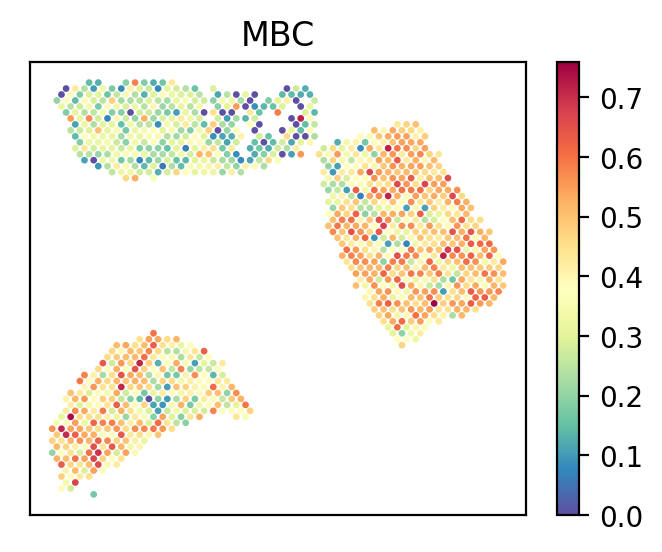

In [43]:
# MBC
plot_genes = [
"COL11A2",
"SDC1",
"FBN2",
"MMP1",
"FABP5",
"PTX3",
"HMGA1",
"RREB1",
"THBS1",
"ESPN",
"HAT1",
"APC",
"FOXP4",
"GPRC5A",
"SNRNP27",
"STMN1",
"ALDH1A1"
]



# load all expression data  [spot x gene]
for sample_id in sample_ids:
    
    print('working on ', sample_id)
    adata_df_concat = pd.read_csv("../results/02_PoE_factor/"+sample_id+'adata_df_concat.csv')
    adata_df_concat.index = adata_df_concat.iloc[:,0]
    adata_df_concat = adata_df_concat.drop(adata_df_concat.columns[0], axis=1)
    
    
    map_info = pd.read_csv("../results/02_PoE_factor/"+sample_id+'map_info.csv')
    all_loc = np.array(map_info.loc[map_info['sample']==sample_id,['array_col','array_row']])
    
    test = adata_df_concat.loc[:,plot_genes].mean(axis=1)
    
    fig,ax= plt.subplots(1,1,figsize=(4,3),dpi=200)
    for i in range(1):
        for j in range(1):
                plotted_cell_idx = 24
            
                g=ax.scatter(all_loc[:,0],-all_loc[:,1],s=2,
                             #c=adata_sample.to_df().loc[:,plot_gene],
                             c = test,
                             cmap='Spectral_r',
                             #vmin=0, vmax=120
                            )
                plt.colorbar(g, ax=ax)
                ax.set_title('MBC')
                ax.set_xticks([])
                ax.set_yticks([]) 

working on  CID444971


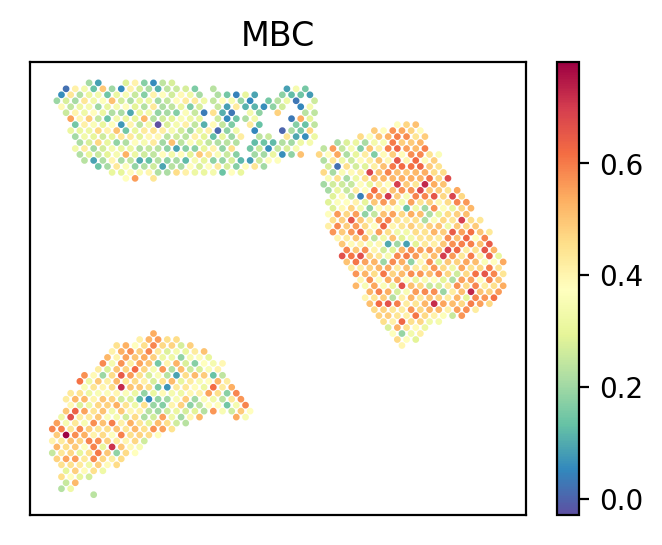

In [44]:
# 
plot_genes = [
"COL11A2",
"SDC1",
"FBN2",
"MMP1",
"FABP5",
"PTX3",
"HMGA1",
"RREB1",
"THBS1",
"ESPN",
"HAT1",
"APC",
"FOXP4",
"GPRC5A",
"SNRNP27",
"STMN1",
"ALDH1A1"
]



# load all expression data  [spot x gene]
for sample_id in sample_ids:
    
    print('working on ', sample_id)
    recon_exp_stack = np.load("../results/02_PoE_factor/"+sample_id+'recon_exp_stack.npy')
    
    recon_exp_stack_df = pd.DataFrame(recon_exp_stack,columns=adata_df_concat.columns,index= adata_df_concat.index) 
    
    
    map_info = pd.read_csv("../results/02_PoE_factor/"+sample_id+'map_info.csv')
    all_loc = np.array(map_info.loc[map_info['sample']==sample_id,['array_col','array_row']])
    
    test = recon_exp_stack_df.loc[:,plot_genes].mean(axis=1)
    
    fig,ax= plt.subplots(1,1,figsize=(4,3),dpi=200)
    for i in range(1):
        for j in range(1):
                plotted_cell_idx = 24
            
                g=ax.scatter(all_loc[:,0],-all_loc[:,1],s=2,
                             #c=adata_sample.to_df().loc[:,plot_gene],
                             c = test,
                             cmap='Spectral_r',
                             #vmin=0, vmax=120
                            )
                plt.colorbar(g, ax=ax)
                ax.set_title('MBC')
                ax.set_xticks([])
                ax.set_yticks([]) 

working on  CID444971


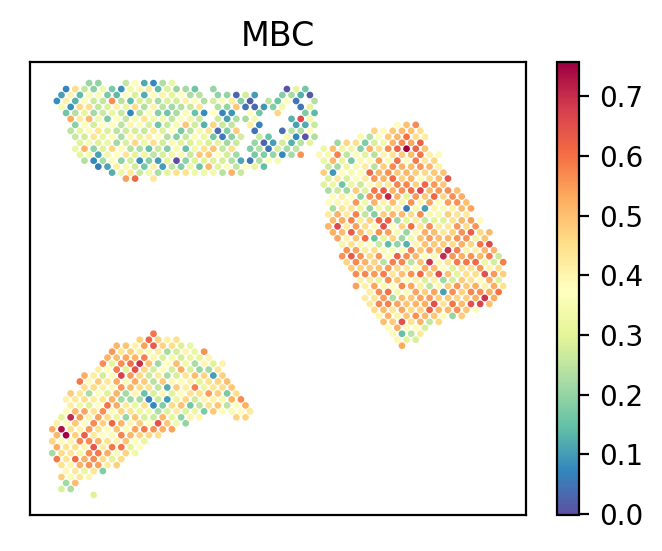

In [103]:

plot_genes = [
"COL11A2",
"SDC1",
"FBN2",
"MMP1",
"FABP5",
"PTX3",
"HMGA1",
"RREB1",
"THBS1",
"ESPN",
"HAT1",
"APC",
"FOXP4",
"GPRC5A",
"SNRNP27",
"STMN1",
"ALDH1A1"
]



# load all expression data  [spot x gene]
for sample_id in sample_ids:
    
    print('working on ', sample_id)
    recon_exp_stack = np.load("../results/02_PoE_factor/"+sample_id+'recon_poe_rna_stack.npy')
    
    recon_exp_stack_df = pd.DataFrame(recon_exp_stack,columns=adata_df_concat.columns,index= adata_df_concat.index) 
    
    
    map_info = pd.read_csv("../results/02_PoE_factor/"+sample_id+'map_info.csv')
    all_loc = np.array(map_info.loc[map_info['sample']==sample_id,['array_col','array_row']])
    
    test = recon_exp_stack_df.loc[:,plot_genes].mean(axis=1)
    
    fig,ax= plt.subplots(1,1,figsize=(4,3),dpi=200)
    for i in range(1):
        for j in range(1):
                plotted_cell_idx = 24
            
                g=ax.scatter(all_loc[:,0],-all_loc[:,1],s=2,
                             #c=adata_sample.to_df().loc[:,plot_gene],
                             c = test,
                             cmap='Spectral_r',
                             #vmin=0, vmax=120
                            )
                plt.colorbar(g, ax=ax)
                ax.set_title('MBC')
                ax.set_xticks([])
                ax.set_yticks([]) 

working on  CID444971


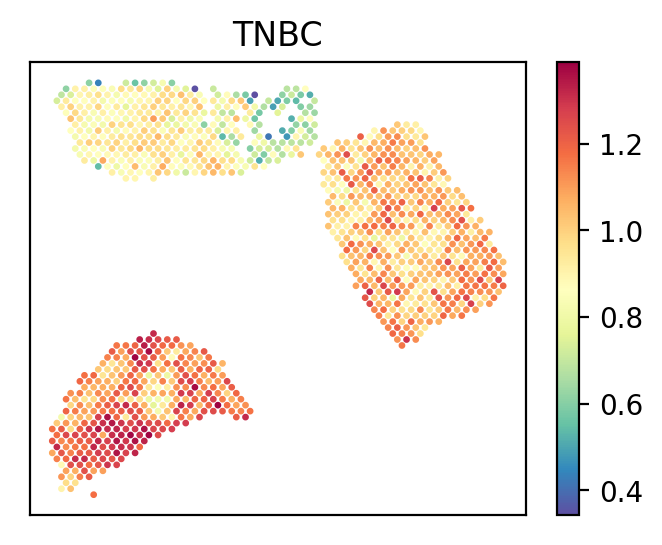

In [104]:
# TNBC
plot_genes = ['BUB3', 'LYST', 'DEDD', 'HLA-DRA', 'PAPOLA', 'SOX4', 'ACTR3B',
       'EIF3D', 'CACYBP', 'APOE', 'ATP1B1', 'SAA2', 'CENPW', 'HMGA1',
       'ATP6V0E2', 'MTCH2', 'ZG16B', 'S100A2', 'GSPT1', 'ARPC1B', 'NIT1',
       'NEAT1', 'DSC2', 'MAL2', 'TMEM176B', 'CYP1B1',
       'EIF3L', 'FKBP4', 'WFDC2', 'PCSK1N', 'GLTP', 'SPTLC1', 'S1PR1',
        'F11R', 'CCL20', 'CCL22', 'FDCSP', 'VIM', 'LDHB',
       'SAA1', 'RARRES1', 'HLA-B', 'APOE', 'CRYAB', 'HLA-DRA', 'IGFBP7',
       'S100A4', 'COL1A2', 'CALD1', 'CD74', 'SPARC', 'YBX1', 'HLA-A',
       'CRABP1', 'KRT17', 'HLA-DPB1', 'COL6A1', 'MFGE8', 'CYBA']


# load all expression data  [spot x gene]
for sample_id in sample_ids:
    
    print('working on ', sample_id)
    adata_df_concat = pd.read_csv("../results/02_PoE_factor/"+sample_id+'adata_df_concat.csv')
    adata_df_concat.index = adata_df_concat.iloc[:,0]
    adata_df_concat = adata_df_concat.drop(adata_df_concat.columns[0], axis=1)
    
    
    map_info = pd.read_csv("../results/02_PoE_factor/"+sample_id+'map_info.csv')
    all_loc = np.array(map_info.loc[map_info['sample']==sample_id,['array_col','array_row']])
    
    test = adata_df_concat.loc[:,plot_genes].mean(axis=1)
    
    fig,ax= plt.subplots(1,1,figsize=(4,3),dpi=200)
    for i in range(1):
        for j in range(1):
                plotted_cell_idx = 24
            
                g=ax.scatter(all_loc[:,0],-all_loc[:,1],s=2,
                             #c=adata_sample.to_df().loc[:,plot_gene],
                             c = test,
                             cmap='Spectral_r',
                             #vmin=0, vmax=120
                            )
                plt.colorbar(g, ax=ax)
                ax.set_title('TNBC')
                ax.set_xticks([])
                ax.set_yticks([]) 

working on  CID444971


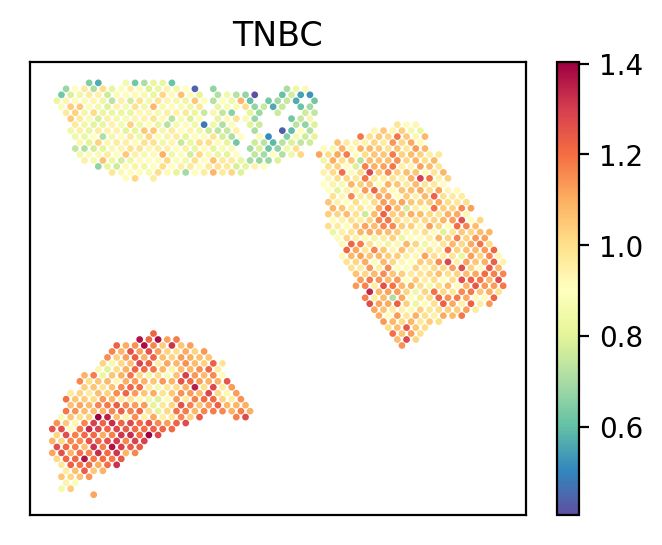

In [47]:
# TNBC
plot_genes = ['BUB3', 'LYST', 'DEDD', 'HLA-DRA', 'PAPOLA', 'SOX4', 'ACTR3B',
       'EIF3D', 'CACYBP', 'APOE', 'ATP1B1', 'SAA2', 'CENPW', 'HMGA1',
       'ATP6V0E2', 'MTCH2', 'ZG16B', 'S100A2', 'GSPT1', 'ARPC1B', 'NIT1',
       'NEAT1', 'DSC2', 'MAL2', 'TMEM176B', 'CYP1B1',
       'EIF3L', 'FKBP4', 'WFDC2', 'PCSK1N', 'GLTP', 'SPTLC1', 'S1PR1',
        'F11R', 'CCL20', 'CCL22', 'FDCSP', 'VIM', 'LDHB',
       'SAA1', 'RARRES1', 'HLA-B', 'APOE', 'CRYAB', 'HLA-DRA', 'IGFBP7',
       'S100A4', 'COL1A2', 'CALD1', 'CD74', 'SPARC', 'YBX1', 'HLA-A',
       'CRABP1', 'KRT17', 'HLA-DPB1', 'COL6A1', 'MFGE8', 'CYBA']


# load all expression data  [spot x gene]
for sample_id in sample_ids:
    
    print('working on ', sample_id)
    recon_exp_stack = np.load("../results/02_PoE_factor/"+sample_id+'recon_exp_stack.npy')
    
    recon_exp_stack_df = pd.DataFrame(recon_exp_stack,columns=adata_df_concat.columns,index= adata_df_concat.index) 
    
    
    map_info = pd.read_csv("../results/02_PoE_factor/"+sample_id+'map_info.csv')
    all_loc = np.array(map_info.loc[map_info['sample']==sample_id,['array_col','array_row']])
    
    test = recon_exp_stack_df.loc[:,plot_genes].mean(axis=1)
    
    fig,ax= plt.subplots(1,1,figsize=(4,3),dpi=200)
    for i in range(1):
        for j in range(1):
                plotted_cell_idx = 24
            
                g=ax.scatter(all_loc[:,0],-all_loc[:,1],s=2,
                             #c=adata_sample.to_df().loc[:,plot_gene],
                             c = test,
                             cmap='Spectral_r',
                             #vmin=0, vmax=120
                            )
                plt.colorbar(g, ax=ax)
                ax.set_title('TNBC')
                ax.set_xticks([])
                ax.set_yticks([]) 

working on  CID444971


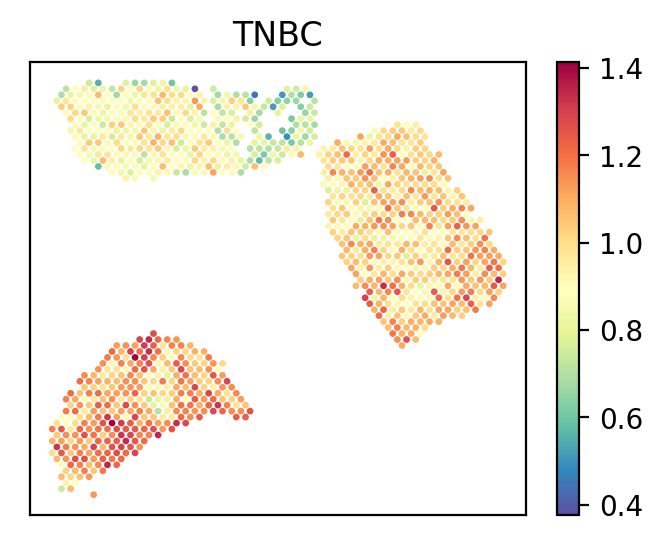

In [201]:
# TNBC
plot_genes = ['BUB3', 'LYST', 'DEDD', 'HLA-DRA', 'PAPOLA', 'SOX4', 'ACTR3B',
       'EIF3D', 'CACYBP', 'APOE', 'ATP1B1', 'SAA2', 'CENPW', 'HMGA1',
       'ATP6V0E2', 'MTCH2', 'ZG16B', 'S100A2', 'GSPT1', 'ARPC1B', 'NIT1',
       'NEAT1', 'DSC2', 'MAL2', 'TMEM176B', 'CYP1B1',
       'EIF3L', 'FKBP4', 'WFDC2', 'PCSK1N', 'GLTP', 'SPTLC1', 'S1PR1',
        'F11R', 'CCL20', 'CCL22', 'FDCSP', 'VIM', 'LDHB',
       'SAA1', 'RARRES1', 'HLA-B', 'APOE', 'CRYAB', 'HLA-DRA', 'IGFBP7',
       'S100A4', 'COL1A2', 'CALD1', 'CD74', 'SPARC', 'YBX1', 'HLA-A',
       'CRABP1', 'KRT17', 'HLA-DPB1', 'COL6A1', 'MFGE8', 'CYBA']


# load all expression data  [spot x gene]
for sample_id in sample_ids:
    
    print('working on ', sample_id)
    recon_exp_stack = np.load("../results/02_PoE_factor/"+sample_id+'recon_poe_rna_stack.npy')
    
    recon_exp_stack_df = pd.DataFrame(recon_exp_stack,columns=adata_df_concat.columns,index= adata_df_concat.index) 
    
    
    map_info = pd.read_csv("../results/02_PoE_factor/"+sample_id+'map_info.csv')
    all_loc = np.array(map_info.loc[map_info['sample']==sample_id,['array_col','array_row']])
    
    test = recon_exp_stack_df.loc[:,plot_genes].mean(axis=1)
    
    fig,ax= plt.subplots(1,1,figsize=(4,3),dpi=200)
    for i in range(1):
        for j in range(1):
                plotted_cell_idx = 24
            
                g=ax.scatter(all_loc[:,0],-all_loc[:,1],s=2,
                             #c=adata_sample.to_df().loc[:,plot_gene],
                             c = test,
                             cmap='Spectral_r',
                             #vmin=0, vmax=120
                            )
                plt.colorbar(g, ax=ax)
                ax.set_title('TNBC')
                ax.set_xticks([])
                ax.set_yticks([]) 

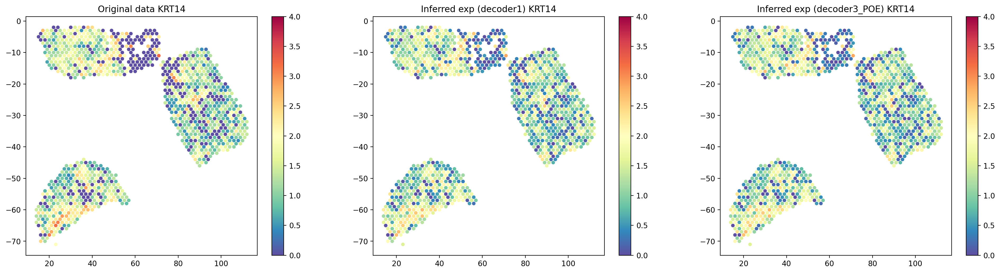

In [48]:
for sample_id in sample_ids:
    
    plotted_gene='KRT14'

    c_max = 4
    c_min = 0

    fig,axs=plt.subplots(1,3,figsize=(24,6),dpi=200)

    ax=axs[0]
    
    adata_df_concat = pd.read_csv("../results/02_PoE_factor/"+sample_id+'adata_df_concat.csv')
    adata_df_concat.index = adata_df_concat.iloc[:,0]
    adata_df_concat = adata_df_concat.drop(adata_df_concat.columns[0], axis=1)
    
    
    
    map_info = pd.read_csv("../results/02_PoE_factor/"+sample_id+'map_info.csv')
    recon_exp_stack = np.load("../results/02_PoE_factor/"+sample_id+'recon_exp_stack.npy')
    recon_poe_rna_stack = np.load("../results/02_PoE_factor/"+sample_id+'recon_poe_rna_stack.npy')

    
    
    all_spot = np.array(adata_df_concat[ [spot_id.split('-')[-1]==sample_id for spot_id in adata_df_concat.index ]])
    all_loc = np.array(map_info.loc[map_info['sample']==sample_id,['array_col','array_row']])

    g=ax.scatter(all_loc[:,0],-all_loc[:,1],s=15,c=all_spot[:,np.where(adata_df_concat.columns==plotted_gene)[0][0]],cmap='Spectral_r',vmax=c_max,vmin=c_min)
    plt.colorbar(g, ax=ax)
    ax.set_title('Original data '+plotted_gene)


    ax=axs[1]
    all_spot = recon_exp_stack[ [spot_id.split('-')[-1]==sample_id for spot_id in adata_df_concat.index ]]
    all_loc = np.array(map_info.loc[map_info['sample']==sample_id,['array_col','array_row']])
    g=ax.scatter(all_loc[:,0],-all_loc[:,1],s=15,c=all_spot[:,np.where(adata_df_concat.columns==plotted_gene)[0][0]],cmap='Spectral_r',vmax=c_max,vmin=c_min)
    plt.colorbar(g, ax=ax)
    ax.set_title('Inferred exp (decoder1) '+plotted_gene)

    ax=axs[2]
    all_spot = recon_poe_rna_stack[ [spot_id.split('-')[-1]==sample_id for spot_id in adata_df_concat.index ]]
    all_loc = np.array(map_info.loc[map_info['sample']==sample_id,['array_col','array_row']])
    g=ax.scatter(all_loc[:,0],-all_loc[:,1],s=15,c=all_spot[:,np.where(adata_df_concat.columns==plotted_gene)[0][0]],cmap='Spectral_r',vmax=c_max,vmin=c_min)
    plt.colorbar(g, ax=ax)
    ax.set_title('Inferred exp (decoder3_POE) '+plotted_gene)
    
    
    wholeimg_stitch  = np.load("../results/02_PoE_factor/"+sample_id+'wholeimg_stitch.npy')
    recon_wholeimg_stitch = np.load("../results/02_PoE_factor/"+sample_id+'recon_wholeimg_stitch.npy')
    recon_poe_wholeimg_stitch = np.load("../results/02_PoE_factor/"+sample_id+'recon_poe_wholeimg_stitch.npy')

## plot factor map

In [49]:
factor_all = pd.DataFrame()
#map_info = pd.read_csv("../results/02_PoE_factor/"+sample_id+'map_info.csv')
for sample_id in sample_ids:
    factor = pd.read_csv("../results/02_PoE_factor/"+sample_id+'nb_file.csv',index_col=0)
    factor.index = factor.index+'-'+sample_id
    
    #factor = (factor.apply(zscore))

    #factor = np.clip(factor, 0, 1)
                
    #factor = (factor-factor.min())/(factor.max()-factor.min())
    factor_all = factor_all.append(factor)

In [159]:
sample_ids = [
            'MBC_1A',
            'MBC_2A',
             'CID444971',
        
            ]

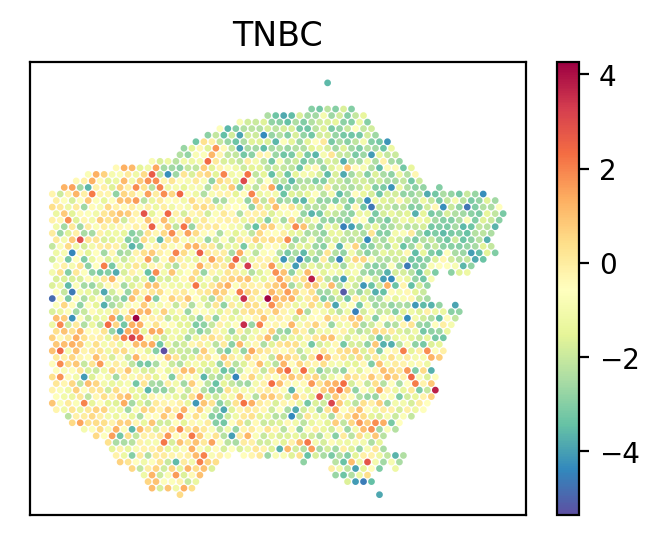

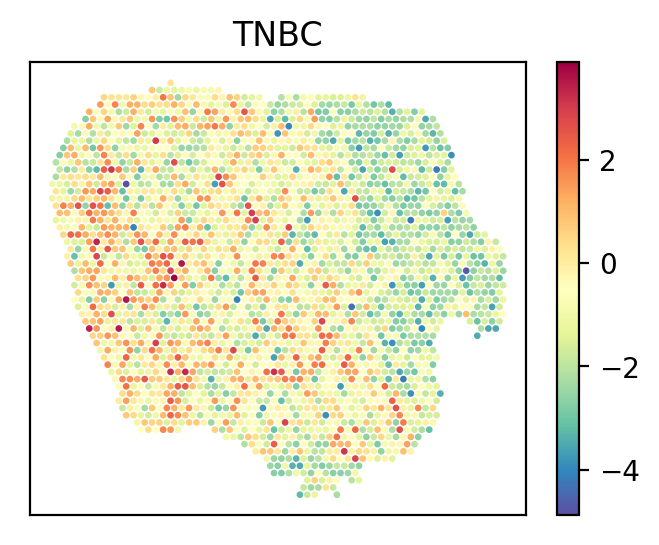

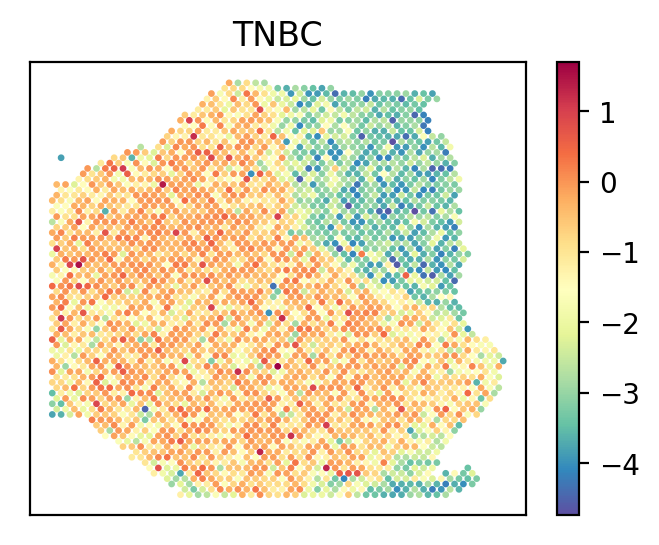

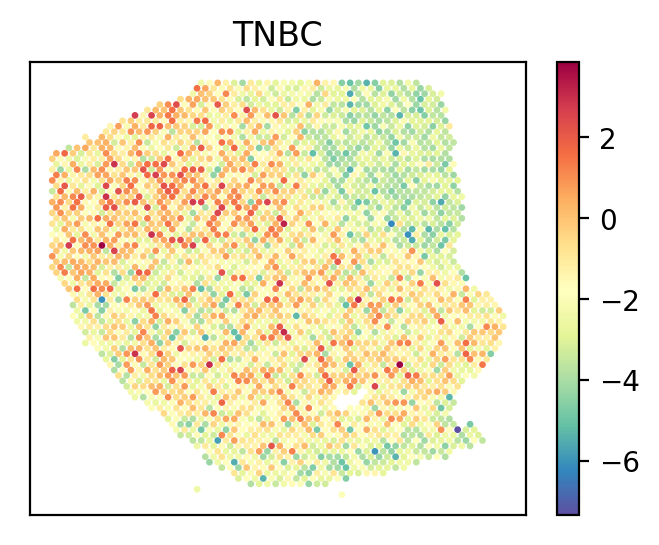

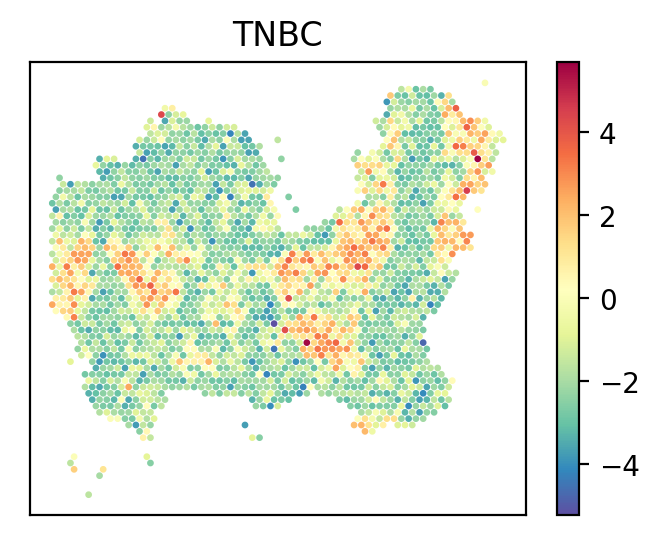

...

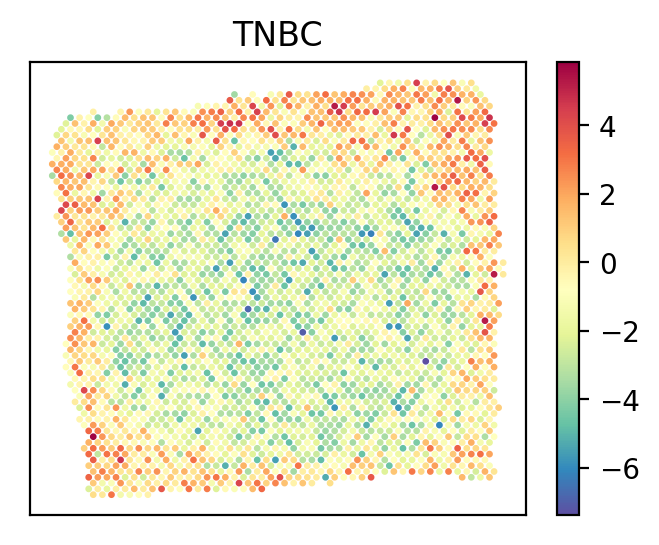

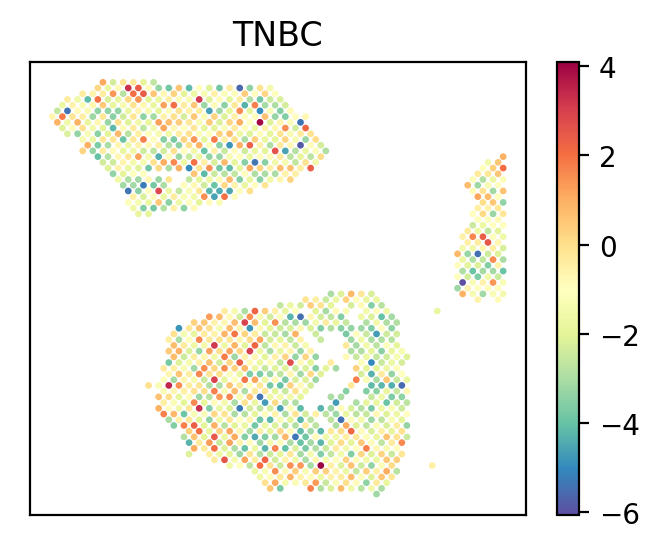

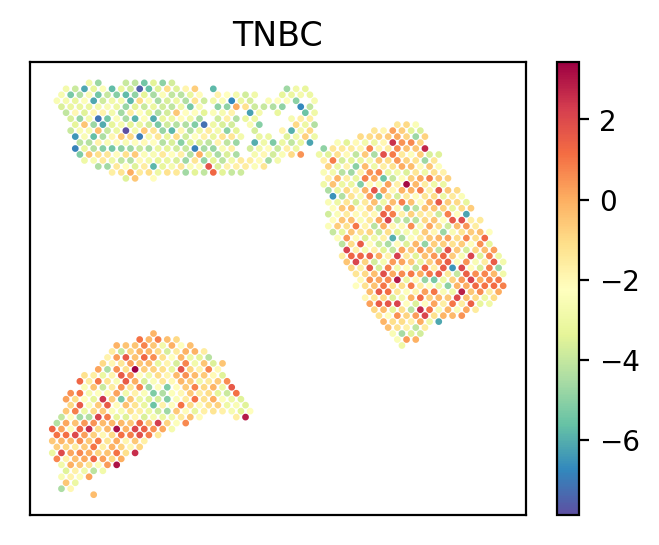

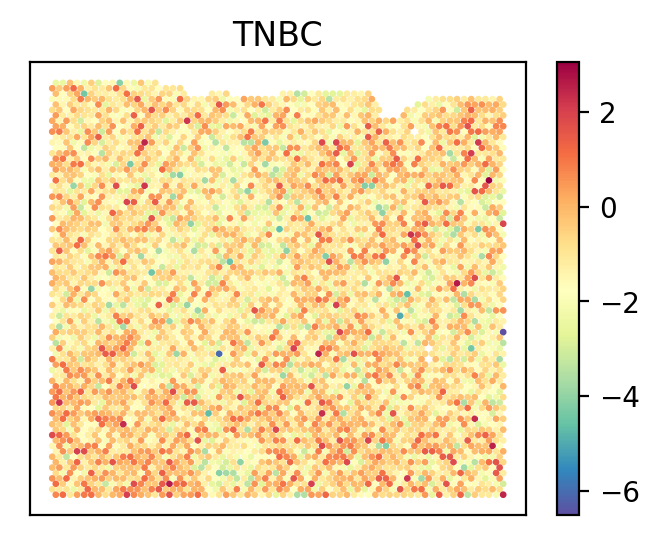

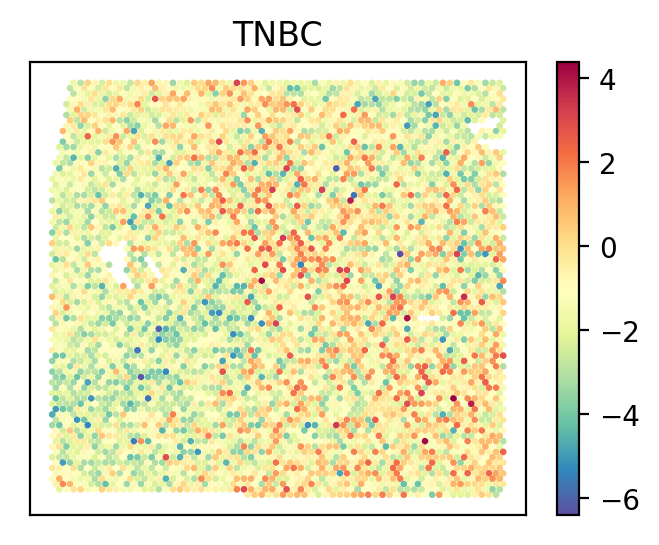

In [260]:
from scipy.stats import zscore

for sample_id in sample_ids:
    
    
    map_info = pd.read_csv("../results/02_PoE_factor/"+sample_id+'map_info.csv')
    
    mu_poe_stack_df = pd.read_csv("../results/02_PoE_factor/"+sample_id+'nb_file.csv')
    mu_poe_stack_df.index = mu_poe_stack_df.iloc[:,0]
    mu_poe_stack_df = mu_poe_stack_df.drop(mu_poe_stack_df.columns[0], axis=1)
    
    #mu_poe_stack_df = mu_poe_stack_df.T.apply(zscore).T    
    #c_max = 1#0.5
    #c_min = 0#-1.5
    
    c_max = 2
    c_min = -2

    image_slide_z = 1

    #all_spot = mu_poe_stack_df[[spot_id.split('-')[-1]==sample_ids[image_slide_z]for spot_id in mu_poe_stack_df.index ]]
    all_spot = mu_poe_stack_df
    
    all_loc = np.array(map_info.loc[map_info['sample']==sample_id,['array_col','array_row']])

    fig,ax= plt.subplots(1,1,figsize=(4,3),dpi=200)
    for i in range(1):
        for j in range(1):
            plotted_cell_idx = 11
            if plotted_cell_idx<mu_poe_stack_df.shape[1]:
                plotted_cell= mu_poe_stack_df.columns[plotted_cell_idx]
                #ax=axs[i,j]
                
                #ddd = ddd/ddd.max()
                ddd = pd.DataFrame(all_spot.loc[:,plotted_cell])
                ddd = np.array(ddd)
                #ddd = np.array(ddd.T.apply(zscore).T)
                #ddd = (ddd-ddd.min())/(ddd.max()-ddd.min())
                #ddd = np.clip(ddd, -1, 2)
                g=ax.scatter(all_loc[:,0],-all_loc[:,1],s=2,c=ddd,cmap='Spectral_r',
                             #vmin=c_min, vmax=c_max
                            )
                plt.colorbar(g, ax=ax)
                ax.set_title(plotted_cell)
                ax.set_xticks([])
                ax.set_yticks([]) 

In [205]:
mu_poe_stack_df

,Th17,B cell,NK cell,Macrophages,Macrophage M2,vCAFs,Endothelial,mCAFs,dCAFS,MDSC,...,cDC,pDC,Terminal exhaustion,Precursor exhaustion,CAFs MSC iCAF like,CAFs myCAF like,PVL differentiated,PVL immature,Normal epithelial,Plasmablasts
Unnamed: 0,,,,,,,,,,,,,,,,,,,,,
AACATTGGTCAGCCGT-1,-9.967389,-9.306937,1.859860,-5.843790,-5.544020,-12.668620,-9.588120,-7.259723,-4.305127,-3.989100,...,-3.485444,-3.807868,-9.646187,-7.188655,-5.260918,-9.460867,-2.932512,-5.519389,-2.593358,-7.192830
CATCGAATGGATCTCT-1,-4.542299,1.690121,7.065926,-9.998496,-9.819300,-2.662964,-11.014133,-6.180177,-7.503538,-9.110940,...,2.746165,3.774088,-4.757757,-8.093653,-6.654185,-9.196323,4.749777,-7.062508,6.120204,-6.607286
CGGGTTGTAGCTTTGG-1,-9.875667,-9.254047,-3.873653,-6.011006,-3.837458,-5.114031,-6.660137,-5.600459,-2.655018,-3.200707,...,-5.299200,-6.903133,3.396563,-5.141049,-3.261125,-7.088461,5.085463,-6.566897,8.183675,-5.632497
CCTAAGTGTCTAACCG-1,-7.770011,-2.998627,7.316836,-12.895922,-9.195480,-4.465714,-13.481079,-7.106873,-6.015481,-5.639666,...,-4.212485,-12.720740,-10.925324,-9.663819,-7.128293,-8.230995,-5.057405,-8.140006,-3.836520,-5.246674
TCTGTGACTGACCGTT-1,-6.998082,-7.779908,-2.937056,-7.712478,-11.848054,-8.166778,-8.685971,-7.744031,-3.772441,-7.831473,...,-1.945198,-1.345619,-6.602136,-6.520299,-6.802780,-10.752651,7.720490,-8.866400,6.641724,-4.869249
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TGCAGTGGTAGGGAAC-1,-3.553105,-4.524742,-2.627749,-5.096388,2.705791,-6.733342,-5.547211,5.016629,-7.521911,-6.739526,...,-4.349086,-2.915377,-4.439376,-7.176787,5.810413,6.197152,-1.782332,4.930850,5.096045,-5.116071
AGCGAGACGTGAAGGC-1,-1.241499,2.648234,-6.845607,-4.871039,-2.090108,-4.679497,-1.139465,-3.781852,1.892397,-6.881118,...,-6.778721,-3.564592,-4.903049,7.225924,2.001534,4.838031,-1.874544,3.813812,4.724020,-4.087390
CAGTGTTAATCTCTCA-1,-7.052131,3.084976,8.916049,-5.461633,-4.835569,3.378019,-4.039491,2.025428,-3.245376,-5.760331,...,-4.287018,4.070991,-4.718315,-7.219242,-4.597308,-4.654888,-1.968000,4.435917,-1.995491,-3.642203


In [206]:
mu_poe_stack_df

,Th17,B cell,NK cell,Macrophages,Macrophage M2,vCAFs,Endothelial,mCAFs,dCAFS,MDSC,...,cDC,pDC,Terminal exhaustion,Precursor exhaustion,CAFs MSC iCAF like,CAFs myCAF like,PVL differentiated,PVL immature,Normal epithelial,Plasmablasts
Unnamed: 0,,,,,,,,,,,,,,,,,,,,,
AACATTGGTCAGCCGT-1,-9.967389,-9.306937,1.859860,-5.843790,-5.544020,-12.668620,-9.588120,-7.259723,-4.305127,-3.989100,...,-3.485444,-3.807868,-9.646187,-7.188655,-5.260918,-9.460867,-2.932512,-5.519389,-2.593358,-7.192830
CATCGAATGGATCTCT-1,-4.542299,1.690121,7.065926,-9.998496,-9.819300,-2.662964,-11.014133,-6.180177,-7.503538,-9.110940,...,2.746165,3.774088,-4.757757,-8.093653,-6.654185,-9.196323,4.749777,-7.062508,6.120204,-6.607286
CGGGTTGTAGCTTTGG-1,-9.875667,-9.254047,-3.873653,-6.011006,-3.837458,-5.114031,-6.660137,-5.600459,-2.655018,-3.200707,...,-5.299200,-6.903133,3.396563,-5.141049,-3.261125,-7.088461,5.085463,-6.566897,8.183675,-5.632497
CCTAAGTGTCTAACCG-1,-7.770011,-2.998627,7.316836,-12.895922,-9.195480,-4.465714,-13.481079,-7.106873,-6.015481,-5.639666,...,-4.212485,-12.720740,-10.925324,-9.663819,-7.128293,-8.230995,-5.057405,-8.140006,-3.836520,-5.246674
TCTGTGACTGACCGTT-1,-6.998082,-7.779908,-2.937056,-7.712478,-11.848054,-8.166778,-8.685971,-7.744031,-3.772441,-7.831473,...,-1.945198,-1.345619,-6.602136,-6.520299,-6.802780,-10.752651,7.720490,-8.866400,6.641724,-4.869249
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TGCAGTGGTAGGGAAC-1,-3.553105,-4.524742,-2.627749,-5.096388,2.705791,-6.733342,-5.547211,5.016629,-7.521911,-6.739526,...,-4.349086,-2.915377,-4.439376,-7.176787,5.810413,6.197152,-1.782332,4.930850,5.096045,-5.116071
AGCGAGACGTGAAGGC-1,-1.241499,2.648234,-6.845607,-4.871039,-2.090108,-4.679497,-1.139465,-3.781852,1.892397,-6.881118,...,-6.778721,-3.564592,-4.903049,7.225924,2.001534,4.838031,-1.874544,3.813812,4.724020,-4.087390
CAGTGTTAATCTCTCA-1,-7.052131,3.084976,8.916049,-5.461633,-4.835569,3.378019,-4.039491,2.025428,-3.245376,-5.760331,...,-4.287018,4.070991,-4.718315,-7.219242,-4.597308,-4.654888,-1.968000,4.435917,-1.995491,-3.642203


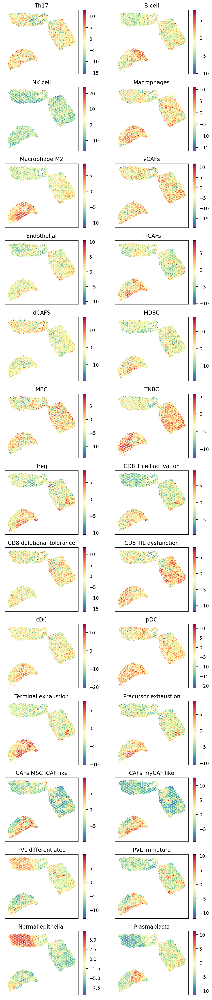

In [12]:

sample_ids = ['CID444971']
for sample_id in sample_ids:
    
    
    map_info = pd.read_csv("../results/02_PoE_factor/"+sample_id+'map_info.csv')
    
    mu_poe_stack_df = pd.read_csv("../results/02_PoE_factor_0105/"+sample_id+'nb_file2.csv')
    mu_poe_stack_df.index = mu_poe_stack_df.iloc[:,0]
    mu_poe_stack_df = mu_poe_stack_df.drop(mu_poe_stack_df.columns[0], axis=1)
    
    
    #mu_poe_stack_df = (mu_poe_stack_df.apply(zscore))
    
    #mu_poe_stack_df = (mu_poe_stack_df - mu_poe_stack_df.min())/(mu_poe_stack_df.max() - mu_poe_stack_df.min())
    
    #mu_poe_stack_df = (mu_poe_stack_df/ mu_poe_stack_df.sum())
    
    #mu_poe_stack_df = (mu_poe_stack_df.T.apply(zscore)).T
    
    #mu_poe_stack_df = (mu_poe_stack_df - mu_poe_stack_df.min())/(mu_poe_stack_df.max() - mu_poe_stack_df.min())-0.5
    
    #mu_poe_stack_df = mu_poe_stack_df.T
    
    
    
    c_max = 1
    c_min = -2

    image_slide_z = 0

    #all_spot = mu_poe_stack_df[[spot_id.split('-')[-1]==sample_ids[image_slide_z]for spot_id in mu_poe_stack_df.index ]]
    all_spot = mu_poe_stack_df
    
    all_loc = np.array(map_info.loc[map_info['sample']==sample_id,['array_col','array_row']])

    fig,axs= plt.subplots(13,2,figsize=(8,40),dpi=200)
    for i in range(13):
        for j in range(2):
            plotted_cell_idx = i*2+j
            if plotted_cell_idx<mu_poe_stack_df.shape[1]:
                plotted_cell= mu_poe_stack_df.columns[plotted_cell_idx]
                ax=axs[i,j]
                #ddd = ddd/ddd.max()
                ddd = pd.DataFrame(all_spot.loc[:,plotted_cell])
                ddd = np.array(ddd)
                #ddd = np.array(ddd.apply(zscore))
                #ddd = (ddd-ddd.min())/(ddd.max()-ddd.min())
                #ddd = np.clip(ddd, -1, 2)
                g=ax.scatter(all_loc[:,0],-all_loc[:,1],s=2,c=ddd,cmap='Spectral_r',
                             #vmin=c_min, vmax=c_max
                            )
                plt.colorbar(g, ax=ax)
                ax.set_title(plotted_cell)
                ax.set_xticks([])
                ax.set_yticks([]) 

## Plot factor clustermap

In [23]:
factor_all = pd.DataFrame()
sample_ids = [
             'MBC_1A',
             'MBC_1B',
             #'MBC_2A',
             #'MBC_2B',
             #'MBC_3A',
             #'MBC_3B',
             #'MBC_4A',
             #'MBC_4B',
             #'CID4465',
             'CID444971',
             #'1142243F',
             #'1160920F'
            ]
#map_info = pd.read_csv("../results/02_PoE_factor/"+sample_id+'map_info.csv')
for sample_id in sample_ids:
    factor = pd.read_csv("../results/02_PoE_factor/"+sample_id+'nb_file.csv',index_col=0)
    factor.index = factor.index+'-'+sample_id
    #factor = (factor-factor.min())/(factor.max()-factor.min())
    factor_all = factor_all.append(factor)

In [24]:
factor_all.max()

Th17                        1.259439
B cell                      1.084051
NK cell                     8.750827
Macrophages                 2.412647
Macrophage M2               1.361437
vCAFs                       1.205845
Endothelial                 1.898806
mCAFs                       0.953920
dCAFS                       0.894849
MDSC                        1.351540
MBC                         2.747254
TNBC                        1.493059
Treg                        1.255265
CD8 T cell activation       1.364808
CD8 deletional tolerance    0.892629
CD8 TIL dysfunction         3.114429
cDC                         1.280422
pDC                         1.418042
Terminal exhaustion         1.006979
Precursor exhaustion        1.357994
CAFs MSC iCAF like          1.011512
CAFs myCAF like             0.691507
PVL differentiated          1.529864
PVL immature                1.906427
Normal epithelial           1.457058
Plasmablasts                1.438833
dtype: float64

In [25]:
sample_df = [t.split('-')[2] for t in factor_all.index]
sample_df = pd.DataFrame(sample_df,index  =factor_all.index ,columns=['sample'])

zip_color = dict(zip(sample_df['sample'].unique(), [
                                    'blue',
                                    'orange',
                                    'greenyellow',
                                    'red',
                                    'brown',
                                    'pink',
                                    'darkolivegreen',
                                    'cyan',
                                    'coral',
                                    'green',
                                    'black',
                                    'yellow'
]))
row_colors = sample_df['sample'].map(zip_color)

In [26]:
from scipy.stats import zscore

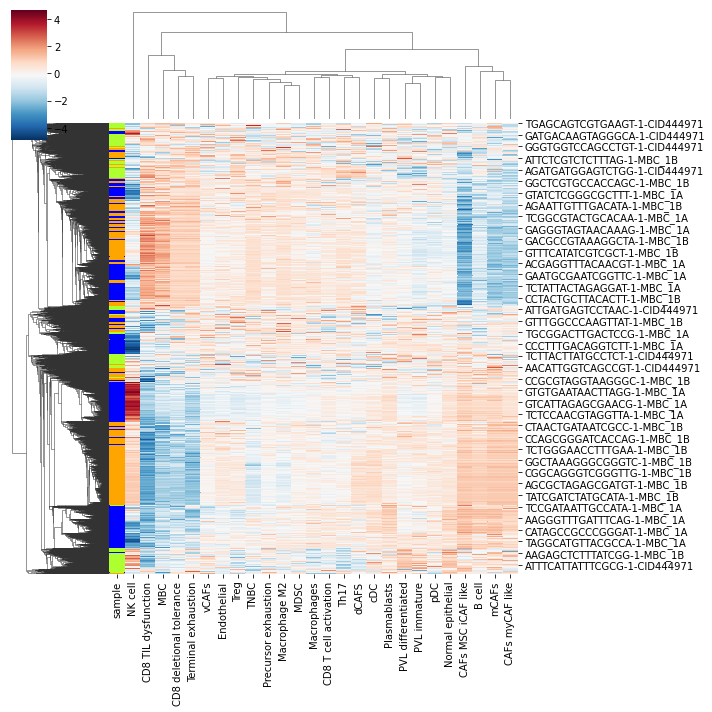

In [28]:
sns.clustermap(factor_all.T.apply(zscore).T,cmap='RdBu_r',row_colors=row_colors)
#sns.clustermap(factor_all,cmap='RdBu_r',row_colors=row_colors)

## plot hub map

In [52]:
import matplotlib as mpl
mpl.rcParams['axes.prop_cycle'] = mpl.cycler(color=['blue',
                                                    'orange',
                                                    'greenyellow',
                                                    'red',
                                                    'brown',
                                                    'pink',
                                                    'darkolivegreen',
                                                    'cyan',
                                                    'coral',
                                                    'slateblue',
                                                    'black']) 

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Vari

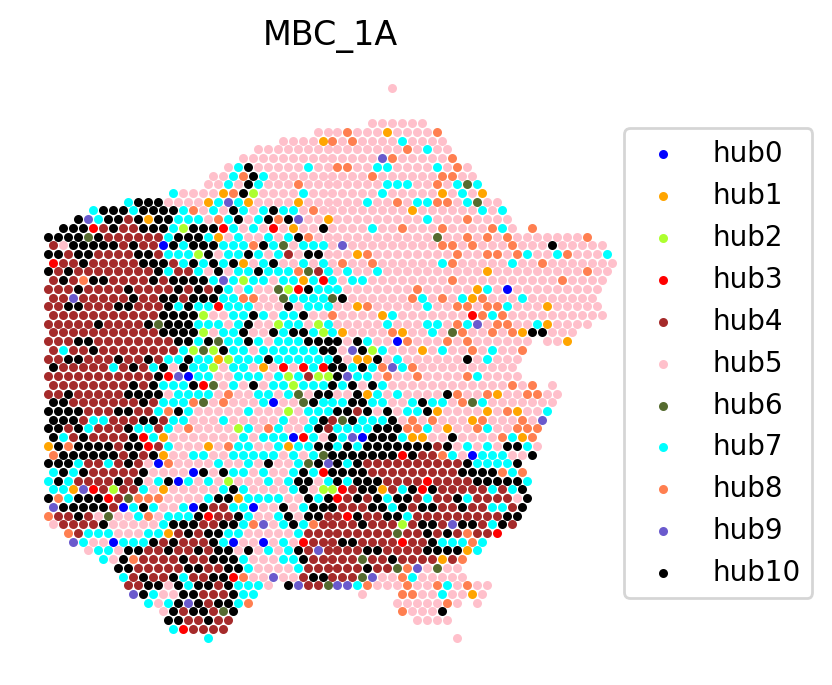

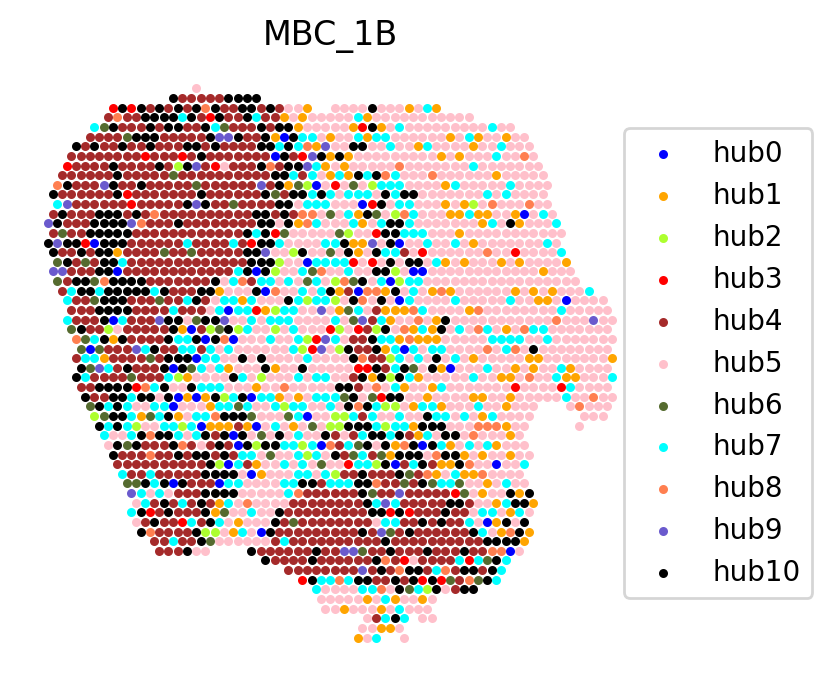

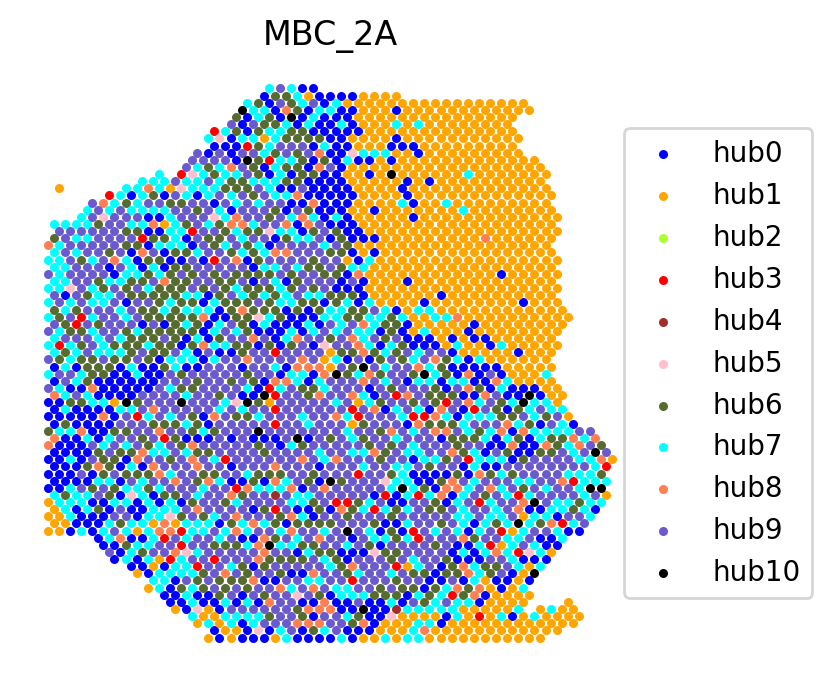

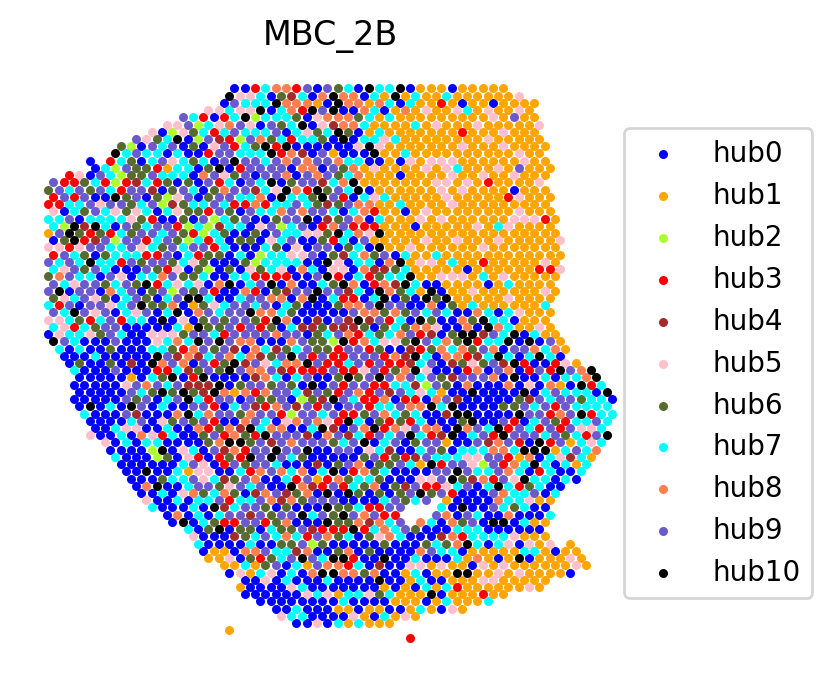

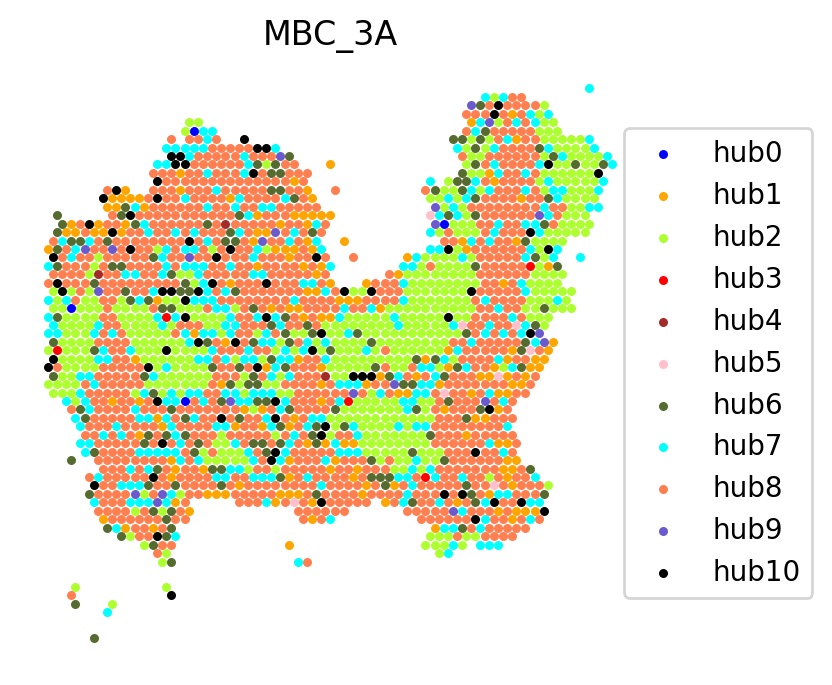

...

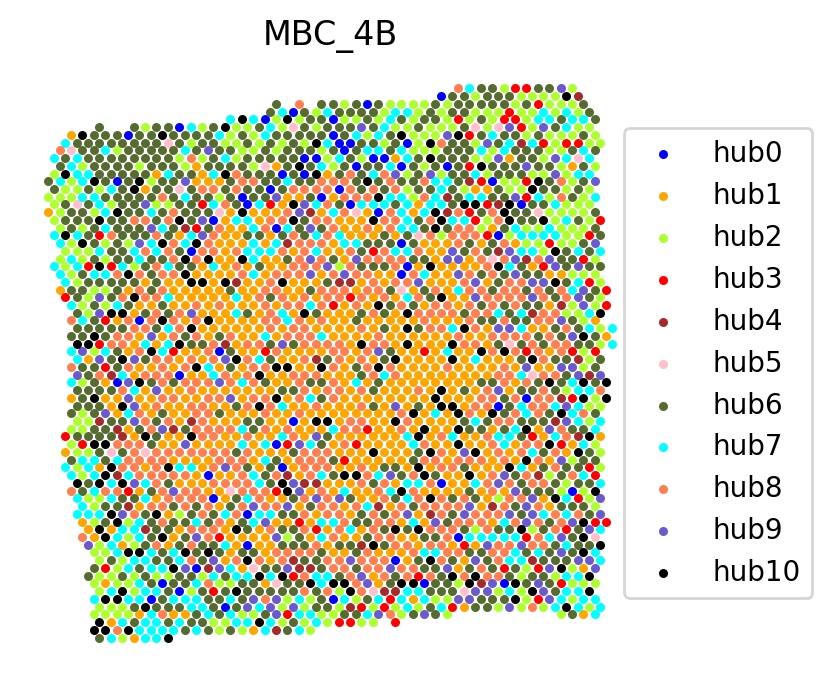

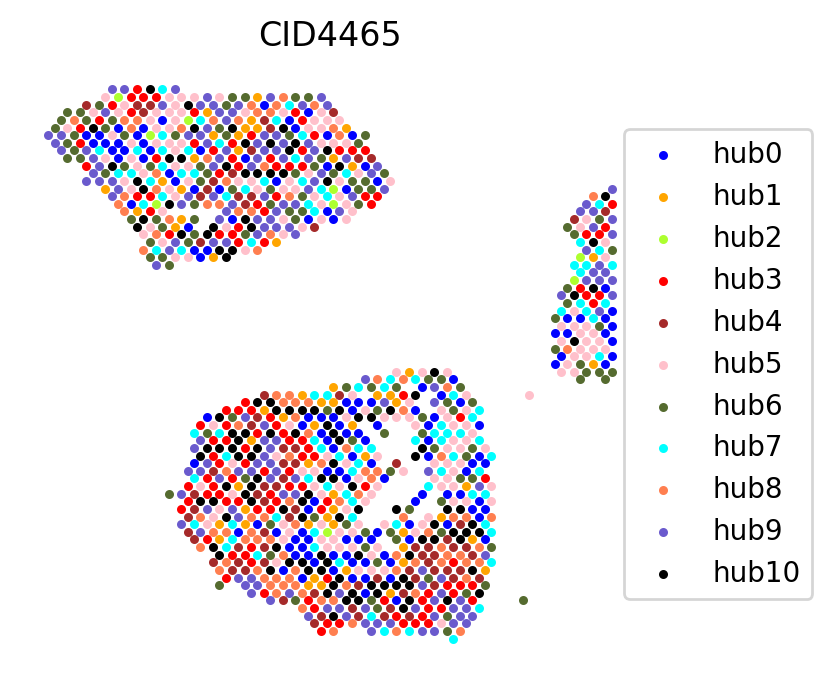

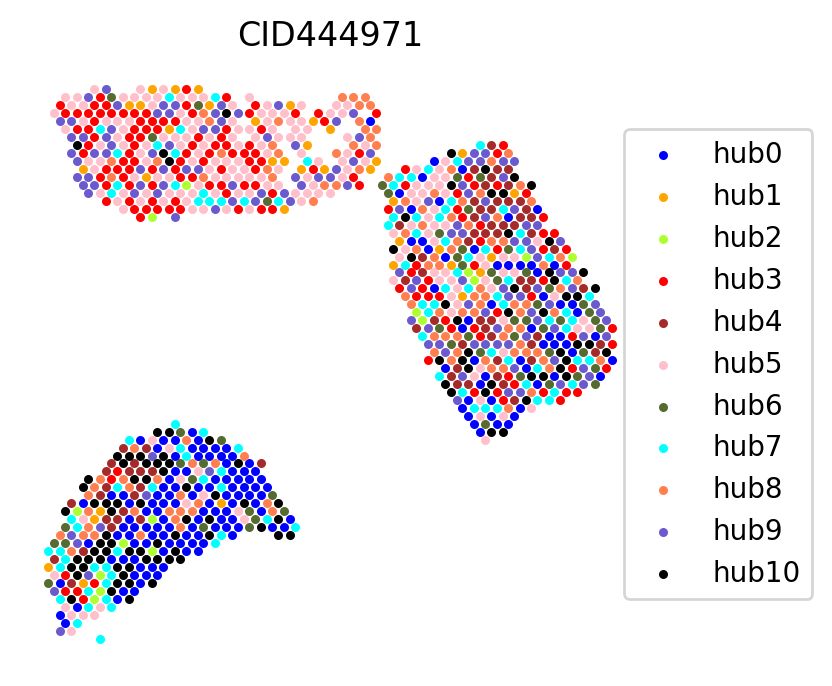

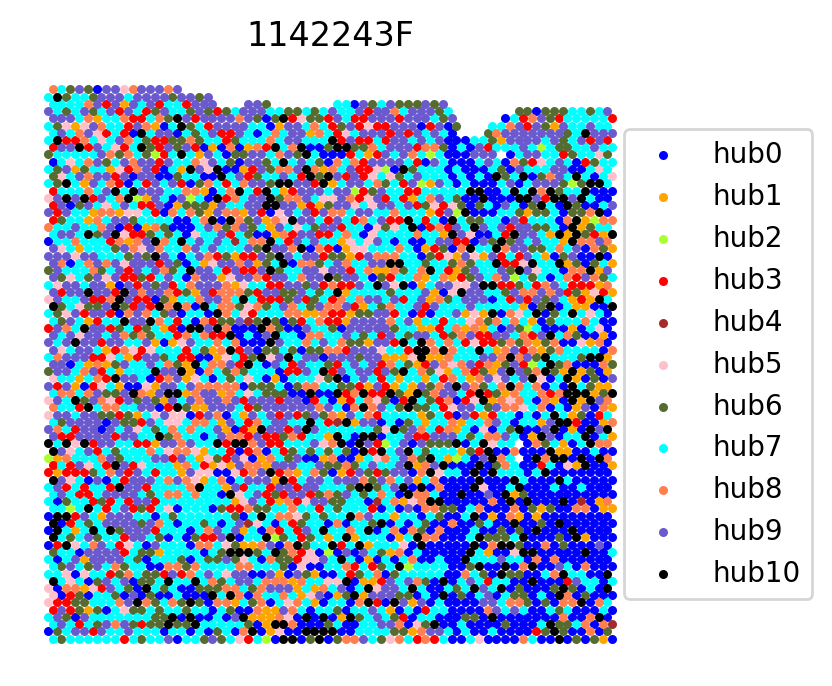

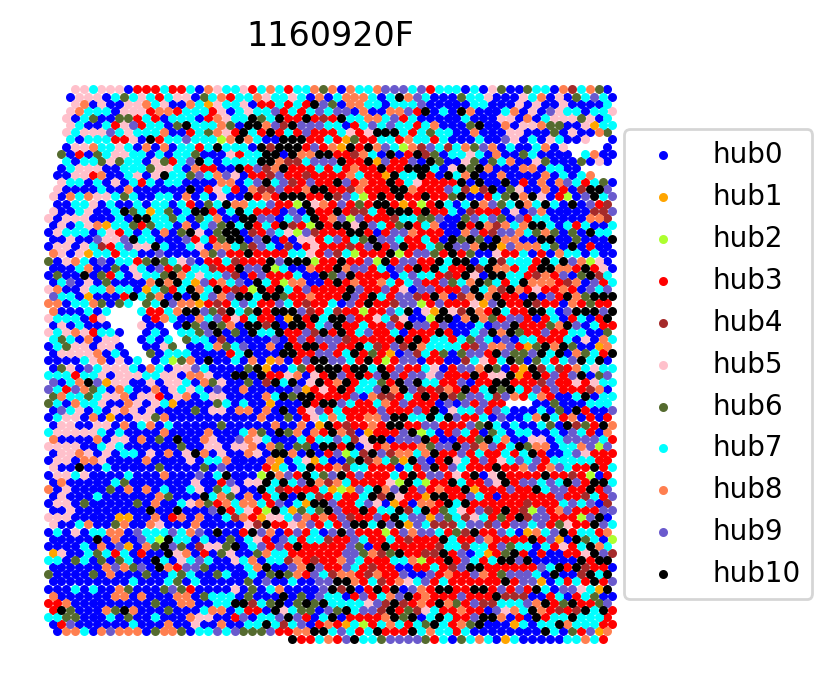

In [170]:
# load all expression data  [spot x gene]
data_path = 'data'
sample_ids = ['MBC_1A',
             'MBC_1B',
             'MBC_2A',
             'MBC_2B',
             'MBC_3A',
             'MBC_3B',
             'MBC_4A',
             'MBC_4B',
             'CID4465',
             'CID444971',
             '1142243F',
             '1160920F'
            ]

for sample_id in sample_ids:
    data_path = '../data'
    if sample_id.startswith('MBC'):

        adata_sample = sc.read_visium(path=os.path.join(data_path, sample_id),library_id =  sample_id)
        adata_sample.var_names_make_unique()
        adata_sample.obs['sample']=sample_id
        adata_sample.obs_names  = adata_sample.obs_names+'-'+sample_id
    else:
        adata_sample = sc.read_h5ad(os.path.join(data_path,sample_id, sample_id+'.h5ad'))
        adata_sample.var_names_make_unique()
        adata_sample.obs['sample']=sample_id
        adata_sample.obs_names  = adata_sample.obs_names+'-'+sample_id
        
    cluster_id = pd.DataFrame((np.zeros(len(adata_sample.obs_names))*(-1)).astype(int),columns=['clusters'],index=adata_sample.obs_names)
    
    col_order_df = pd.read_csv('../results/03_hubs/'+'PoE_alltumors_bicluster_res_col_orders_individual.csv')
    row_order_df = pd.read_csv('../results/03_hubs/'+'PoE_alltumors_bicluster_res_row_orders_individual.csv')
    
    map_info = pd.read_csv("../results/02_PoE_factor/"+sample_id+'map_info.csv',index_col=0)
    
    for i in adata_sample.obs_names:
        if i in np.array(row_order_df.loc[:,'id']):
            cluster_id.loc[i,'clusters']= (row_order_df.loc[np.where(row_order_df['id']==i)[0][0],'cluster']).astype(object)
    adata_sample.obs['hub'] =  cluster_id
    
    
    
    fig,axs=plt.subplots(1,1,figsize=(4,4),dpi=200)

    ax=axs
    for i in range(11):
        all_loc = np.array(map_info.loc[cluster_id[cluster_id.clusters==i].index,:].loc[:,['array_col','array_row']])
        #all_spot = np.array(row_order_df[row_order_df.cluster==i].loc[:,'cluster'])
        ax.scatter(all_loc[:,0],-all_loc[:,1],s=5)
    
    ax.set_aspect("auto")
    ax.legend(['hub0','hub1','hub2','hub3','hub4','hub5','hub6','hub7','hub8','hub9','hub10'],loc='right',bbox_to_anchor=(0,0, 1.3, 1.))
    plt.grid(False),
    plt.axis('off')
    plt.title(sample_id)

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Vari

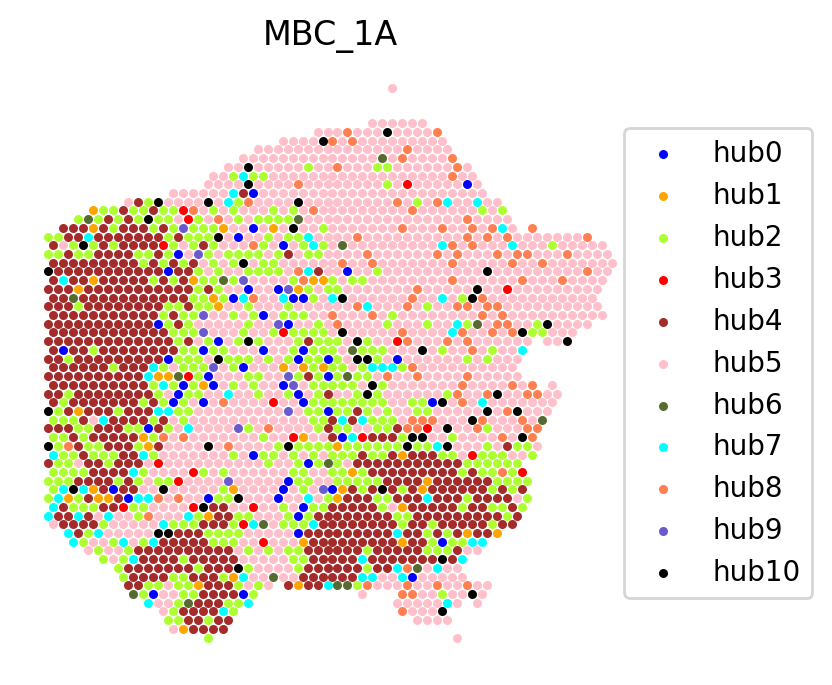

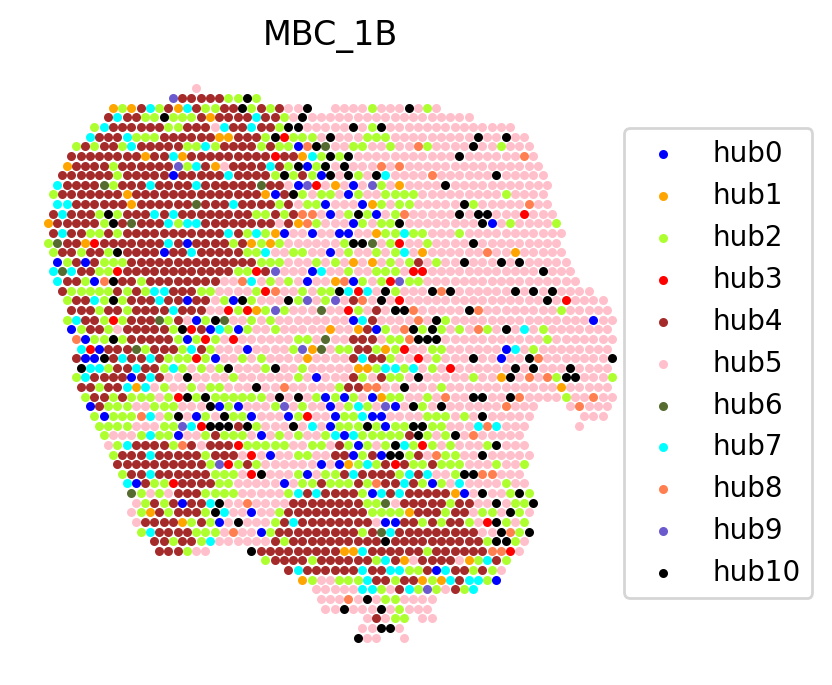

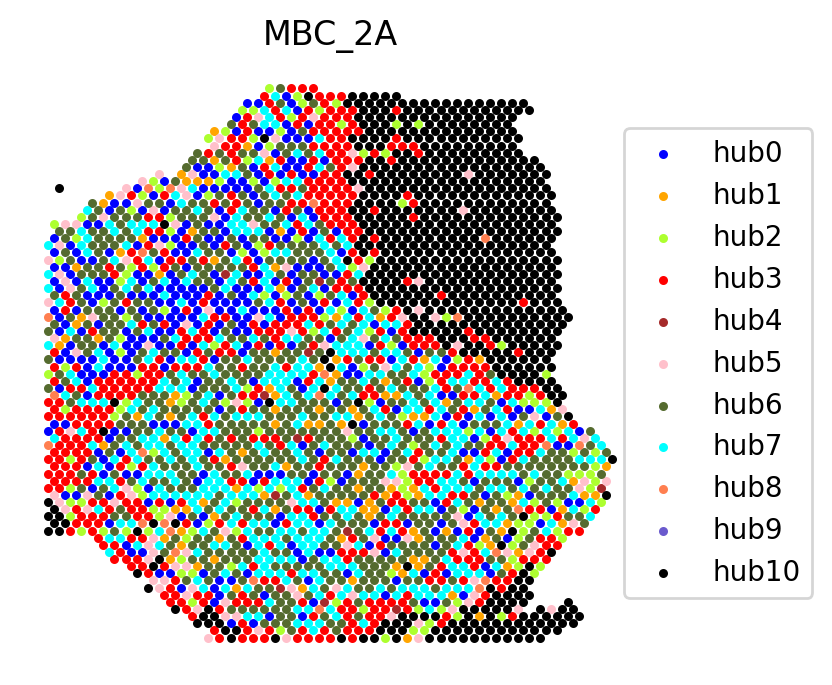

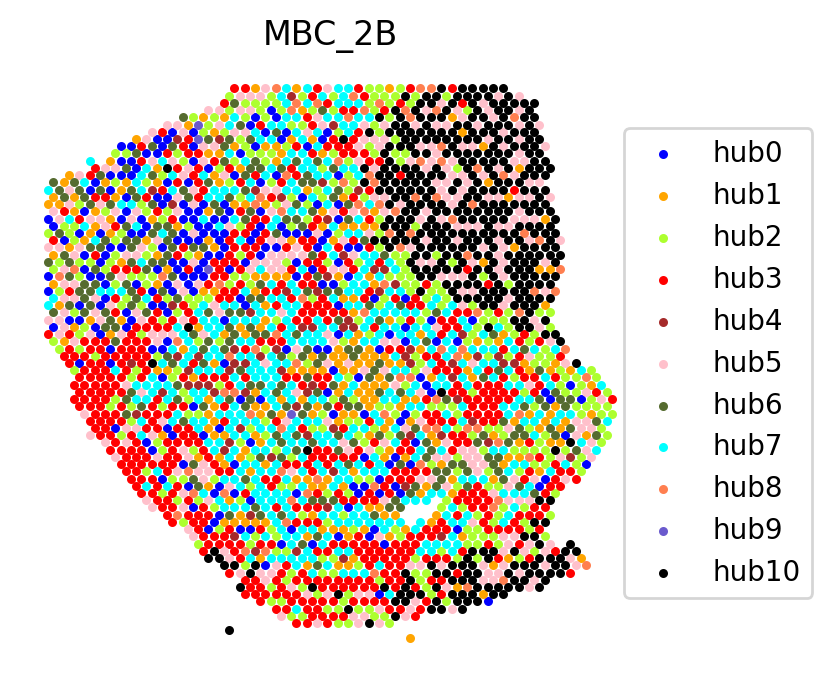

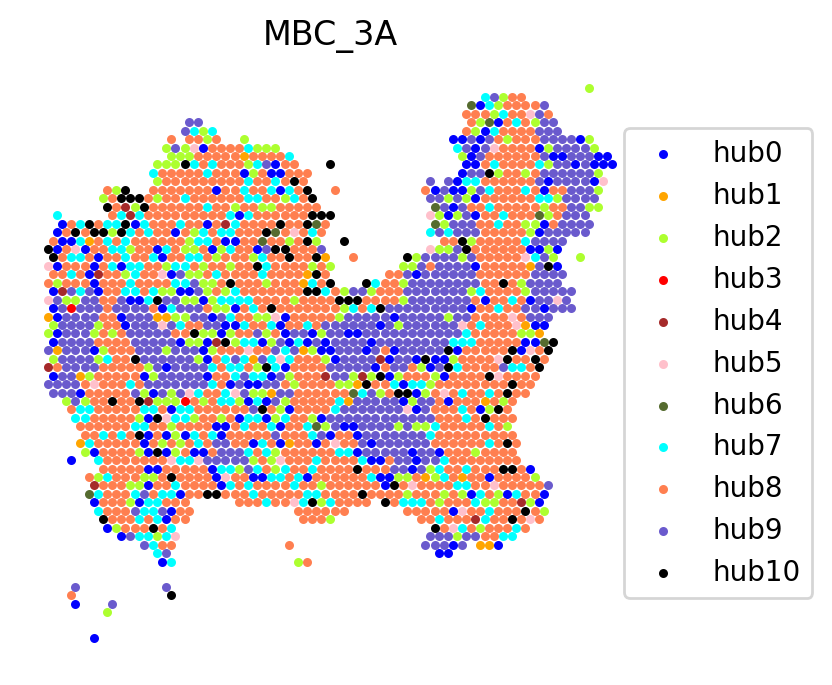

...

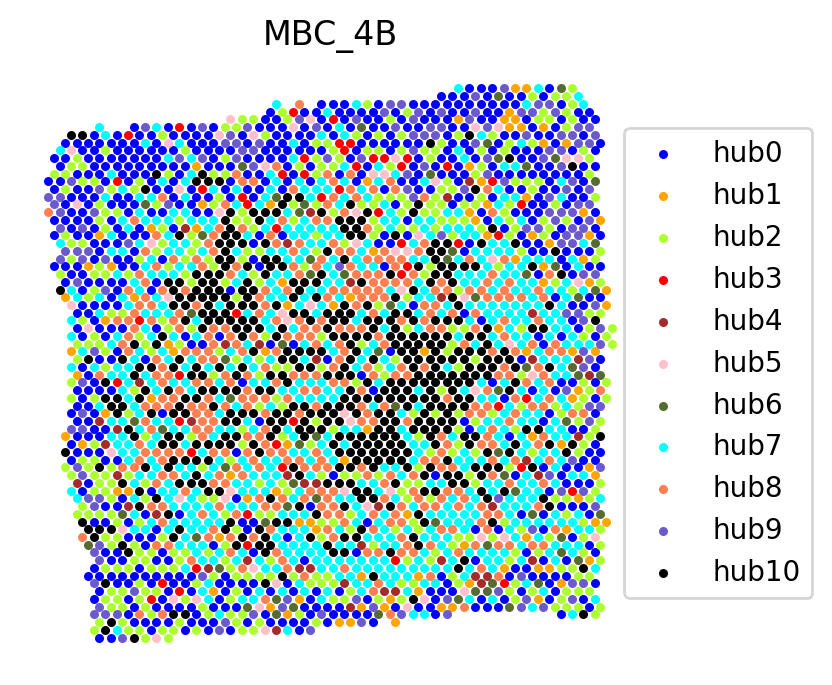

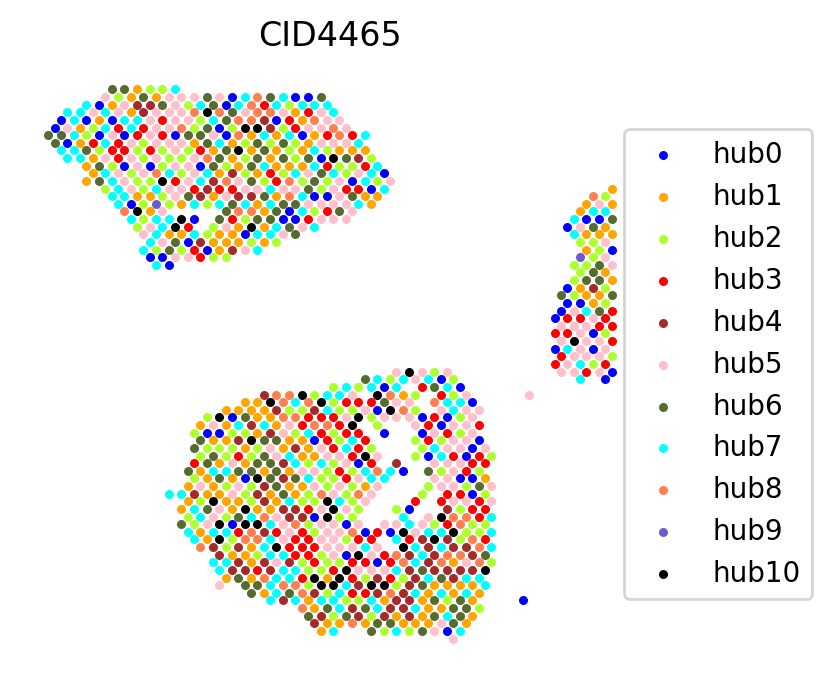

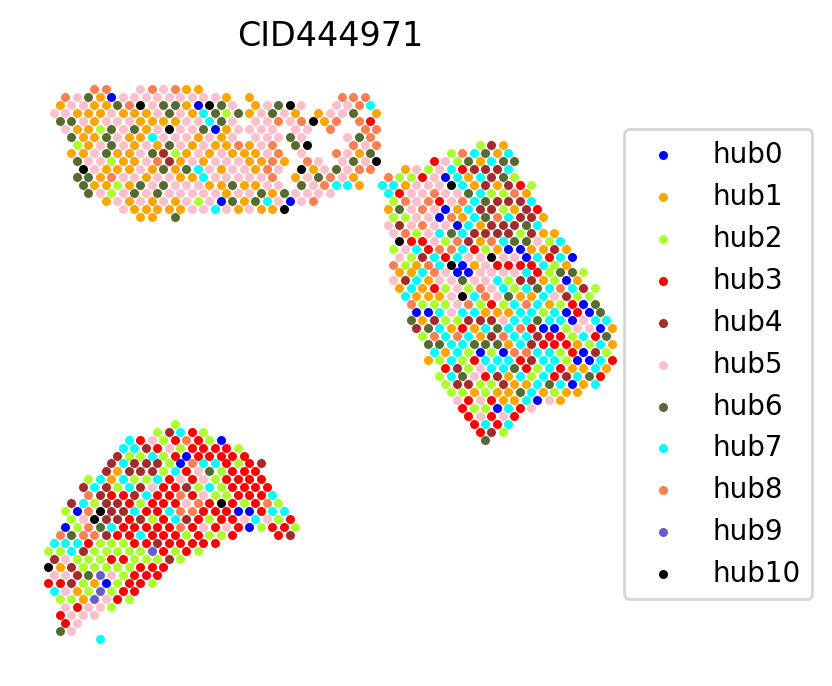

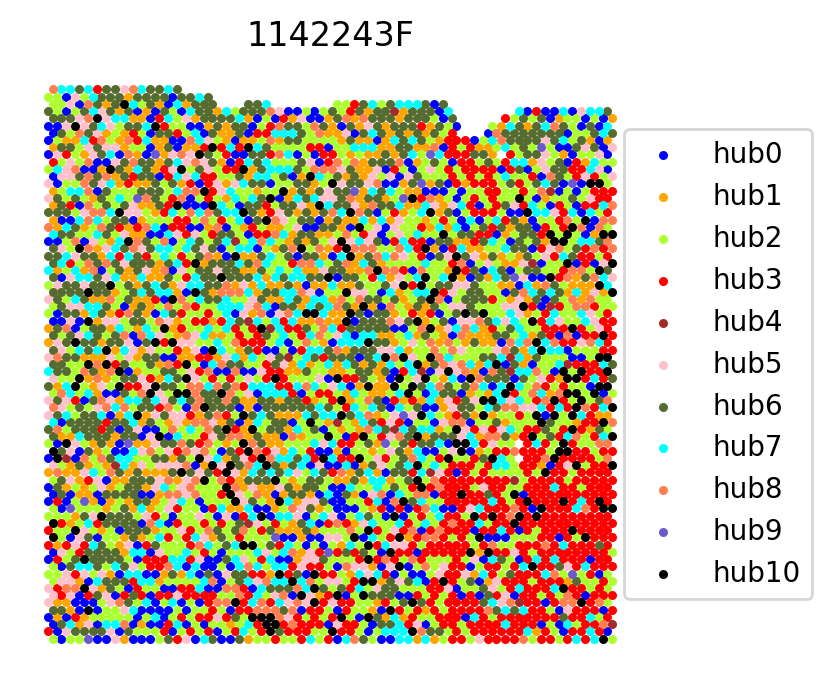

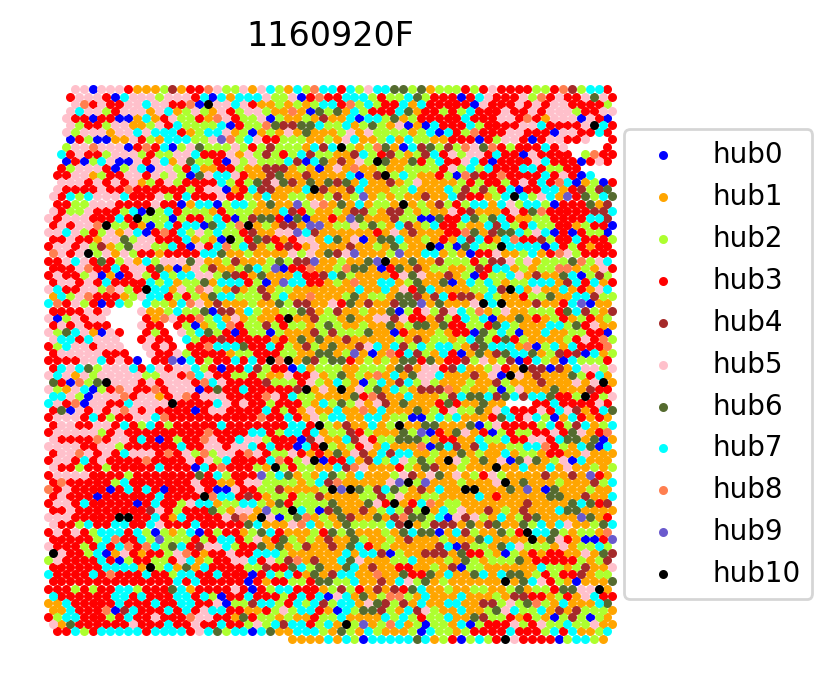

In [169]:
# load all expression data  [spot x gene]
data_path = 'data'
sample_ids = ['MBC_1A',
             'MBC_1B',
             'MBC_2A',
             'MBC_2B',
             'MBC_3A',
             'MBC_3B',
             'MBC_4A',
             'MBC_4B',
             'CID4465',
             'CID444971',
             '1142243F',
             '1160920F'
            ]

for sample_id in sample_ids:
    data_path = '../data'
    if sample_id.startswith('MBC'):

        adata_sample = sc.read_visium(path=os.path.join(data_path, sample_id),library_id =  sample_id)
        adata_sample.var_names_make_unique()
        adata_sample.obs['sample']=sample_id
        adata_sample.obs_names  = adata_sample.obs_names+'-'+sample_id
    else:
        adata_sample = sc.read_h5ad(os.path.join(data_path,sample_id, sample_id+'.h5ad'))
        adata_sample.var_names_make_unique()
        adata_sample.obs['sample']=sample_id
        adata_sample.obs_names  = adata_sample.obs_names+'-'+sample_id
        
    cluster_id = pd.DataFrame((np.zeros(len(adata_sample.obs_names))*(-1)).astype(int),columns=['clusters'],index=adata_sample.obs_names)
    
    col_order_df = pd.read_csv('../results/03_hubs/'+'PoE_alltumors_bicluster_res_col_orders_individual.csv')
    row_order_df = pd.read_csv('../results/03_hubs/'+'PoE_alltumors_bicluster_res_row_orders_individual.csv')
    
    map_info = pd.read_csv("../results/02_PoE_factor/"+sample_id+'map_info.csv',index_col=0)
    
    for i in adata_sample.obs_names:
        if i in np.array(row_order_df.loc[:,'id']):
            cluster_id.loc[i,'clusters']= (row_order_df.loc[np.where(row_order_df['id']==i)[0][0],'cluster']).astype(object)
    adata_sample.obs['hub'] =  cluster_id
    
    
    
    fig,axs=plt.subplots(1,1,figsize=(4,4),dpi=200)

    ax=axs
    for i in range(11):
        all_loc = np.array(map_info.loc[cluster_id[cluster_id.clusters==i].index,:].loc[:,['array_col','array_row']])
        #all_spot = np.array(row_order_df[row_order_df.cluster==i].loc[:,'cluster'])
        ax.scatter(all_loc[:,0],-all_loc[:,1],s=5)
    
    ax.set_aspect("auto")
    ax.legend(['hub0','hub1','hub2','hub3','hub4','hub5','hub6','hub7','hub8','hub9','hub10'],loc='right',bbox_to_anchor=(0,0, 1.3, 1.))
    plt.grid(False),
    plt.axis('off')
    plt.title(sample_id)

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Vari

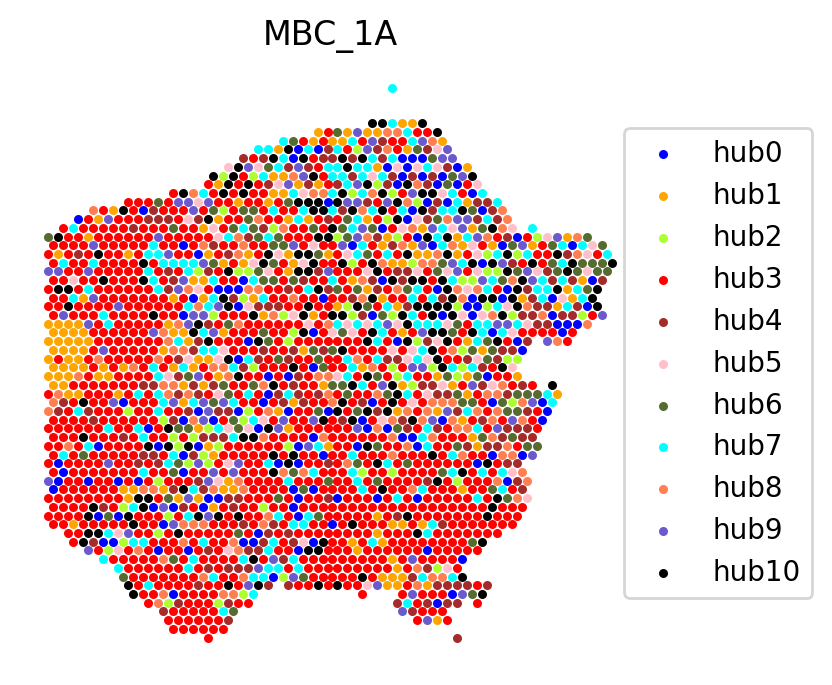

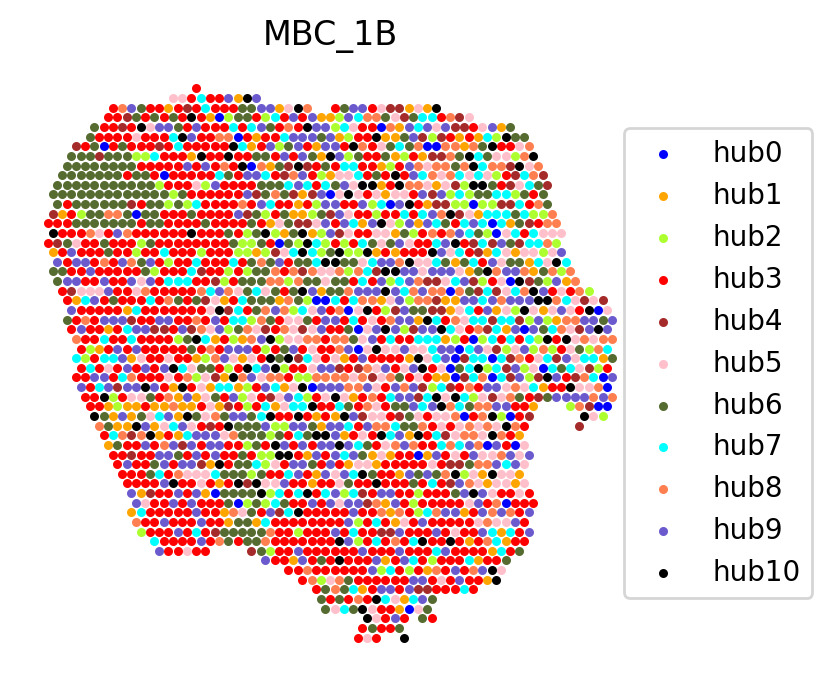

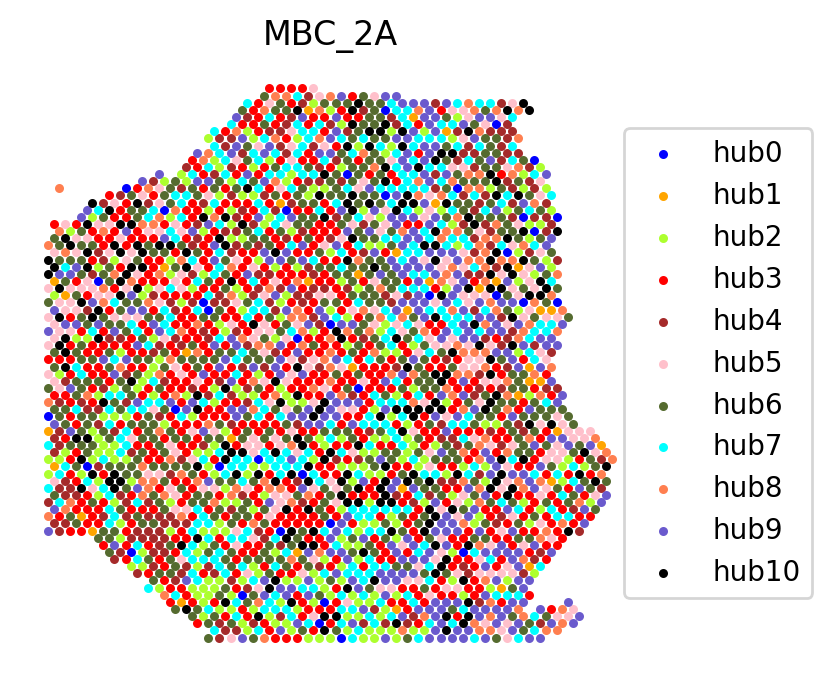

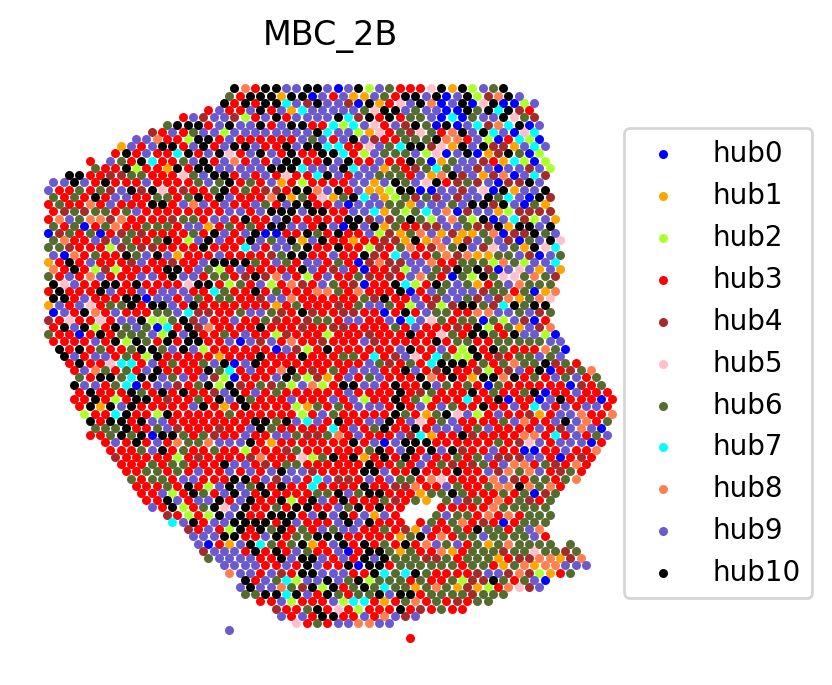

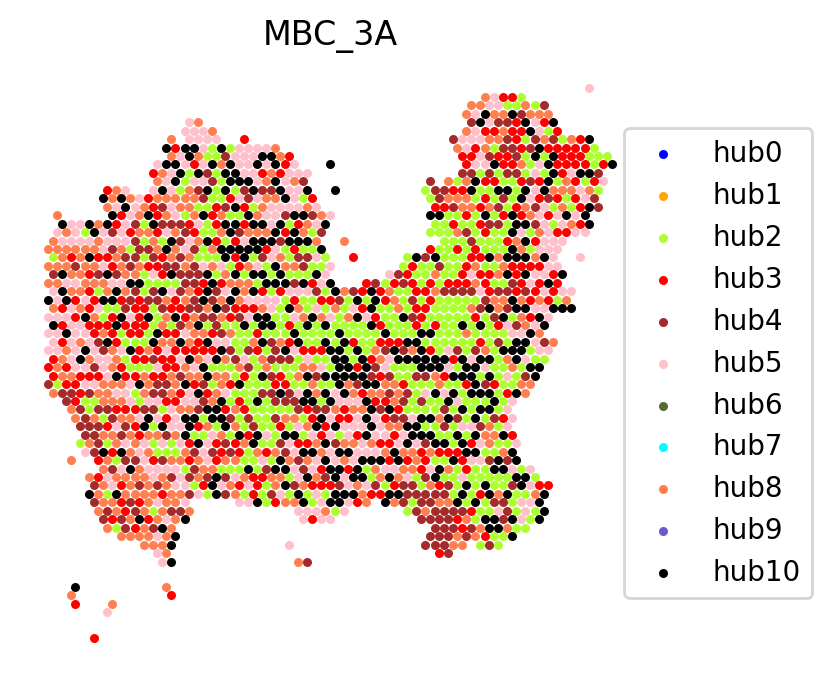

...

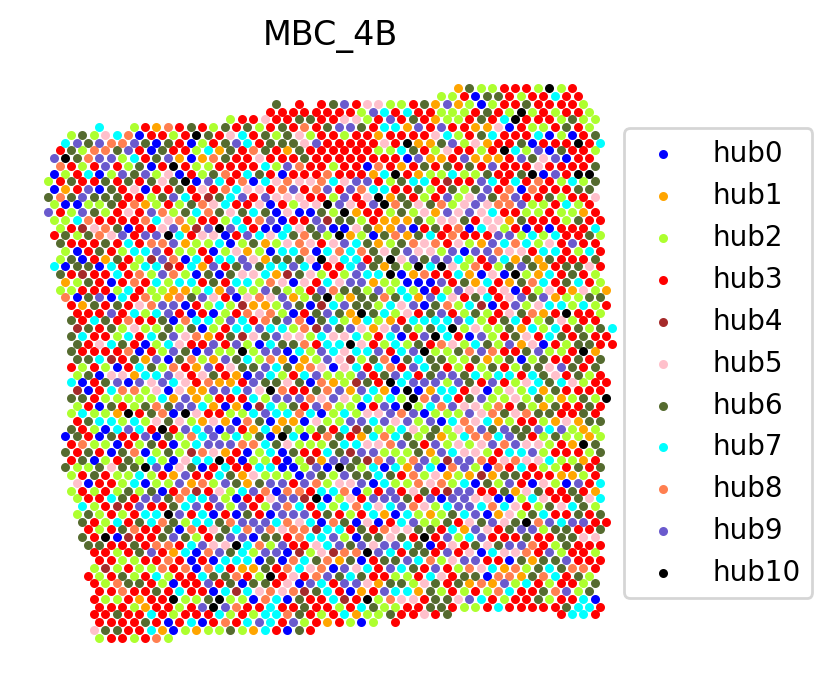

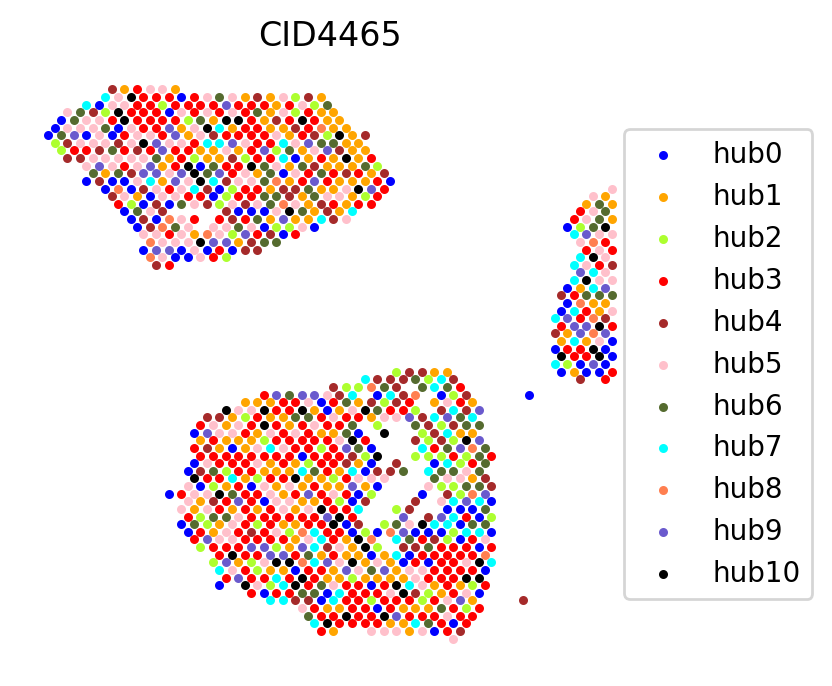

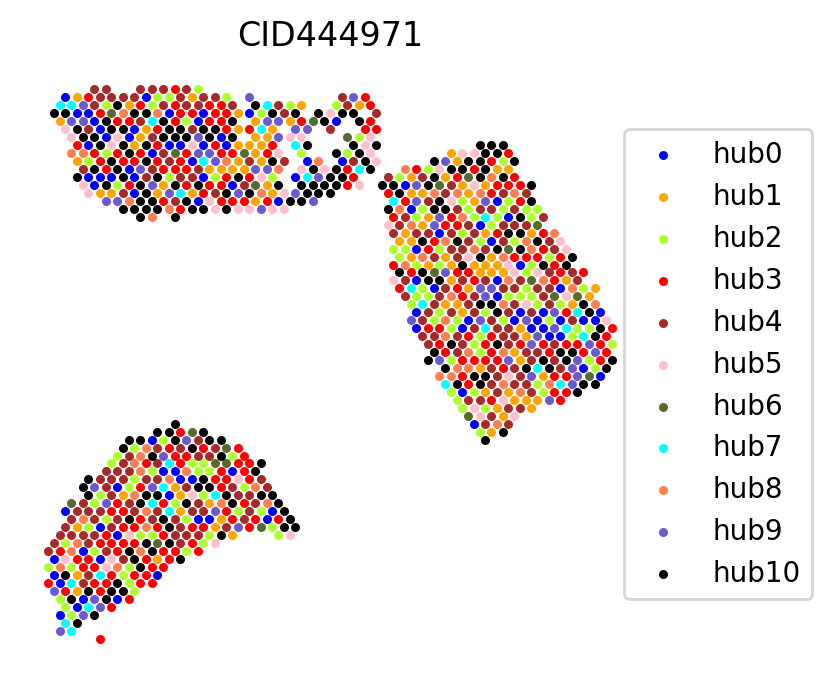

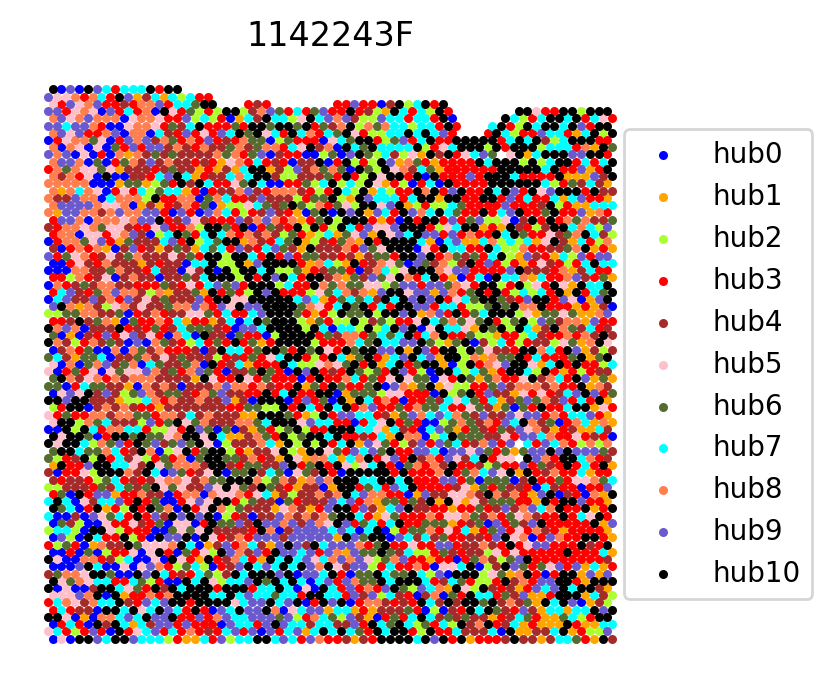

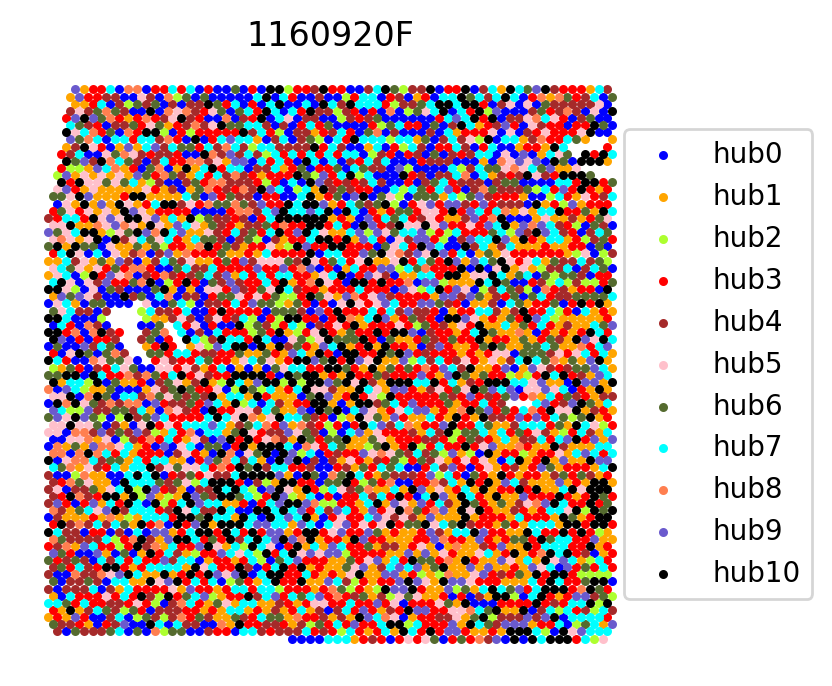

In [97]:
# load all expression data  [spot x gene]
data_path = 'data'
sample_ids = ['MBC_1A',
             'MBC_1B',
             'MBC_2A',
             'MBC_2B',
             'MBC_3A',
             'MBC_3B',
             'MBC_4A',
             'MBC_4B',
             'CID4465',
             'CID444971',
             '1142243F',
             '1160920F'
            ]

for sample_id in sample_ids:
    data_path = '../data'
    if sample_id.startswith('MBC'):

        adata_sample = sc.read_visium(path=os.path.join(data_path, sample_id),library_id =  sample_id)
        adata_sample.var_names_make_unique()
        adata_sample.obs['sample']=sample_id
        adata_sample.obs_names  = adata_sample.obs_names+'-'+sample_id
    else:
        adata_sample = sc.read_h5ad(os.path.join(data_path,sample_id, sample_id+'.h5ad'))
        adata_sample.var_names_make_unique()
        adata_sample.obs['sample']=sample_id
        adata_sample.obs_names  = adata_sample.obs_names+'-'+sample_id
        
    cluster_id = pd.DataFrame((np.zeros(len(adata_sample.obs_names))*(-1)).astype(int),columns=['clusters'],index=adata_sample.obs_names)
    
    col_order_df = pd.read_csv('../results/03_hubs/'+'RNA_alltumors_bicluster_res_col_orders_individual.csv')
    row_order_df = pd.read_csv('../results/03_hubs/'+'RNA_alltumors_bicluster_res_row_orders_individual.csv')
    
    map_info = pd.read_csv("../results/02_PoE_factor/"+sample_id+'map_info.csv',index_col=0)
    
    for i in adata_sample.obs_names:
        if i in np.array(row_order_df.loc[:,'id']):
            cluster_id.loc[i,'clusters']= (row_order_df.loc[np.where(row_order_df['id']==i)[0][0],'cluster']).astype(object)
    adata_sample.obs['hub'] =  cluster_id
    
    
    
    fig,axs=plt.subplots(1,1,figsize=(4,4),dpi=200)

    ax=axs
    for i in range(11):
        all_loc = np.array(map_info.loc[cluster_id[cluster_id.clusters==i].index,:].loc[:,['array_col','array_row']])
        #all_spot = np.array(row_order_df[row_order_df.cluster==i].loc[:,'cluster'])
        ax.scatter(all_loc[:,0],-all_loc[:,1],s=5)
    
    ax.set_aspect("auto")
    ax.legend(['hub0','hub1','hub2','hub3','hub4','hub5','hub6','hub7','hub8','hub9','hub10'],loc='right',bbox_to_anchor=(0,0, 1.3, 1.))
    plt.grid(False),
    plt.axis('off')
    plt.title(sample_id)

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Vari

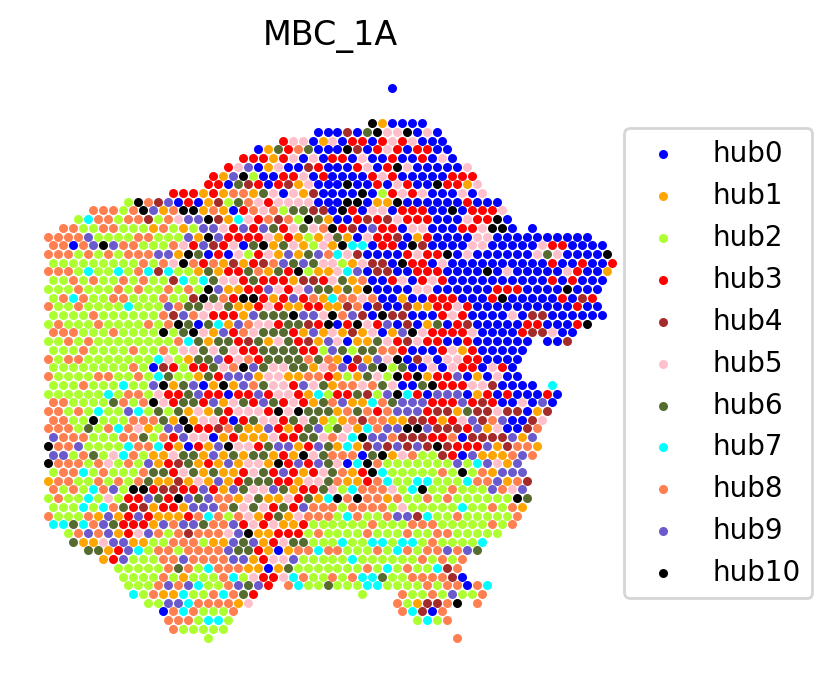

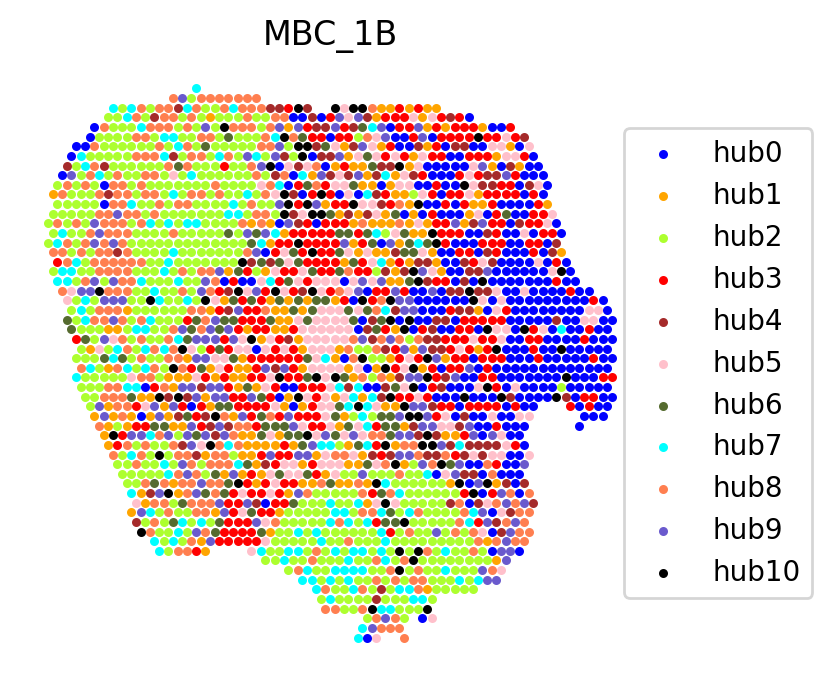

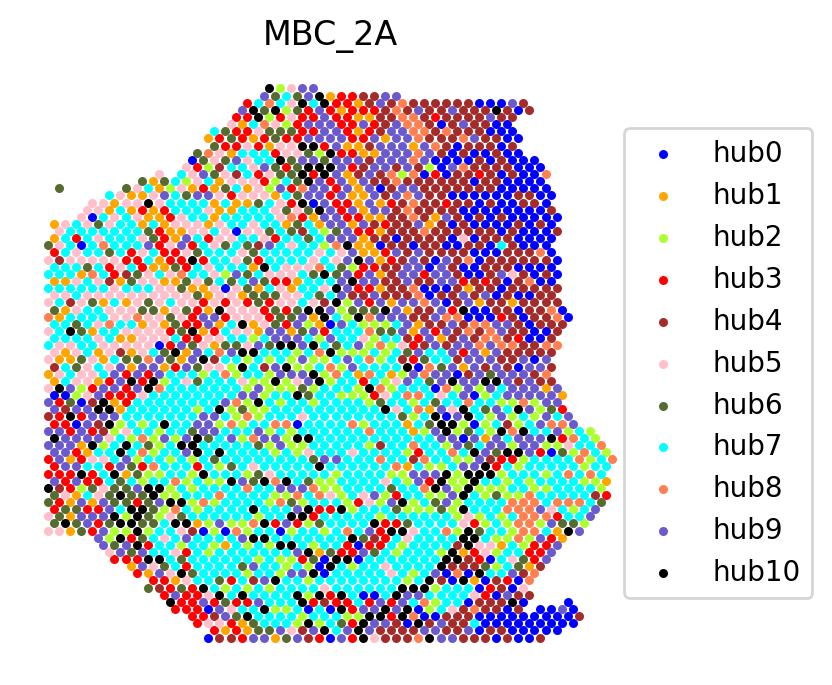

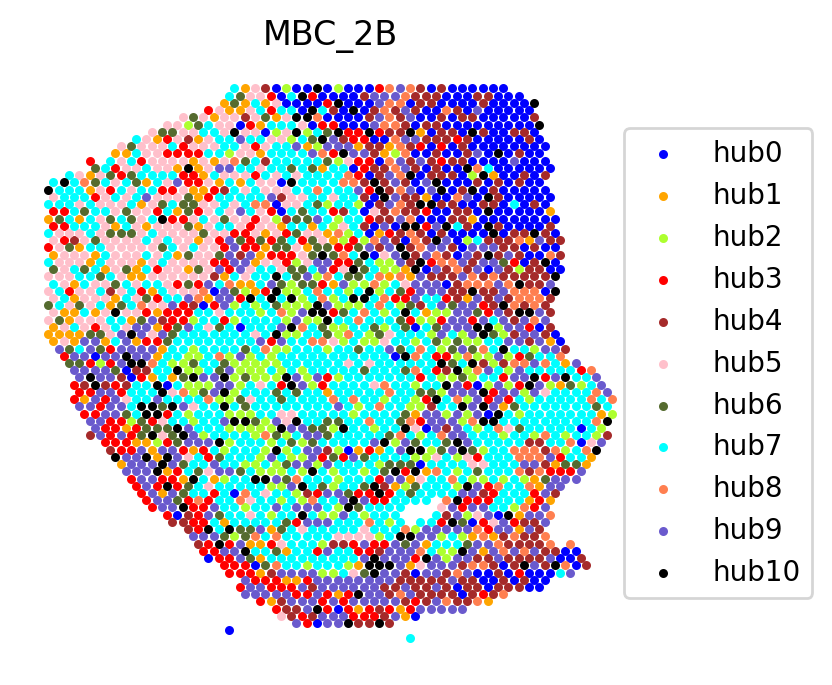

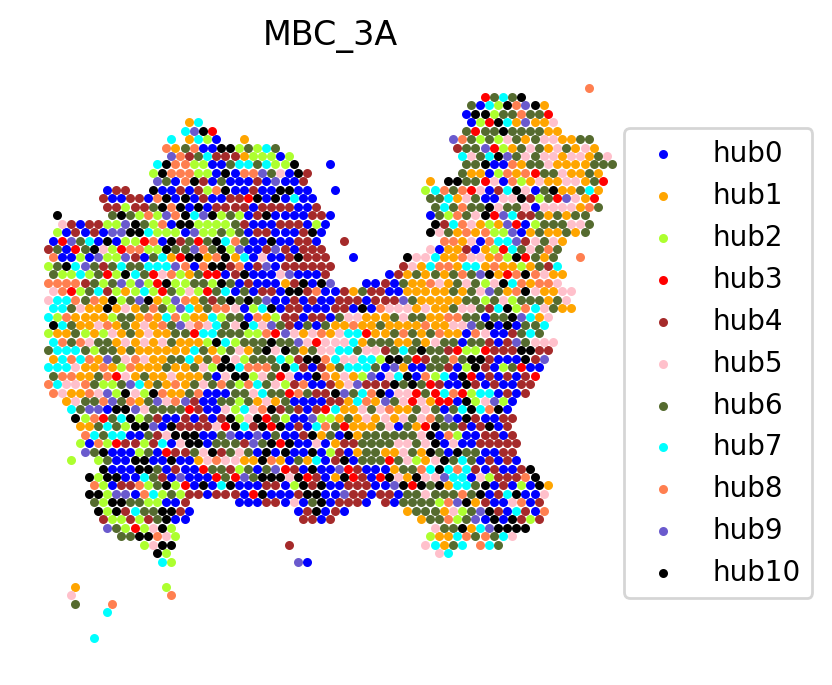

...

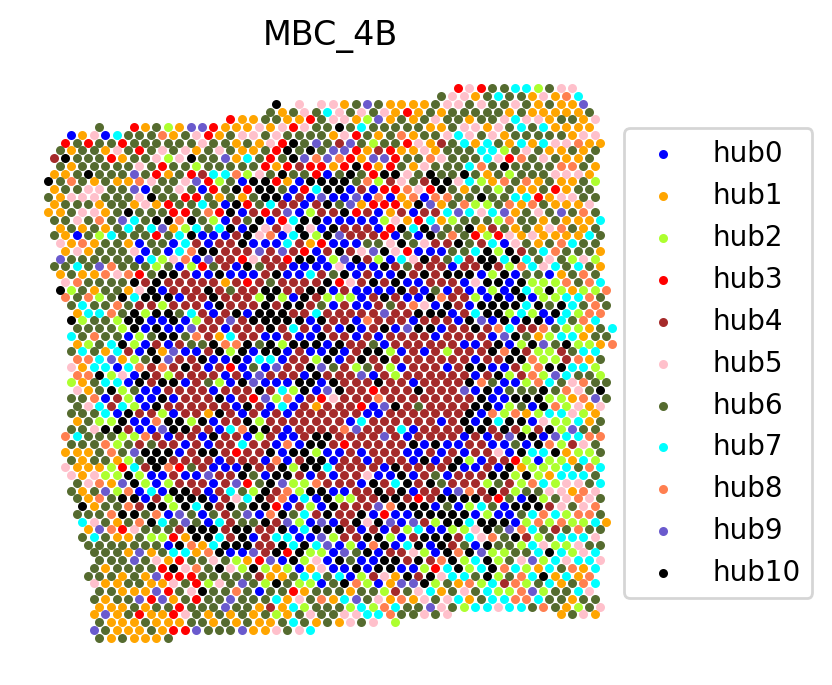

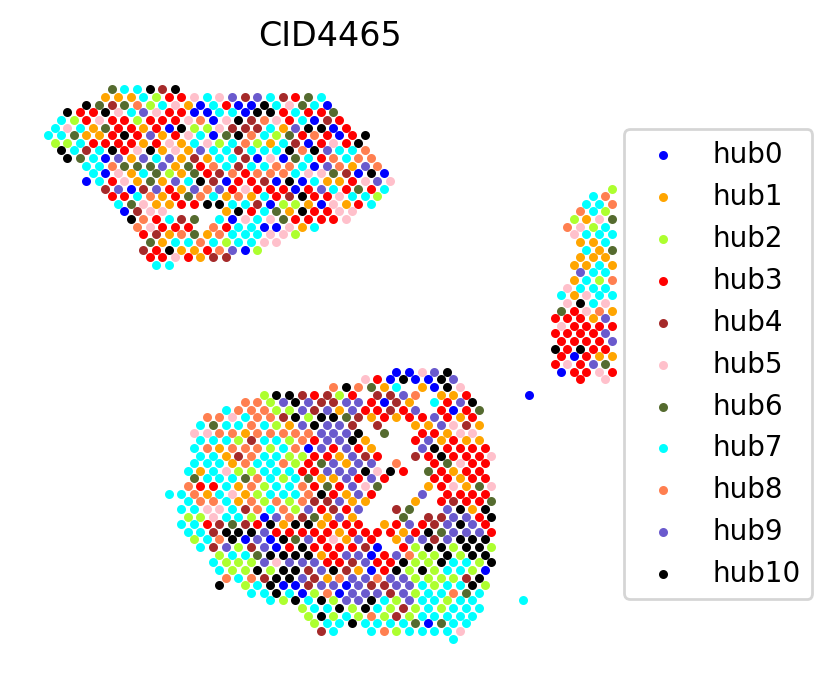

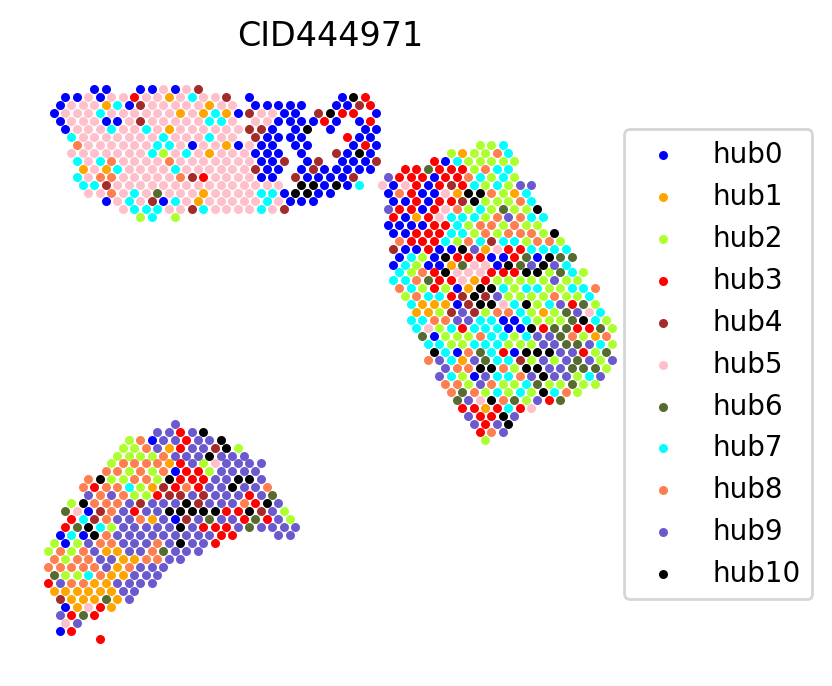

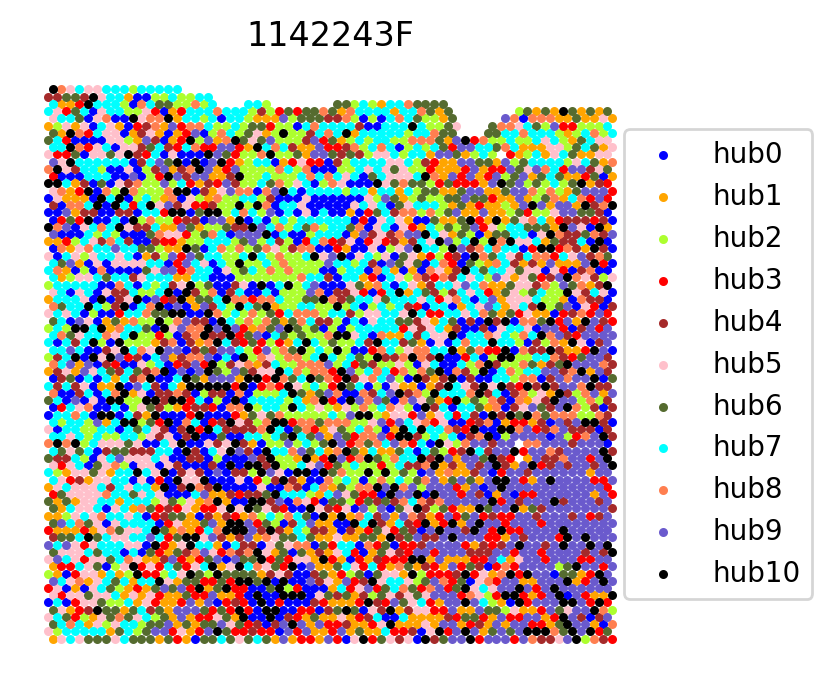

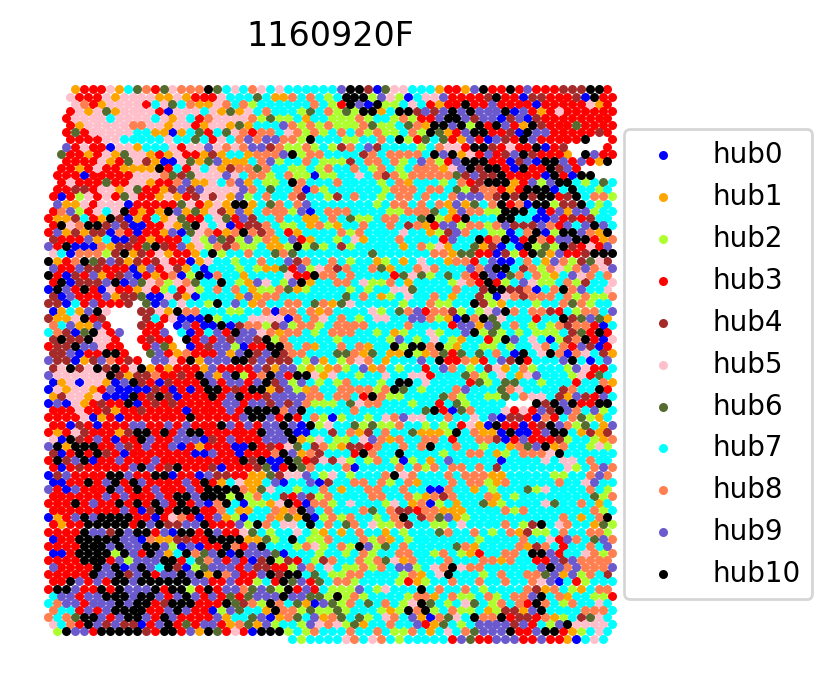

In [367]:
# load all expression data  [spot x gene]
data_path = 'data'
sample_ids = ['MBC_1A',
             'MBC_1B',
             'MBC_2A',
             'MBC_2B',
             'MBC_3A',
             'MBC_3B',
             'MBC_4A',
             'MBC_4B',
             'CID4465',
             'CID444971',
             '1142243F',
             '1160920F'
            ]

for sample_id in sample_ids:
    data_path = '../data'
    if sample_id.startswith('MBC'):

        adata_sample = sc.read_visium(path=os.path.join(data_path, sample_id),library_id =  sample_id)
        adata_sample.var_names_make_unique()
        adata_sample.obs['sample']=sample_id
        adata_sample.obs_names  = adata_sample.obs_names+'-'+sample_id
    else:
        adata_sample = sc.read_h5ad(os.path.join(data_path,sample_id, sample_id+'.h5ad'))
        adata_sample.var_names_make_unique()
        adata_sample.obs['sample']=sample_id
        adata_sample.obs_names  = adata_sample.obs_names+'-'+sample_id
        
    cluster_id = pd.DataFrame((np.zeros(len(adata_sample.obs_names))*(-1)).astype(int),columns=['clusters'],index=adata_sample.obs_names)
    
    col_order_df = pd.read_csv('../results/03_hubs_0106/'+'RNA_alltumors_bicluster_res_col_orders_individual.csv')
    row_order_df = pd.read_csv('../results/03_hubs_0106/'+'RNA_alltumors_bicluster_res_row_orders_individual.csv')
    
    map_info = pd.read_csv("../results/02_PoE_factor_0106/"+sample_id+'map_info.csv',index_col=0)
    
    for i in adata_sample.obs_names:
        if i in np.array(row_order_df.loc[:,'id']):
            cluster_id.loc[i,'clusters']= (row_order_df.loc[np.where(row_order_df['id']==i)[0][0],'cluster']).astype(object)
    adata_sample.obs['hub'] =  cluster_id
    
    
    
    fig,axs=plt.subplots(1,1,figsize=(4,4),dpi=200)

    ax=axs
    for i in range(11):
        all_loc = np.array(map_info.loc[cluster_id[cluster_id.clusters==i].index,:].loc[:,['array_col','array_row']])
        #all_spot = np.array(row_order_df[row_order_df.cluster==i].loc[:,'cluster'])
        ax.scatter(all_loc[:,0],-all_loc[:,1],s=5)
    
    ax.set_aspect("auto")
    ax.legend(['hub0','hub1','hub2','hub3','hub4','hub5','hub6','hub7','hub8','hub9','hub10'],loc='right',bbox_to_anchor=(0,0, 1.3, 1.))
    plt.grid(False),
    plt.axis('off')
    plt.title(sample_id)

# boxplots of the factors per patient

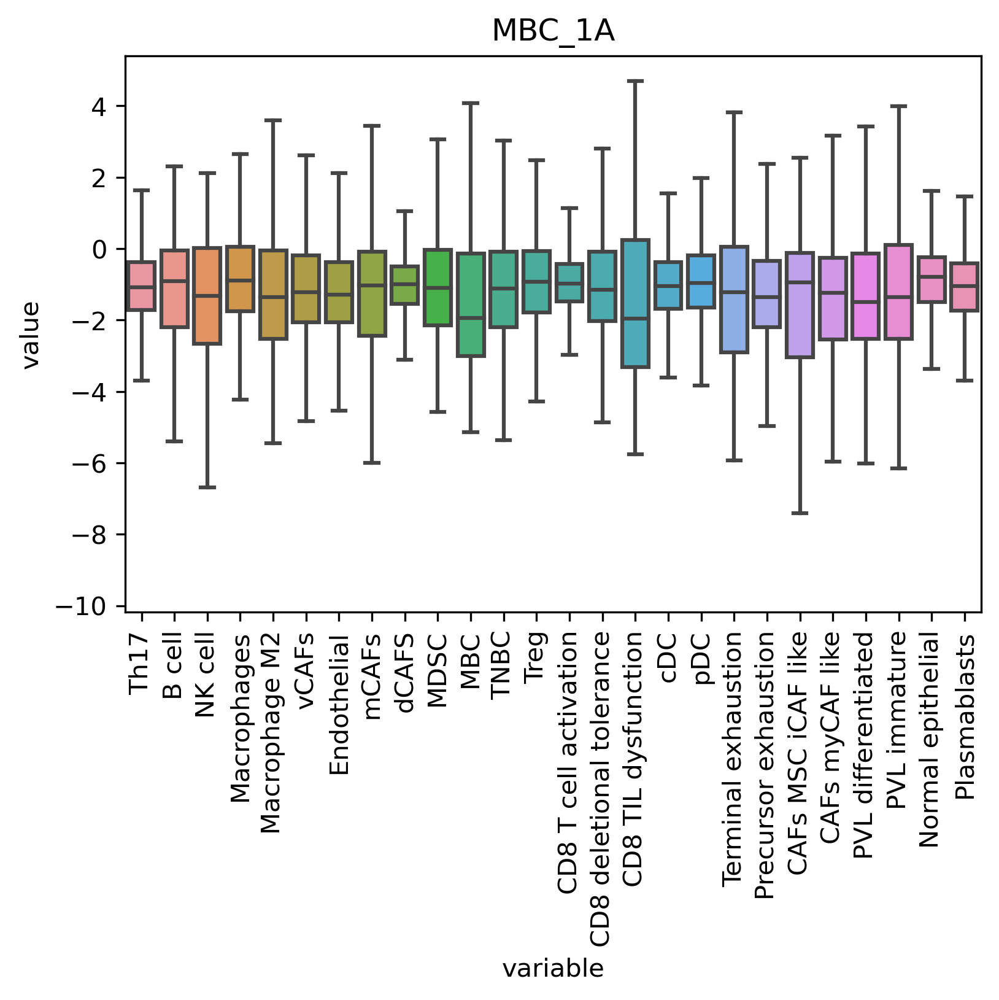

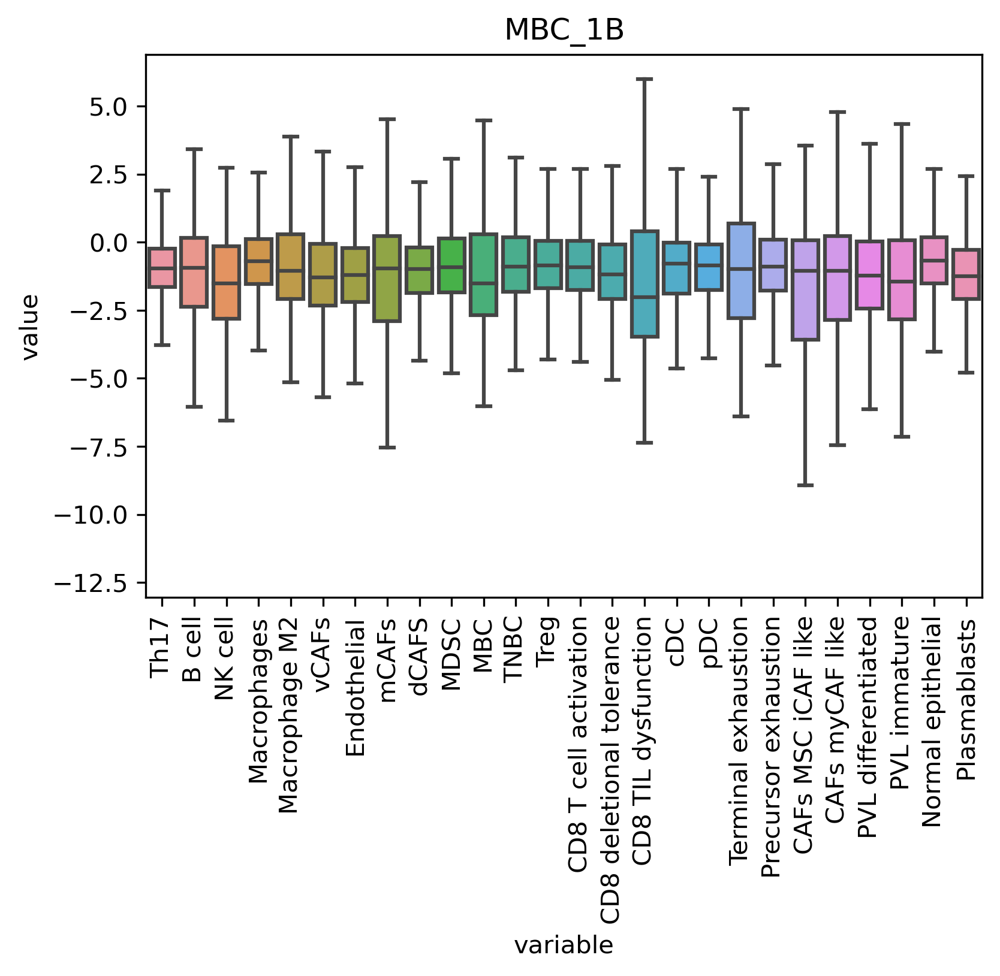

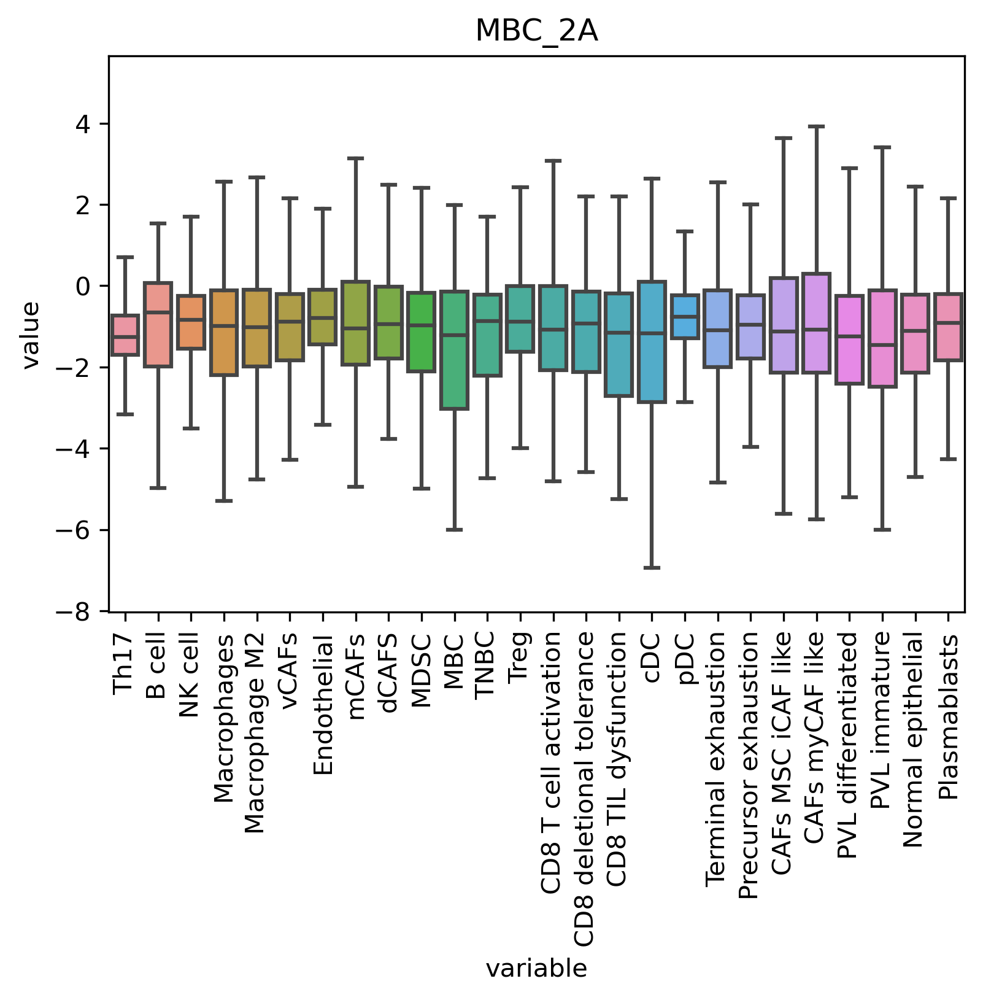

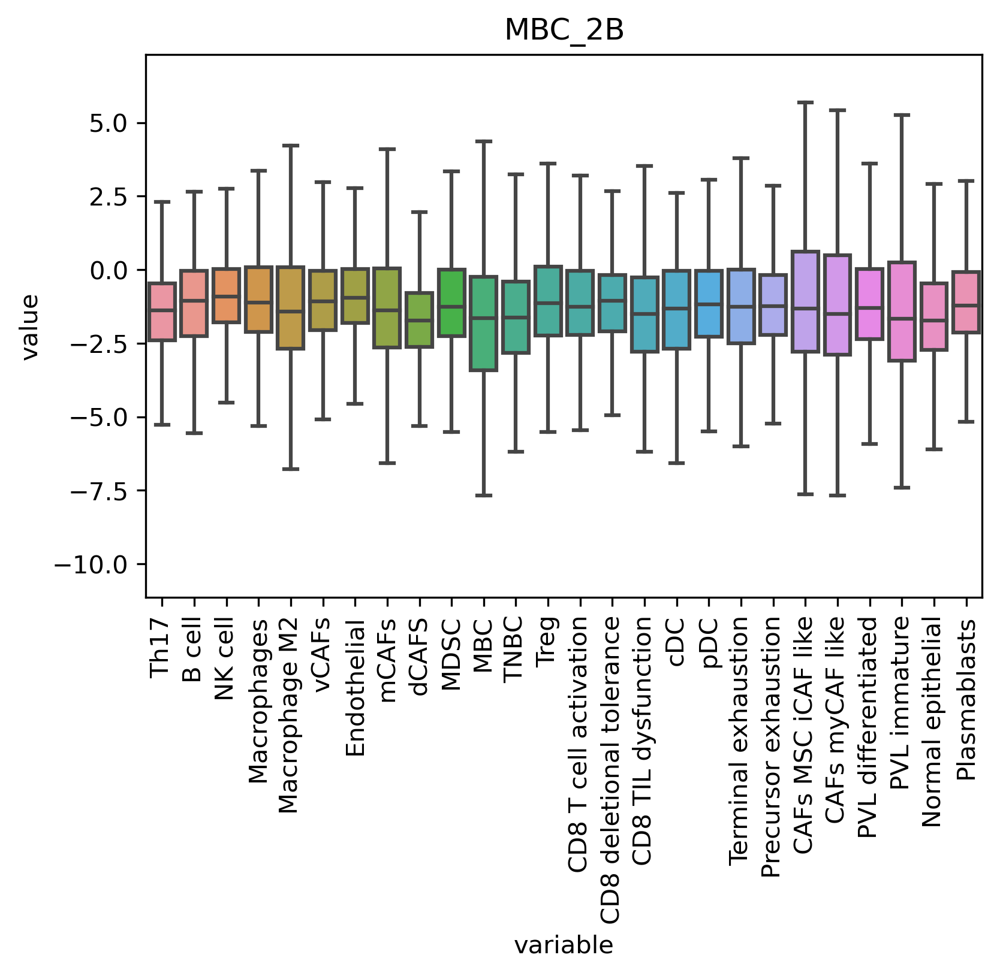

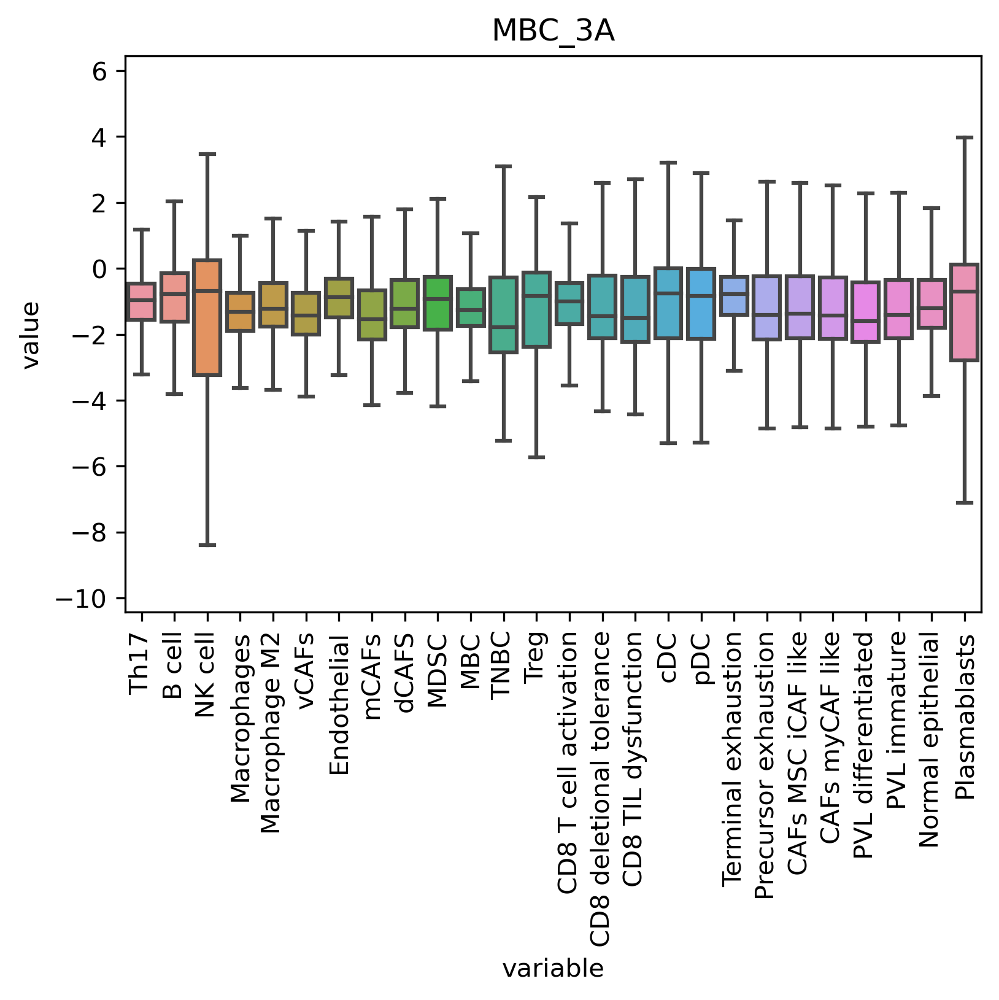

...

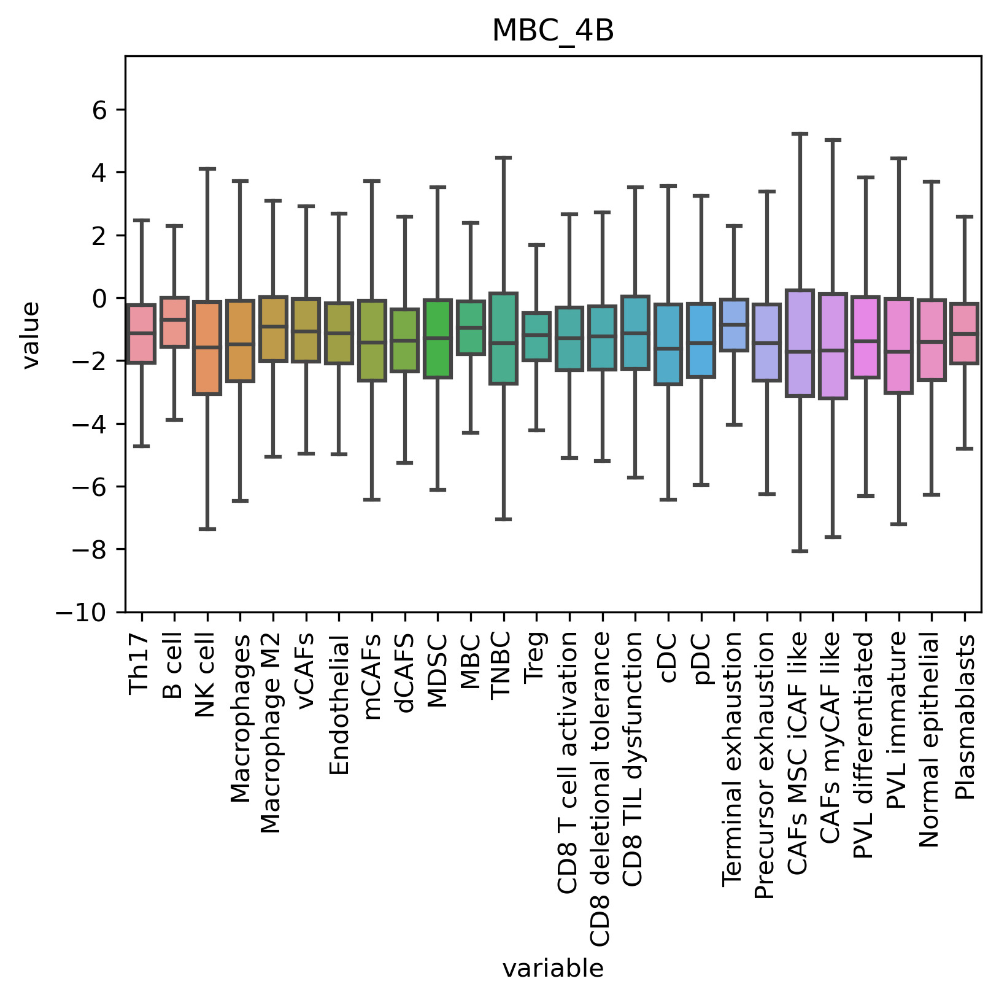

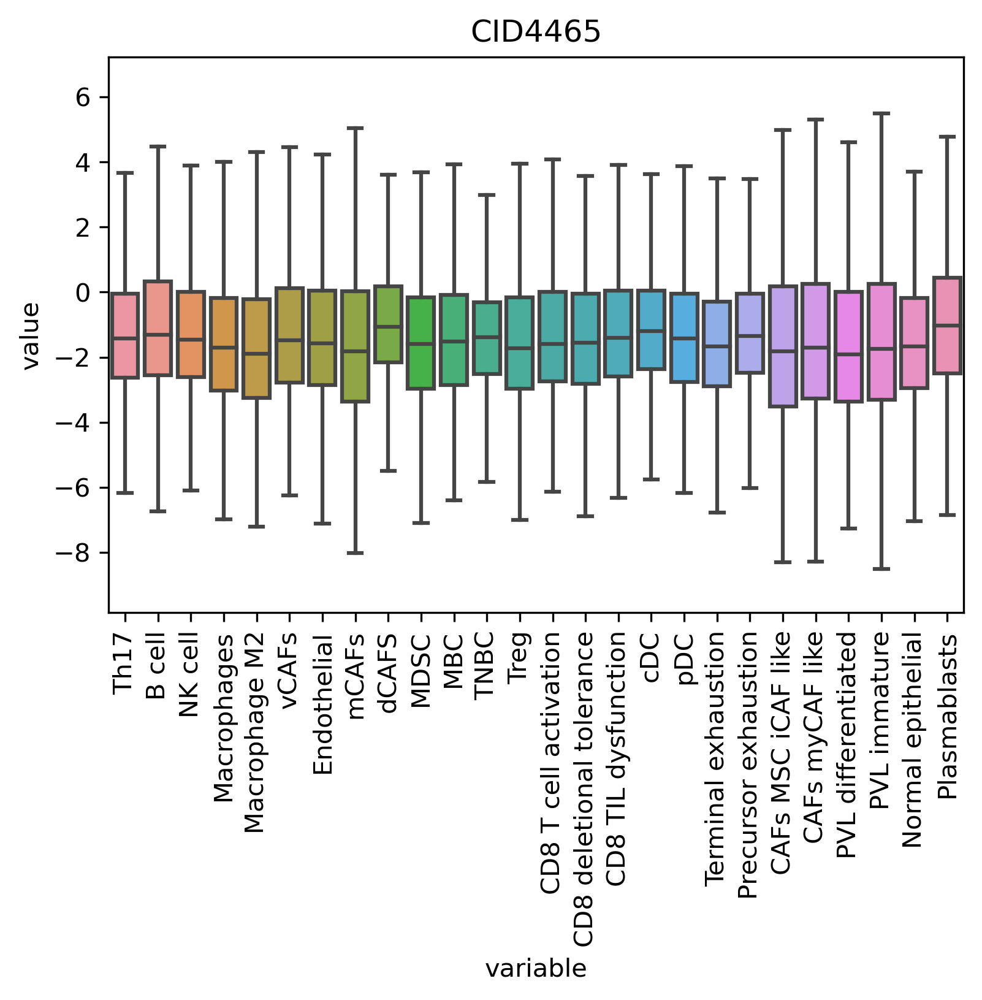

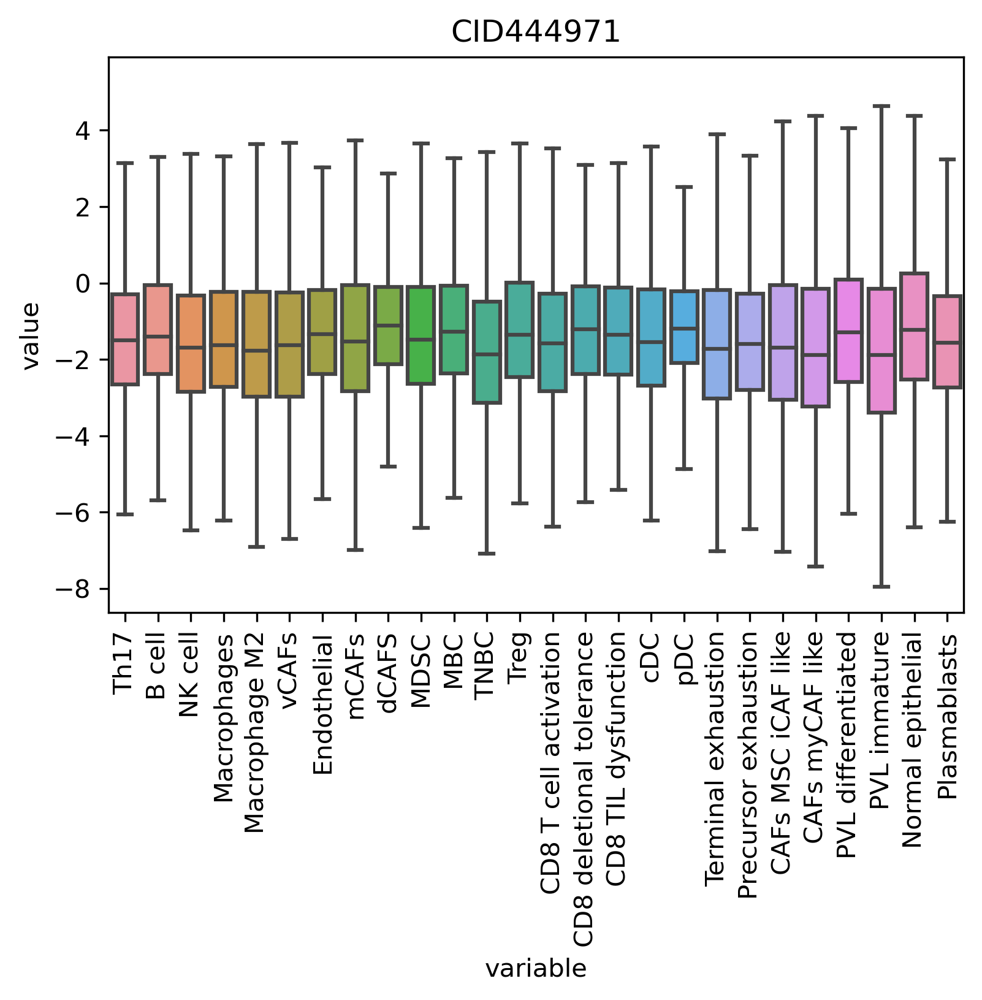

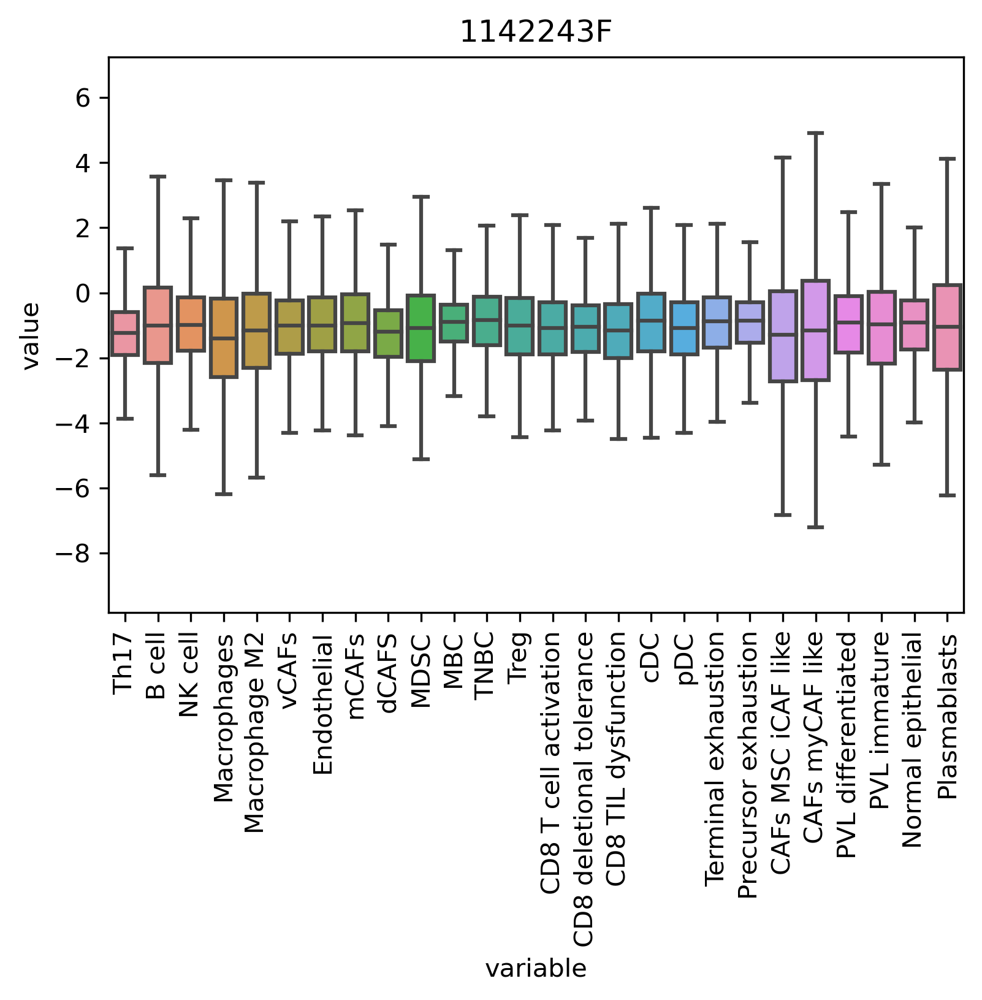

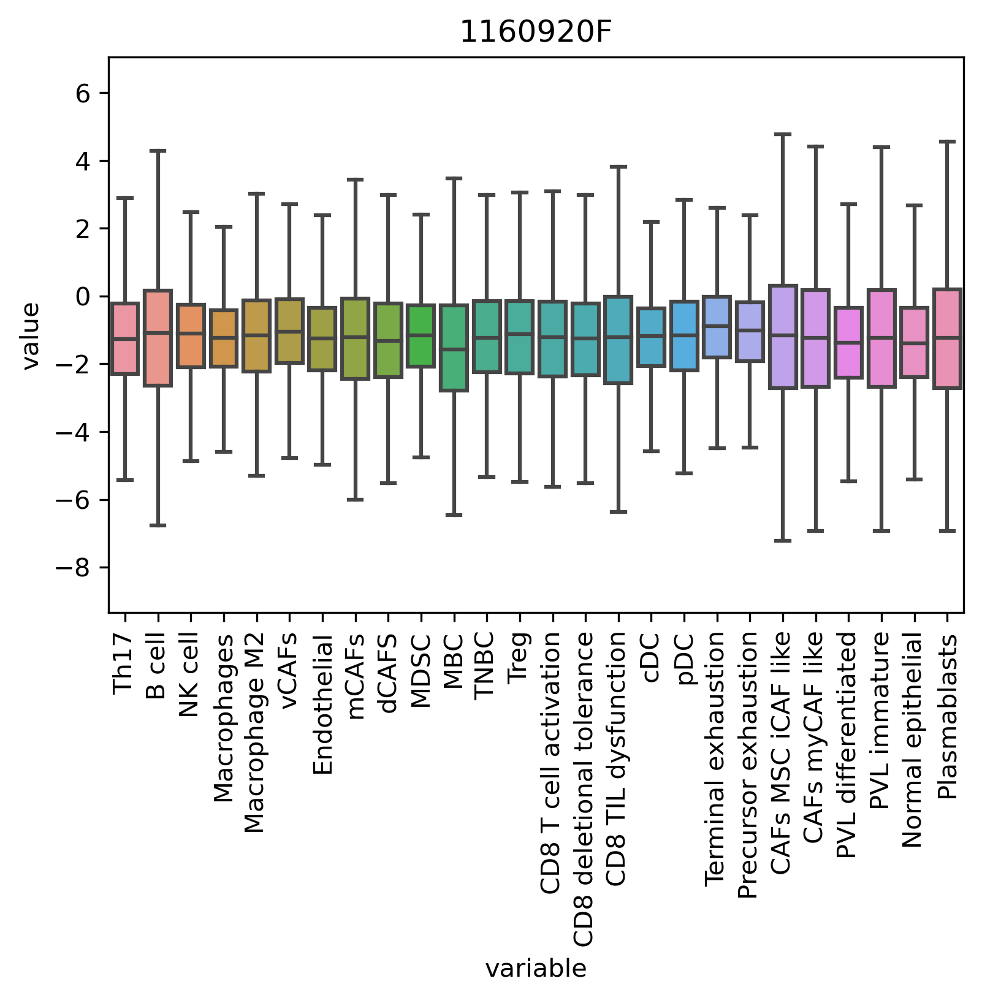

In [192]:
sample_ids = ['MBC_1A',
             'MBC_1B',
             'MBC_2A',
             'MBC_2B',
             'MBC_3A',
             'MBC_3B',
             'MBC_4A',
             'MBC_4B',
             'CID4465',
             'CID444971',
             '1142243F',
             '1160920F'
            ]
patient_ids = ['MBC_1',
             'MBC_1',
             'MBC_2',
             'MBC_2',
             'MBC_3',
             'MBC_3',
             'MBC_4',
             'MBC_4',
             'TNBC_1',
             'TNBC_2',
             'TNBC_3',
             'TNBC_4'
            ]

#patient_ids = ['MBC',
#             'MBC',
#             'MBC',
#             'MBC',
#             'MBC',
#             'MBC',
#             'MBC',
#             'MBC',
#             'TNBC',
#             'TNBC',
#             'TNBC',
#             'TNBC'
#            ]
#sample_ids = ['CID444971']
#map_info = pd.read_csv("../results/02_PoE_factor/"+sample_id+'map_info.csv')
#for sample_id in sample_ids:
for i in range(12):
    factor = pd.read_csv("../results/02_PoE_factor/"+sample_ids[i]+'nb_file.csv',index_col=0)
    factor.index = factor.index+'-'+sample_ids[i]
    
    #factor = (factor.apply(zscore))
    #factor = (factor-factor.min())/(factor.max()-factor.min())
    #factor = (factor.T.apply(zscore)).T
    factor = factor.melt()
    y='value'
    x='variable'
    plt.figure(dpi=300)
    g1=sns.boxplot(data=factor, x=x, y=y,fliersize=0)
    g1.set_xticklabels(g1.get_xticklabels(),rotation=90)
    g1.set_title(sample_ids[i])

    #factor = np.clip(factor, -1, 2)
    
    #factor['sample'] = sample_ids[i]
    #factor['patient'] = patient_ids[i]
    

In [195]:
factor_all = pd.DataFrame()
sample_ids = ['MBC_1A',
             'MBC_1B',
             'MBC_2A',
             'MBC_2B',
             'MBC_3A',
             'MBC_3B',
             'MBC_4A',
             'MBC_4B',
             'CID4465',
             'CID444971',
             '1142243F',
             '1160920F'
            ]
patient_ids = ['MBC_1',
             'MBC_1',
             'MBC_2',
             'MBC_2',
             'MBC_3',
             'MBC_3',
             'MBC_4',
             'MBC_4',
             'TNBC_1',
             'TNBC_2',
             'TNBC_3',
             'TNBC_4'
            ]

#patient_ids = ['MBC',
#             'MBC',
#             'MBC',
#             'MBC',
#             'MBC',
#             'MBC',
#             'MBC',
#             'MBC',
#             'TNBC',
#             'TNBC',
#             'TNBC',
#             'TNBC'
#            ]
#sample_ids = ['CID444971']
#map_info = pd.read_csv("../results/02_PoE_factor/"+sample_id+'map_info.csv')
#for sample_id in sample_ids:
for i in range(12):
    factor = pd.read_csv("../results/02_PoE_factor/"+sample_ids[i]+'nb_file.csv',index_col=0)
    factor.index = factor.index+'-'+sample_ids[i]
    
    #factor = (factor.apply(zscore))
    factor = (factor-factor.min())/(factor.max()-factor.min())
    #factor = (factor.T.apply(zscore)).T
    
    #factor = np.clip(factor, -1, 2)
    
    factor['sample'] = sample_ids[i]
    factor['patient'] = patient_ids[i]
    factor_all = factor_all.append(factor)
    

<ipython-input-196-7de8e1764c1a>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(dpi=300)


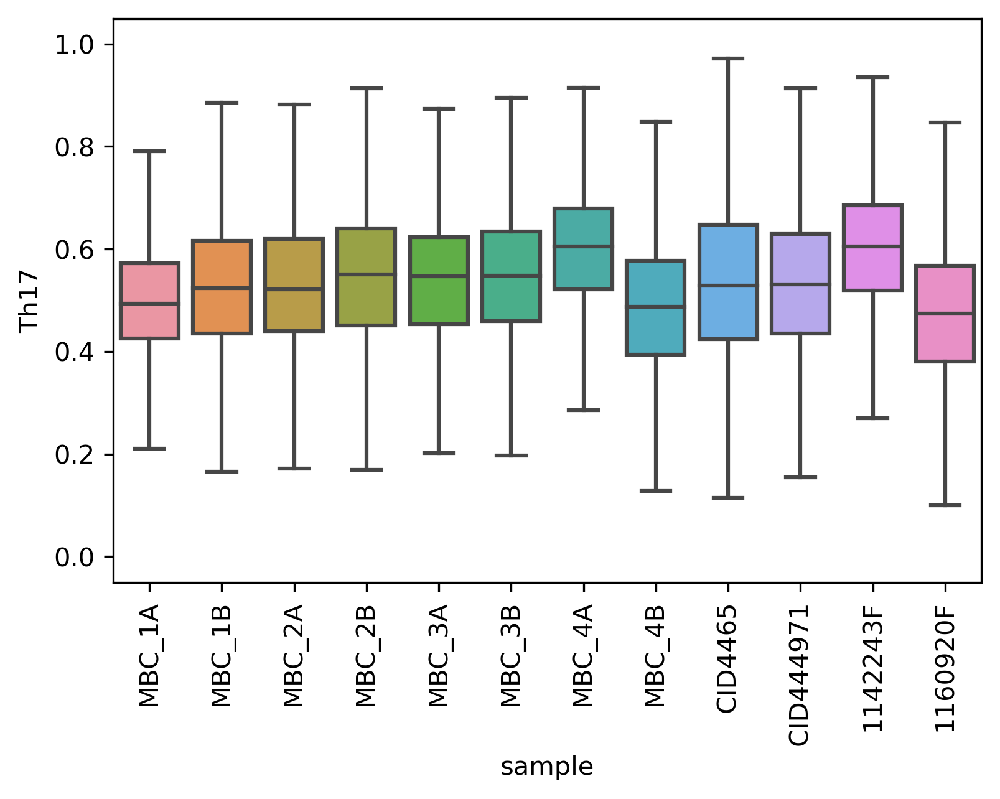

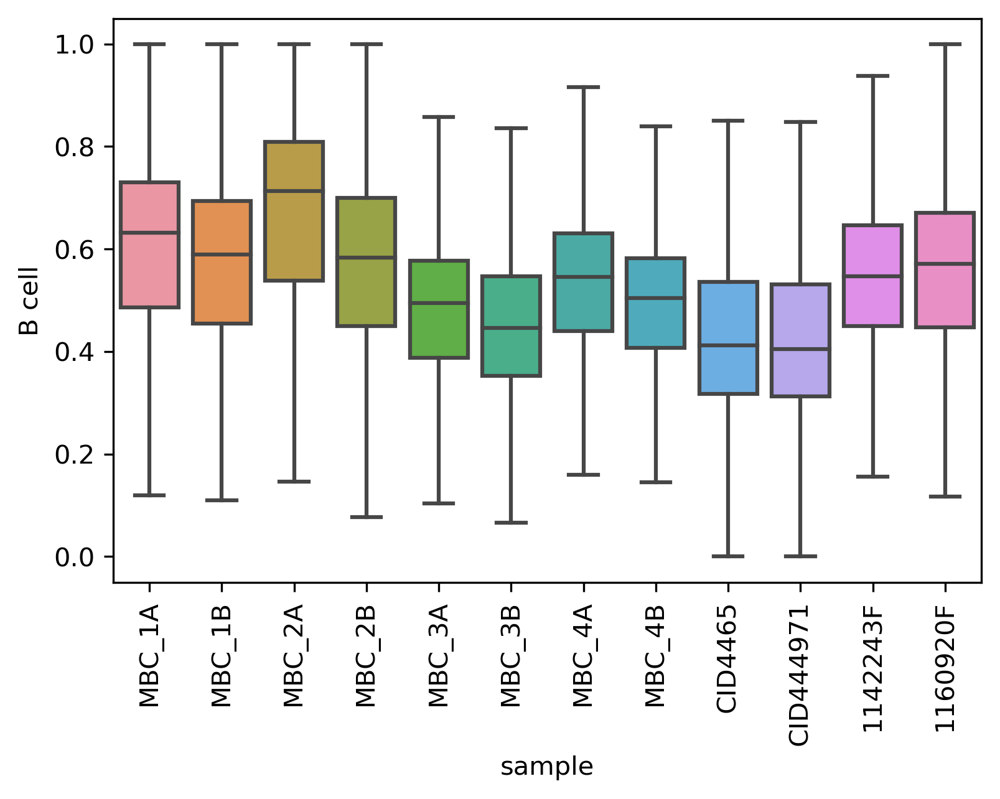

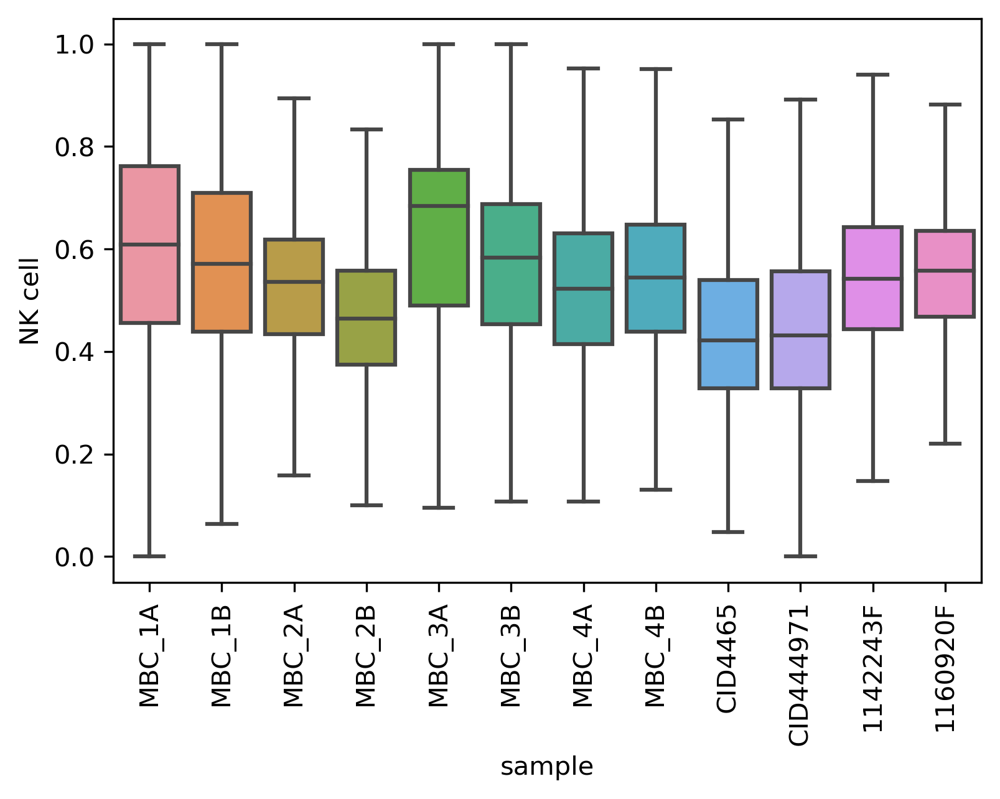

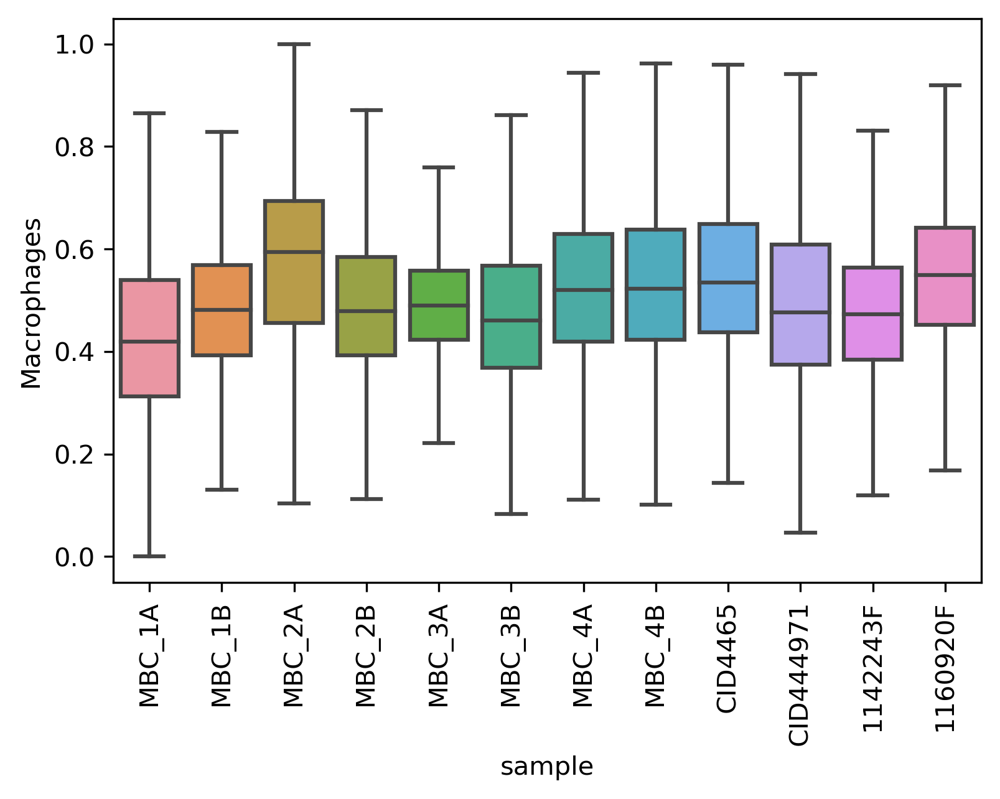

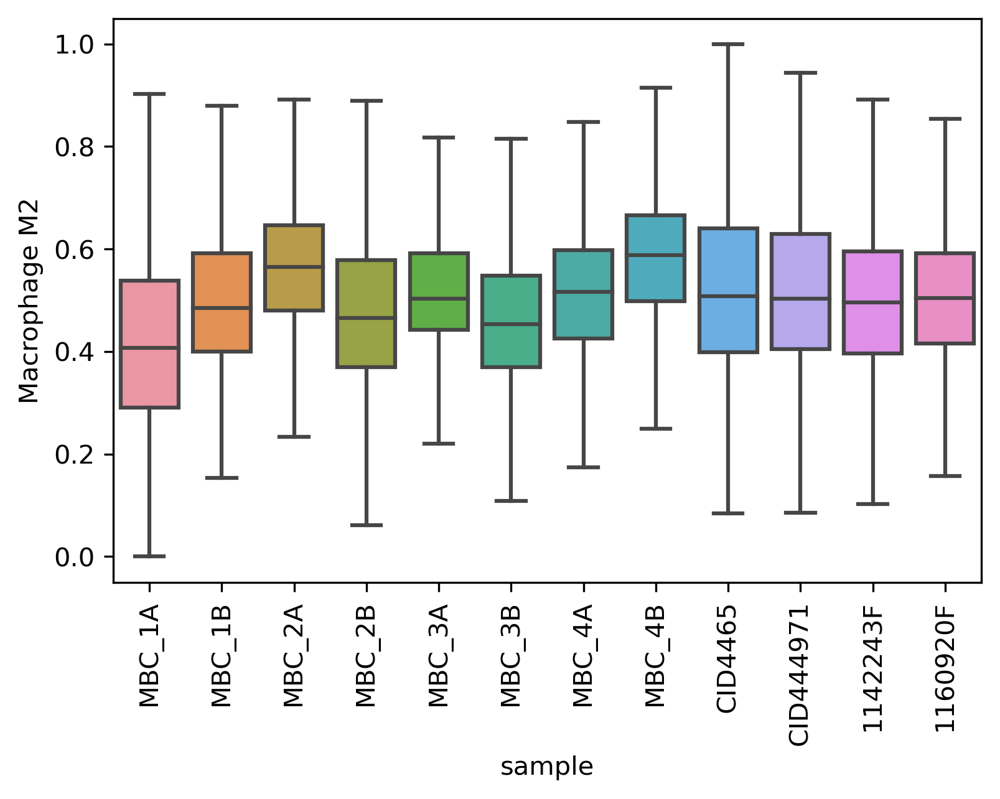

...

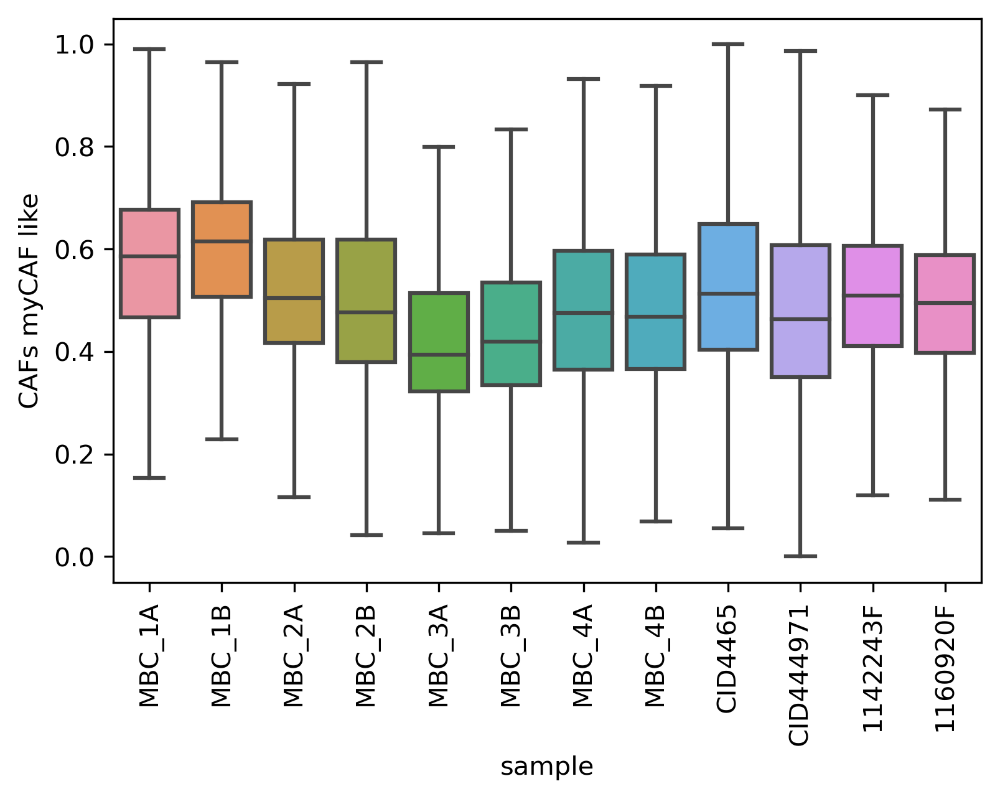

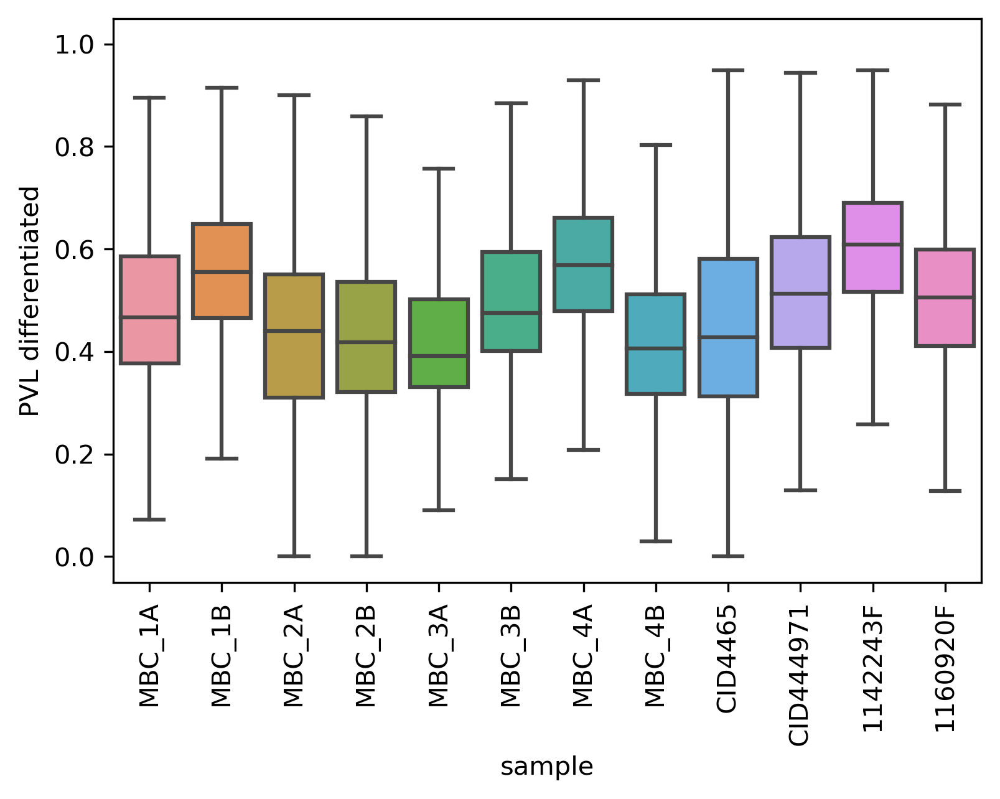

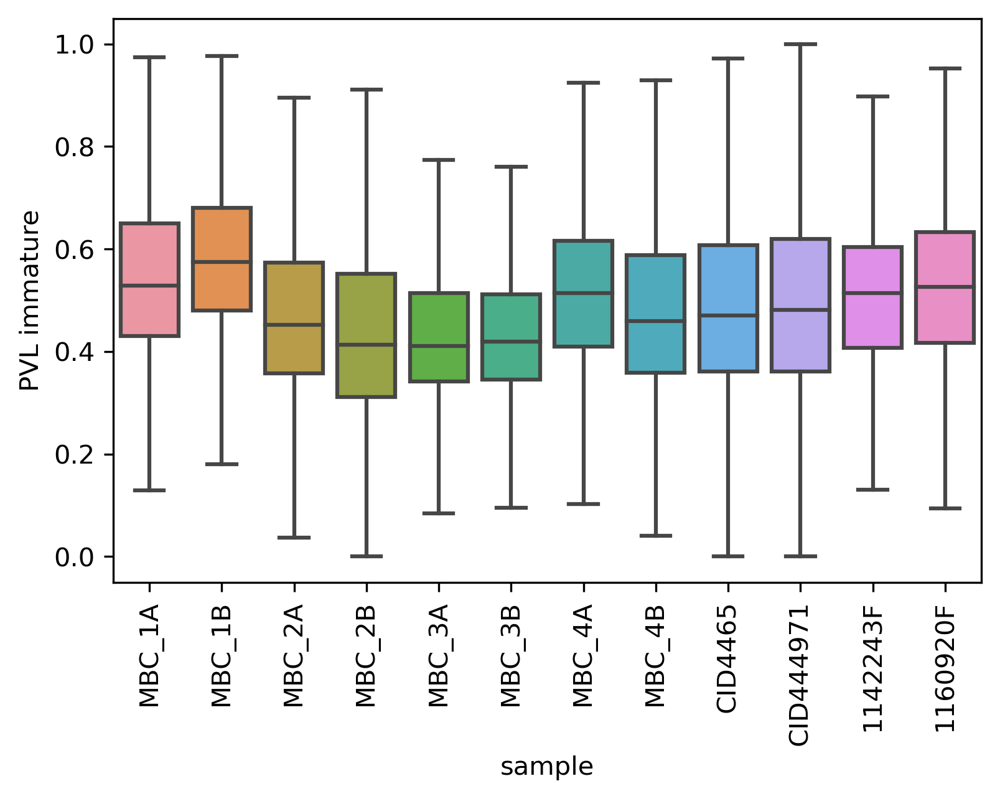

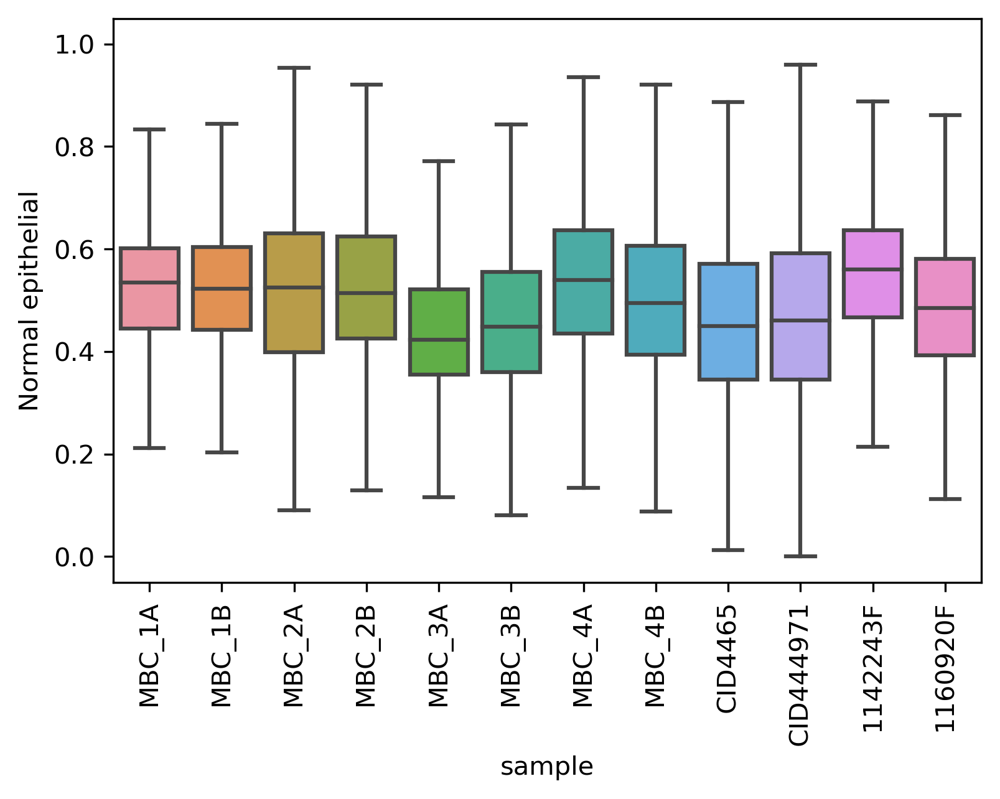

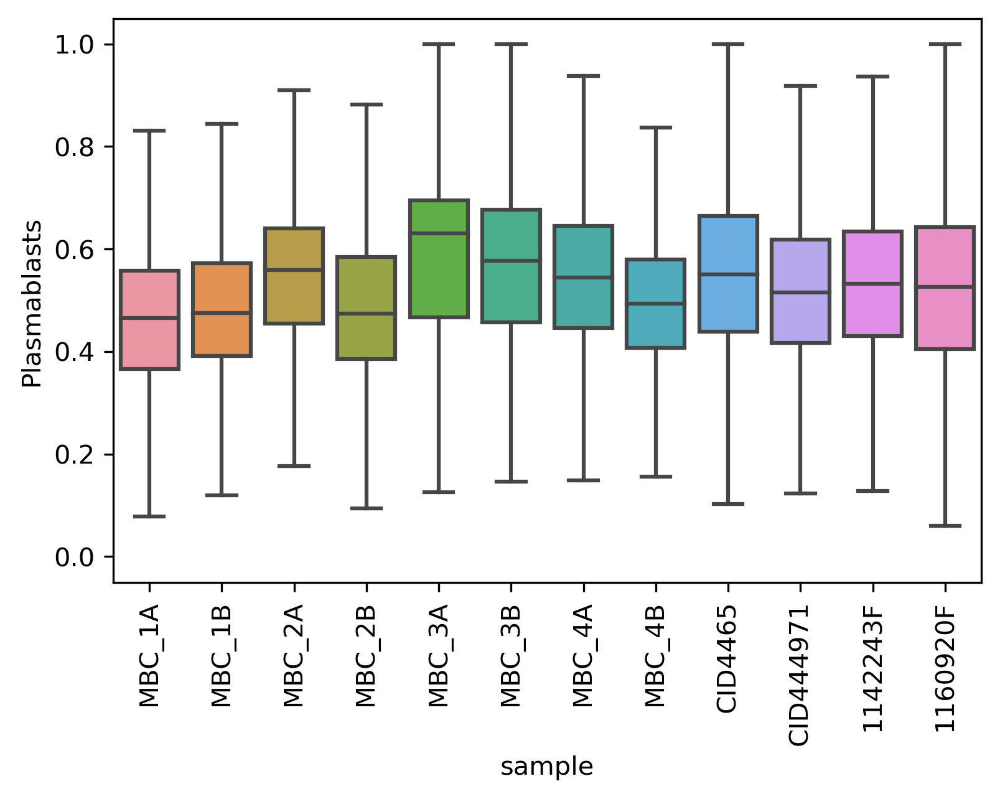

In [196]:
for i in range(26):
    y=factor_all.columns[i]
    x='sample'
    plt.figure(dpi=300)
    g1=sns.boxplot(data=factor_all, x=x, y=y,fliersize=0)
    g1.set_xticklabels(g1.get_xticklabels(),rotation=90)

In [197]:
slisa_biclust = pd.read_csv('~/Spatial_project/results/03_hubs/PoE_alltumors_bicluster.csv',index_col=0)

In [247]:
row_order_df = pd.read_csv('../results/03_hubs/'+'PoE_alltumors_bicluster_res_row_orders_individual.csv')

In [248]:
row_order_df['sample']=[t.split('-')[2] for t in row_order_df['id']]

In [249]:
row_order_df['count']=1

In [250]:
row_order_df

,id,id.1,cluster,sample,count
0,AAACACCAATAACTGC-1-MBC_1A,AAACACCAATAACTGC-1-MBC_1A,7,MBC_1A,1
1,AAACAGCTTTCAGAAG-1-MBC_1A,AAACAGCTTTCAGAAG-1-MBC_1A,10,MBC_1A,1
2,AAACAGGGTCTATATT-1-MBC_1A,AAACAGGGTCTATATT-1-MBC_1A,4,MBC_1A,1
3,AAACATGGTGAGAGGA-1-MBC_1A,AAACATGGTGAGAGGA-1-MBC_1A,8,MBC_1A,1
4,AAACCGGGTAGGTACC-1-MBC_1A,AAACCGGGTAGGTACC-1-MBC_1A,10,MBC_1A,1
...,...,...,...,...,...
33953,AGAGTCTTAATGAAAG-1-1160920F,AGAGTCTTAATGAAAG-1-1160920F,9,1160920F,1
33954,GAACGTTTGTATCCAC-1-1160920F,GAACGTTTGTATCCAC-1-1160920F,7,1160920F,1
33955,ATTGAATTCCCTGTAG-1-1160920F,ATTGAATTCCCTGTAG-1-1160920F,1,1160920F,1
33956,TACCTCACCAATTGTA-1-1160920F,TACCTCACCAATTGTA-1-1160920F,3,1160920F,1


In [251]:
agg_tips = row_order_df.groupby(['sample', 'cluster'])['count'].sum().unstack().fillna(0)
agg_tips

cluster,0,1,2,3,4,5,6,7,8,9,10
sample,,,,,,,,,,,
1142243F,700.0,259.0,22.0,397.0,7.0,171.0,483.0,1131.0,445.0,810.0,359.0
1160920F,1125.0,60.0,38.0,850.0,143.0,326.0,248.0,797.0,385.0,415.0,508.0
CID444971,167.0,36.0,15.0,154.0,76.0,192.0,55.0,102.0,118.0,137.0,110.0
CID4465,136.0,59.0,9.0,127.0,81.0,176.0,123.0,102.0,107.0,163.0,128.0
MBC_1A,17.0,55.0,26.0,31.0,428.0,844.0,30.0,421.0,143.0,29.0,430.0
MBC_1B,47.0,163.0,49.0,43.0,583.0,790.0,72.0,314.0,74.0,33.0,383.0
MBC_2A,523.0,687.0,0.0,55.0,2.0,21.0,449.0,577.0,150.0,754.0,26.0
MBC_2B,645.0,512.0,31.0,202.0,88.0,208.0,249.0,470.0,203.0,413.0,181.0
MBC_3A,4.0,177.0,510.0,5.0,3.0,8.0,170.0,358.0,950.0,22.0,77.0


In [252]:
med_lib = (agg_tips.sum(axis=1).median())

In [253]:
indx = np.array(med_lib/agg_tips.sum(axis=1))

In [254]:
indx.shape

(12,)

In [255]:
for i in range(indx.shape[0]):
    agg_tips.iloc[i,:] = agg_tips.iloc[i,:] * indx[i]

In [256]:
agg_tips

cluster,0,1,2,3,4,5,6,7,8,9,10
sample,,,,,,,,,,,
1142243F,413.357023,152.942099,12.991221,234.432483,4.133570,100.977216,285.216346,667.866848,262.776965,478.313127,211.993102
1160920F,649.259448,34.627171,21.930541,490.551583,82.528090,188.140960,143.125638,459.964249,222.191011,239.504597,293.176711
CID444971,406.002582,87.521515,36.467298,374.397590,184.767642,466.781411,133.713425,247.977625,286.876076,333.067986,267.426850
CID4465,317.258464,137.634187,20.995045,296.263419,188.955409,410.569777,286.932287,237.943848,249.607762,380.243600,298.596201
MBC_1A,19.570090,63.314996,29.930725,35.686634,492.705786,971.597392,34.535452,484.647514,164.618989,33.384271,495.008150
MBC_1B,52.048216,180.507644,54.263034,47.618581,645.619365,874.852999,79.733438,347.726382,81.948256,36.544492,424.137593
MBC_2A,455.448520,598.266030,0.000000,47.896116,1.741677,18.287608,391.006473,502.473798,130.625771,656.612207,22.641800
MBC_2B,569.058401,451.717676,27.350094,178.216740,77.638976,183.510306,219.683011,414.662711,179.099001,364.373829,159.689257
MBC_3A,4.947461,218.925131,630.801226,6.184326,3.710595,9.894921,210.267075,442.797723,1175.021891,27.211033,95.238616


<Figure size 3000x2000 with 0 Axes>

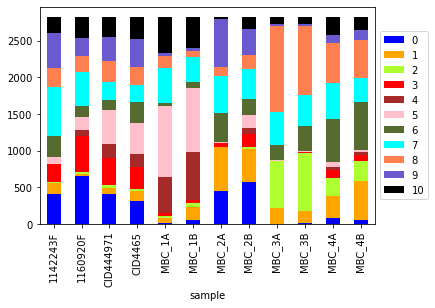

In [257]:
plt.figure(dpi=500)
agg_tips.plot(kind='bar', stacked=True)
plt.legend(loc='center left', bbox_to_anchor=(1.0, 0.5))

Text(0, 0.5, '')

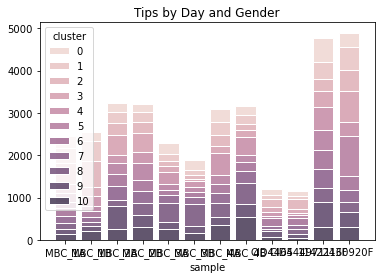

In [350]:
import seaborn as sns

ax = sns.histplot(
    row_order_df,
    x='sample',
    # Use the value variable here to turn histogram counts into weighted
    # values.
    #weights='tip',
    hue='cluster',
    multiple='stack',
    #palette=['#24b1d1', '#ae24d1'],
    # Add white borders to the bars.
    edgecolor='white',
    # Shrink the bars a bit so they don't touch.
    shrink=0.8
)

ax.set_title('Tips by Day and Gender')
# Remove 'Count' ylabel.
ax.set_ylabel(None)

In [326]:
row_order_df['id']

0          AAACACCAATAACTGC-1-MBC_1A
1          AAACAGCTTTCAGAAG-1-MBC_1A
2          AAACAGGGTCTATATT-1-MBC_1A
3          AAACATGGTGAGAGGA-1-MBC_1A
4          AAACCGGGTAGGTACC-1-MBC_1A
                    ...             
33953    AGAGTCTTAATGAAAG-1-1160920F
33954    GAACGTTTGTATCCAC-1-1160920F
33955    ATTGAATTCCCTGTAG-1-1160920F
33956    TACCTCACCAATTGTA-1-1160920F
33957    AGTCGAATTAGCGTAA-1-1160920F
Name: id, Length: 33958, dtype: object

In [328]:
row_order_df['sample']=[i.split('-')[2] for i in row_order_df['id']]

In [ ]:
y=factor_all.columns[i]
x='sample'
plt.figure(dpi=300)
g1=sns.bar(data=factor_all, x=x, y=y,fliersize=0)

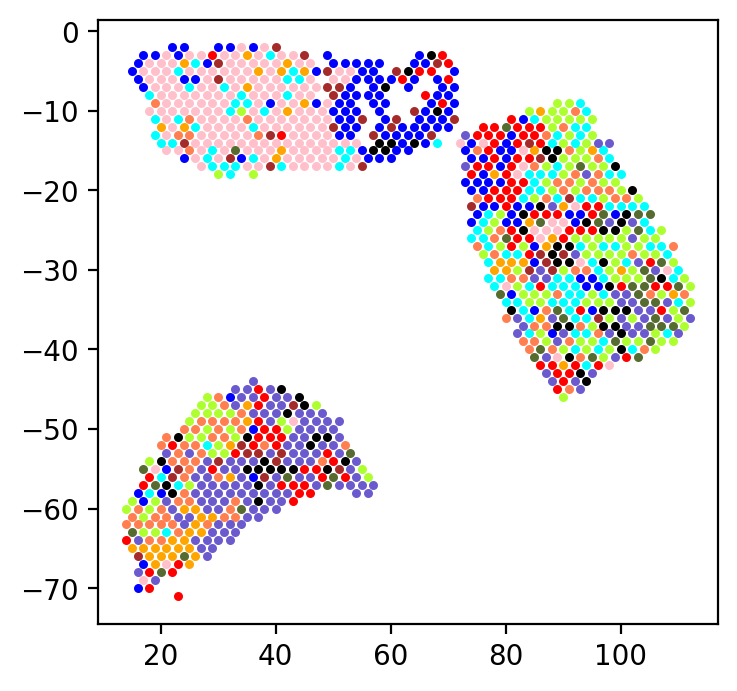

In [224]:
# load all expression data  [spot x gene]
data_path = 'data'
sample_ids = ['MBC_1A',
             'MBC_1B',
             'MBC_2A',
             'MBC_2B',
             'MBC_3A',
             'MBC_3B',
             'MBC_4A',
             'MBC_4B',
             'CID4465',
             'CID444971',
             '1142243F',
             '1160920F'
            ]
sample_ids = ['CID444971']
for sample_id in sample_ids:
    data_path = '../data'
    if sample_id.startswith('MBC'):

        adata_sample = sc.read_visium(path=os.path.join(data_path, sample_id),library_id =  sample_id)
        adata_sample.var_names_make_unique()
        adata_sample.obs['sample']=sample_id
        adata_sample.obs_names  = adata_sample.obs_names+'-'+sample_id
    else:
        adata_sample = sc.read_h5ad(os.path.join(data_path,sample_id, sample_id+'.h5ad'))
        adata_sample.var_names_make_unique()
        adata_sample.obs['sample']=sample_id
        adata_sample.obs_names  = adata_sample.obs_names+'-'+sample_id
        
    cluster_id = pd.DataFrame((np.zeros(len(adata_sample.obs_names))*(-1)).astype(int),columns=['clusters'],index=adata_sample.obs_names)
    
    col_order_df = pd.read_csv('../results/03_hubs/'+'RNA_alltumors_bicluster_res_col_orders_individual.csv')
    row_order_df = pd.read_csv('../results/03_hubs/'+'RNA_alltumors_bicluster_res_row_orders_individual.csv')
    
    map_info = pd.read_csv("../results/02_PoE_factor/"+sample_id+'map_info.csv',index_col=0)
    
    for i in adata_sample.obs_names:
        if i in np.array(row_order_df.loc[:,'id']):
            cluster_id.loc[i,'clusters']= (row_order_df.loc[np.where(row_order_df['id']==i)[0][0],'cluster']).astype(object)
    adata_sample.obs['hub'] =  cluster_id
    
    
    
    fig,axs=plt.subplots(1,1,figsize=(4,4),dpi=200)

    ax=axs
    for i in range(11):
        all_loc = np.array(map_info.loc[cluster_id[cluster_id.clusters==i].index,:].loc[:,['array_col','array_row']])
        #all_spot = np.array(row_order_df[row_order_df.cluster==i].loc[:,'cluster'])
        ax.scatter(all_loc[:,0],-all_loc[:,1],s=5)
    

In [ ]:
# Need to use precise font names in rcParams; I found my fonts with
#>>> import matplotlib.font_manager
#>>> [f.name for f in matplotlib.font_manager.fontManager.ttflist]

rcParams['mathtext.fontset'] = 'custom'
rcParams['mathtext.it'] = 'Arial:italic'
rcParams['mathtext.rm'] = 'Arial'


rcParams['font.family'] = 'Arial'
rcParams['font.size'] = 8

order = ['QR19', 'QR23', 'QR20','QR27','Q2','Q1']
my_color_map=['#F25E5E','#F25E5E','#0396A6','#0396A6','#F2B035','#F2B035']
x='VOname'
y='alpha'
sns.set_theme()
sns.set_theme(style="ticks", font_scale=1.5)


boxprops = {'edgecolor': 'k', 'linewidth': 2, 'facecolor': 'w'}
lineprops = {'color': 'k', 'linewidth': 2}

#g2=sns.catplot(data=size_list, x=x, y=y, 
#            kind="swarm",palette='viridis', 
#            order = order)

g2=sns.catplot(data=Gdegreesalpha, x=x, y=y, 
            kind="swarm", palette=my_color_map,
            order = order)

g1=sns.boxplot(data=Gdegreesalpha, x=x, y=y, order = order,fliersize=0,palette=my_color_map)
#g1=sns.barplot(data=Gdegreesalpha, x=x, y=y, order = order,palette=my_color_map)

for i,artist in enumerate(g1.artists):
    # Set the linecolor on the artist to the facecolor, and set the facecolor to None
    col = artist.get_facecolor()
    #artist.set_edgecolor(col)
    artist.set_facecolor('None')

    # Each box has 6 associated Line2D objects (to make the whiskers, fliers, etc.)
    # Loop over them here, and use the same colour as above
    for j in range(i*6,i*6+6):
        line = g1.lines[j]
        #line.set_color(col)
        #line.set_mfc(col)
        #line.set_mec(col)

add_stat_annotation(g1,data=Gdegreesalpha, x=x, y=y, order=order,
                    box_pairs=[("QR19", "QR23"),("QR20", "QR27"),("Q2","Q1")],
                    test='t-test_ind', text_format='simple', loc='inside', verbose=2);

g2.set_axis_labels("Vessel Organoid", "",family='Arial')
g2.fig.set_size_inches(7, 5)
g2.set_xticklabels(['WT1', 'Del1','WT2','Del2','WT3','Del3'],family='Arial')
g2.despine(trim=True)

g2.savefig(os.path.join(fig_save_path,'Fig3B.pdf'),dpi=1000)

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Vari

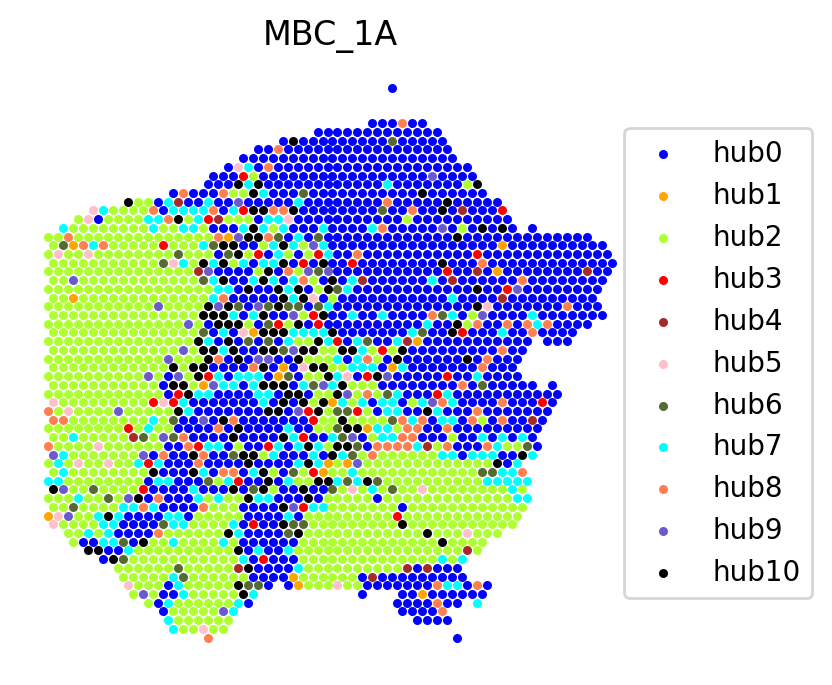

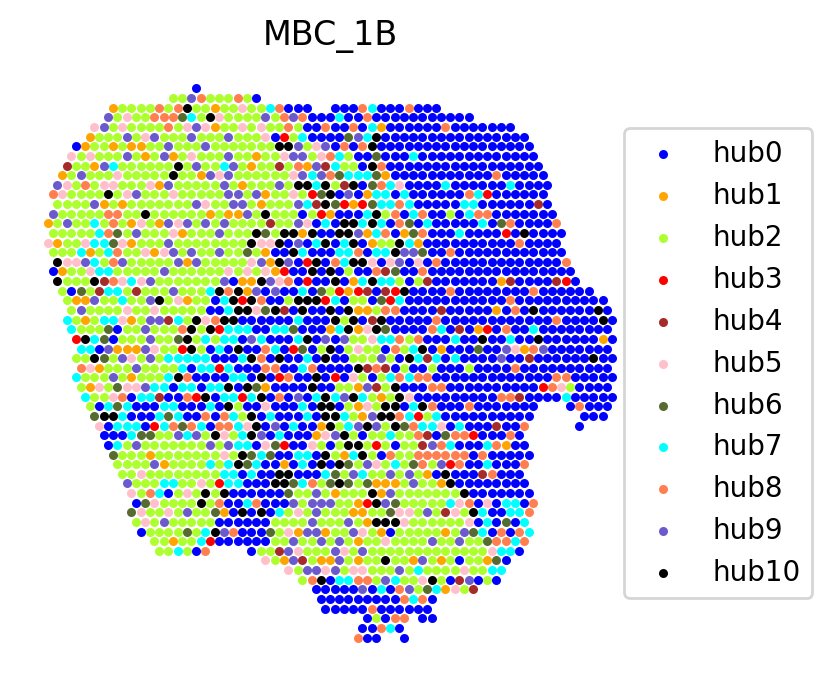

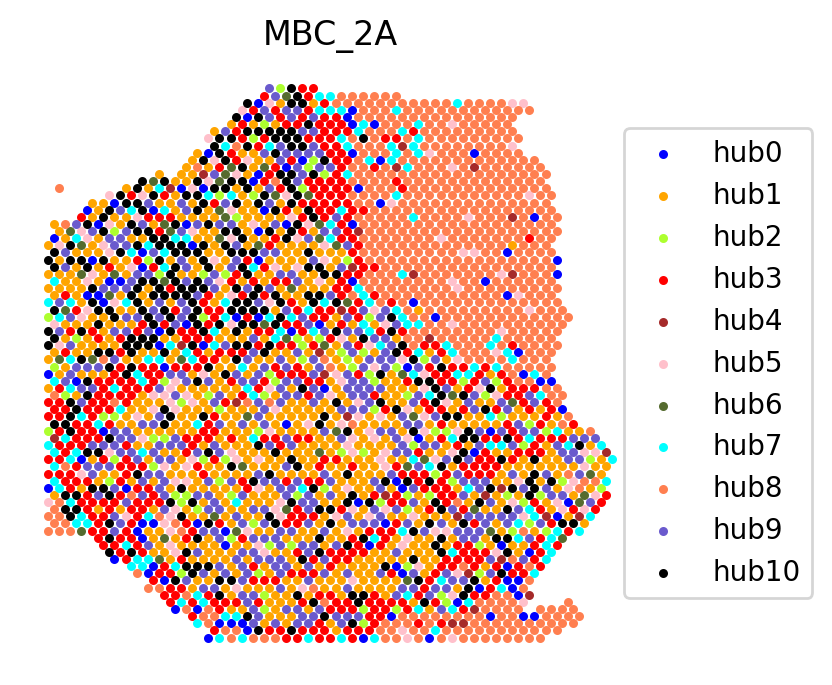

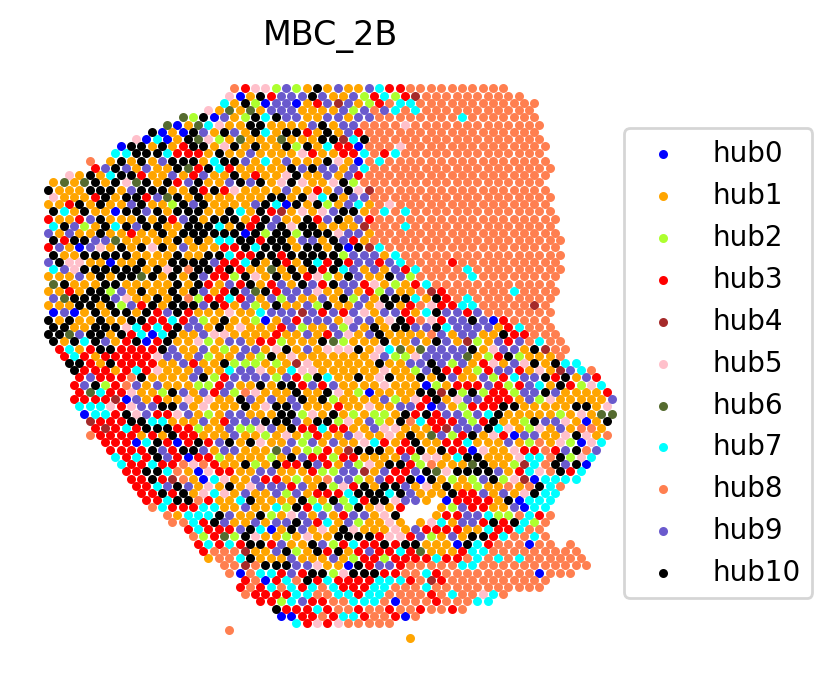

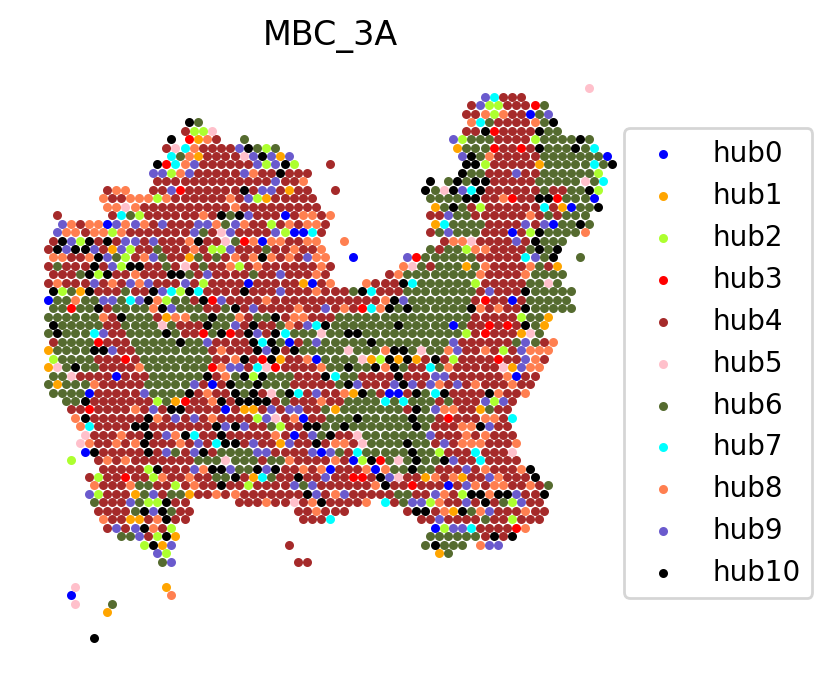

...

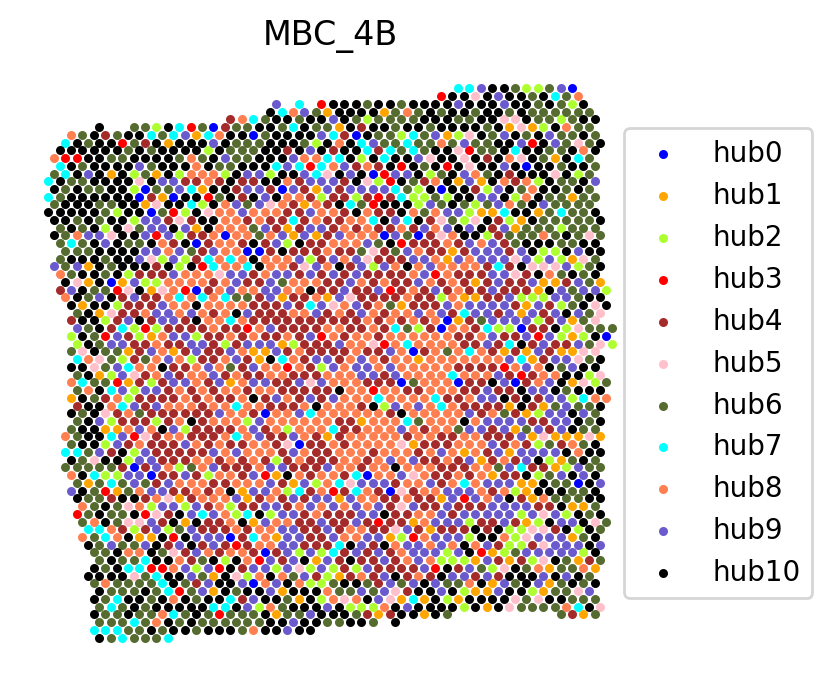

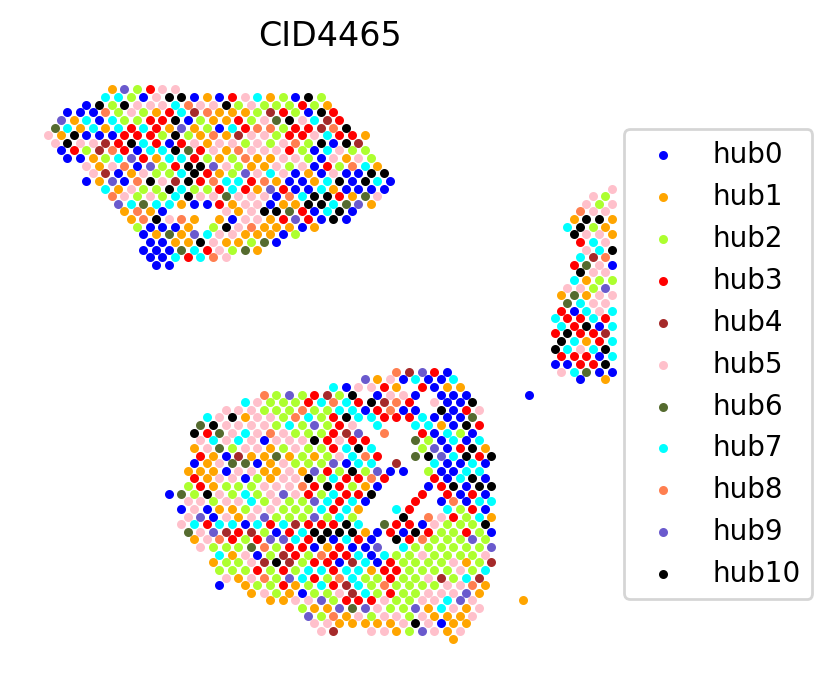

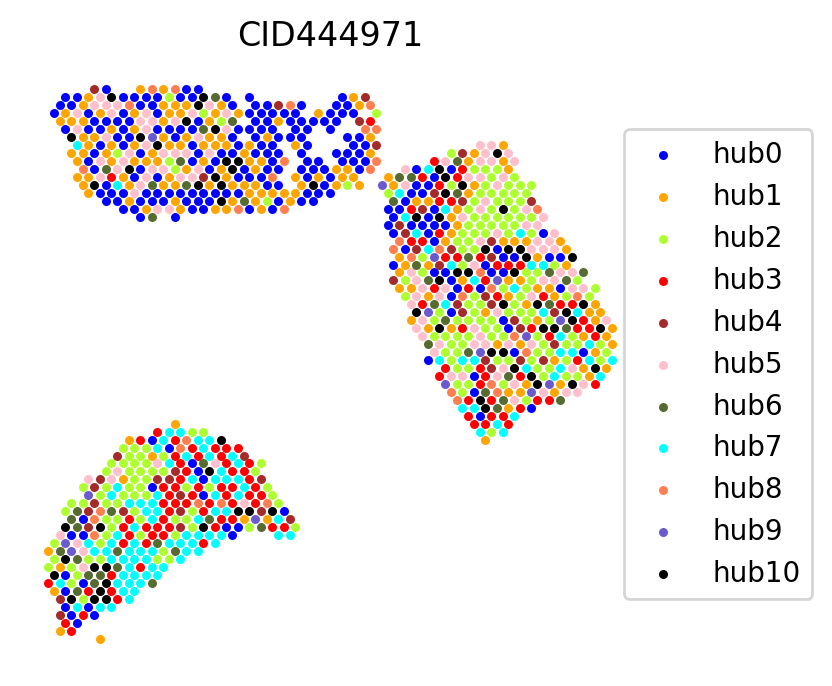

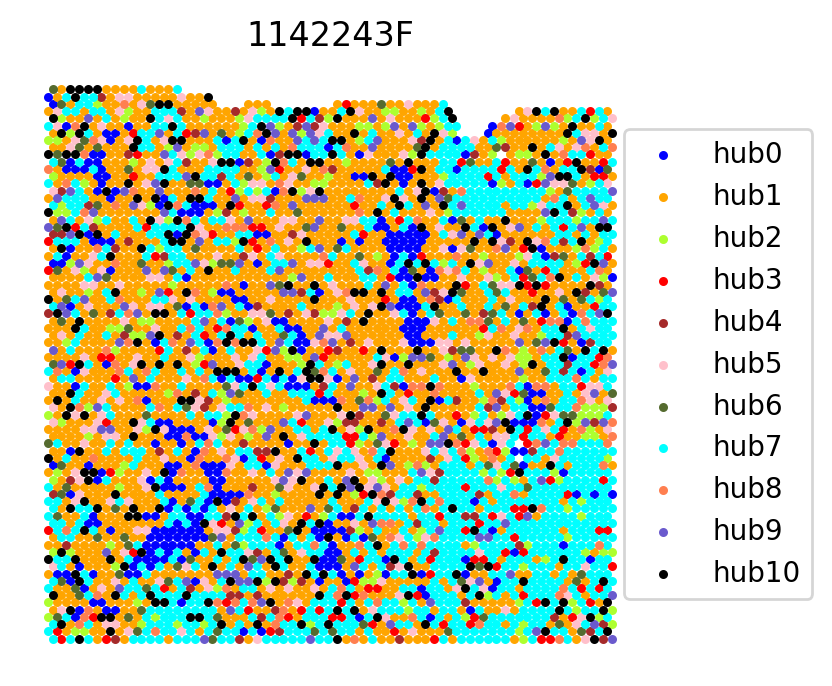

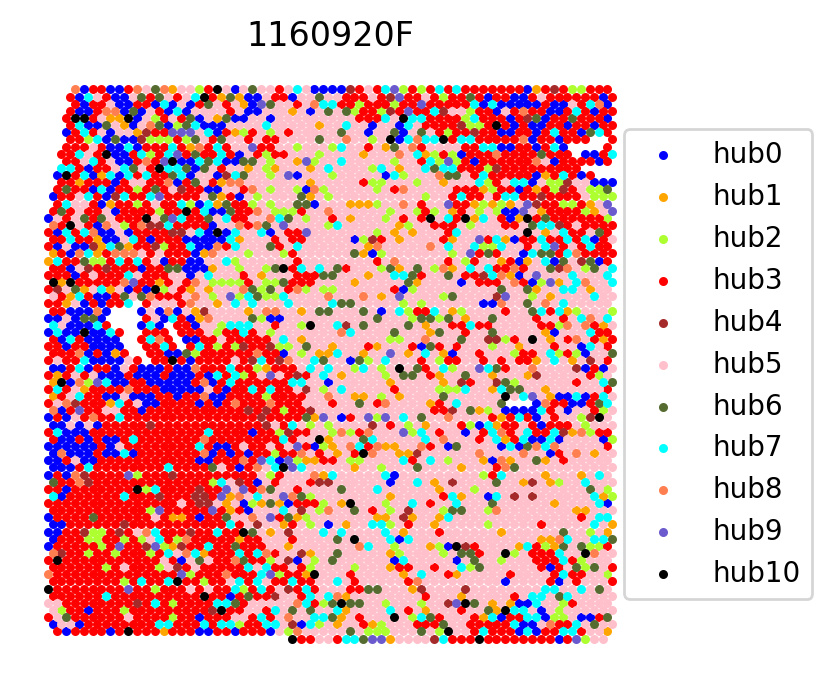

In [321]:
# load all expression data  [spot x gene]
data_path = 'data'
sample_ids = ['MBC_1A',
             'MBC_1B',
             'MBC_2A',
             'MBC_2B',
             'MBC_3A',
             'MBC_3B',
             'MBC_4A',
             'MBC_4B',
             'CID4465',
             'CID444971',
             '1142243F',
             '1160920F'
            ]

for sample_id in sample_ids:
    data_path = '../data'
    if sample_id.startswith('MBC'):

        adata_sample = sc.read_visium(path=os.path.join(data_path, sample_id),library_id =  sample_id)
        adata_sample.var_names_make_unique()
        adata_sample.obs['sample']=sample_id
        adata_sample.obs_names  = adata_sample.obs_names+'-'+sample_id
    else:
        adata_sample = sc.read_h5ad(os.path.join(data_path,sample_id, sample_id+'.h5ad'))
        adata_sample.var_names_make_unique()
        adata_sample.obs['sample']=sample_id
        adata_sample.obs_names  = adata_sample.obs_names+'-'+sample_id
        
    cluster_id = pd.DataFrame((np.zeros(len(adata_sample.obs_names))*(-1)).astype(int),columns=['clusters'],index=adata_sample.obs_names)
    
    col_order_df = pd.read_csv('../results/03_hubs_0105/'+'PoE_alltumors_bicluster_res_col_orders_individual.csv')
    row_order_df = pd.read_csv('../results/03_hubs_0105/'+'PoE_alltumors_bicluster_res_row_orders_individual.csv')
    
    map_info = pd.read_csv("../results/02_PoE_factor_0105/"+sample_id+'map_info.csv',index_col=0)
    
    for i in adata_sample.obs_names:
        if i in np.array(row_order_df.loc[:,'id']):
            cluster_id.loc[i,'clusters']= (row_order_df.loc[np.where(row_order_df['id']==i)[0][0],'cluster']).astype(object)
    adata_sample.obs['hub'] =  cluster_id
    
    
    
    fig,axs=plt.subplots(1,1,figsize=(4,4),dpi=200)

    ax=axs
    for i in range(11):
        all_loc = np.array(map_info.loc[cluster_id[cluster_id.clusters==i].index,:].loc[:,['array_col','array_row']])
        #all_spot = np.array(row_order_df[row_order_df.cluster==i].loc[:,'cluster'])
        ax.scatter(all_loc[:,0],-all_loc[:,1],s=5)
    
    ax.set_aspect("auto")
    ax.legend(['hub0','hub1','hub2','hub3','hub4','hub5','hub6','hub7','hub8','hub9','hub10'],loc='right',bbox_to_anchor=(0,0, 1.3, 1.))
    plt.grid(False),
    plt.axis('off')
    plt.title(sample_id)

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Vari

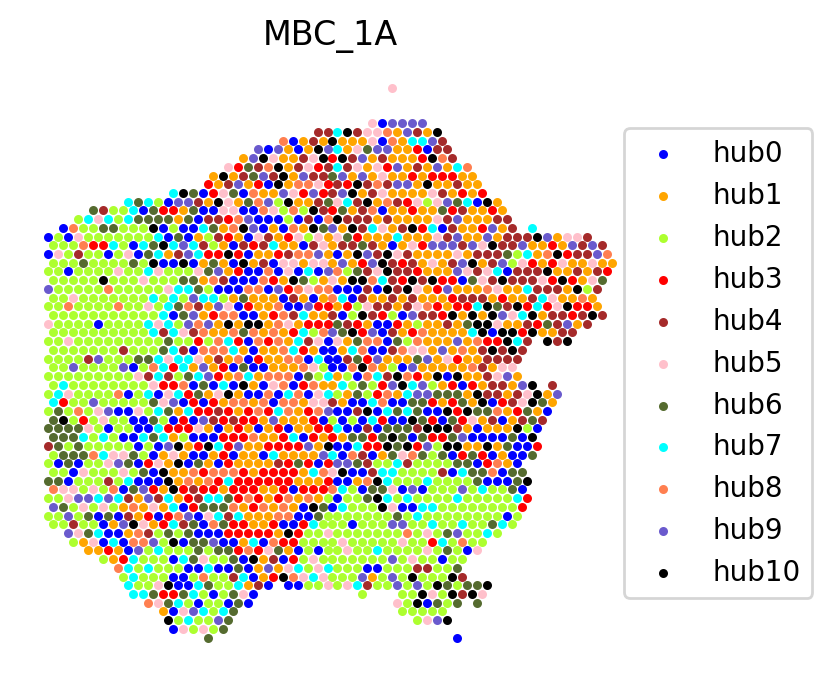

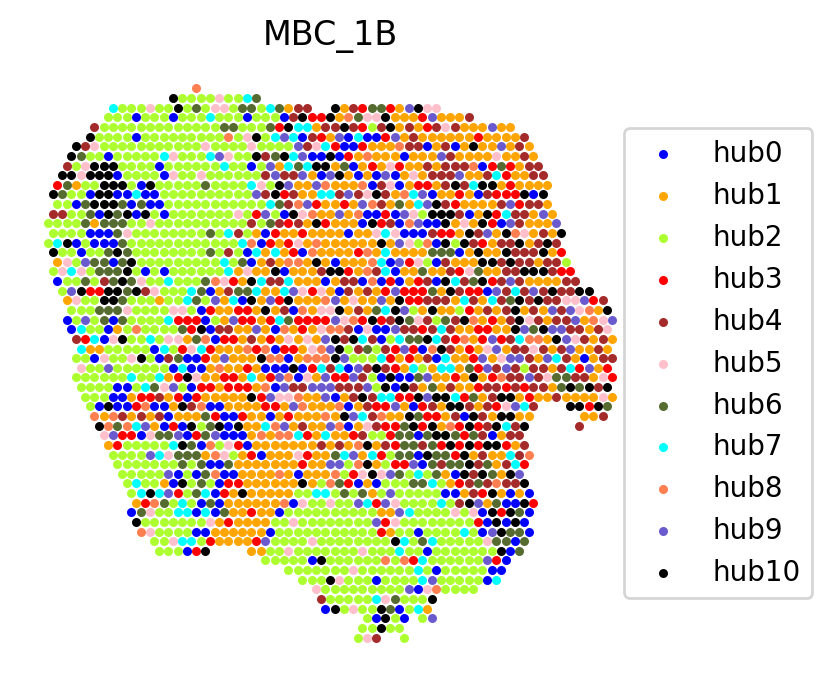

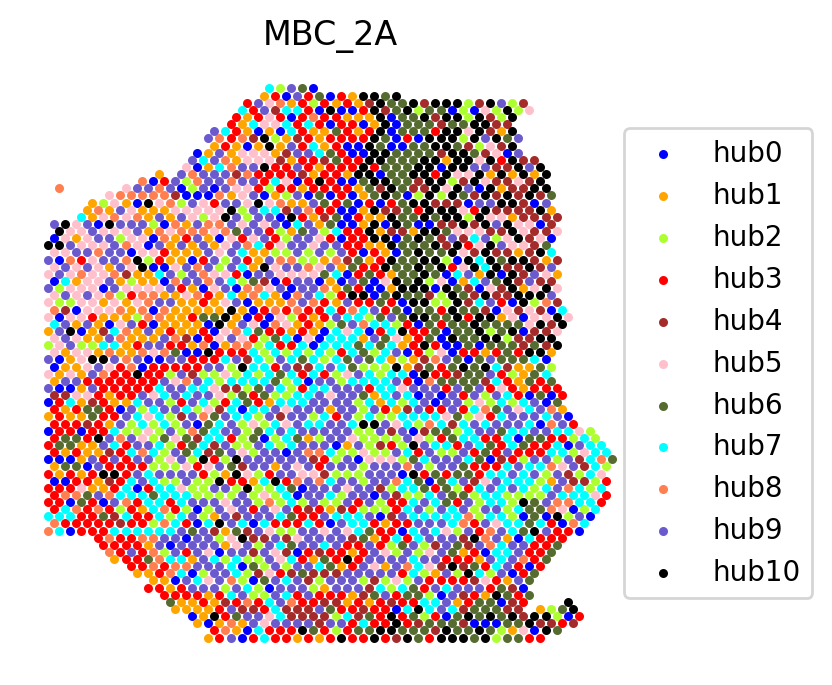

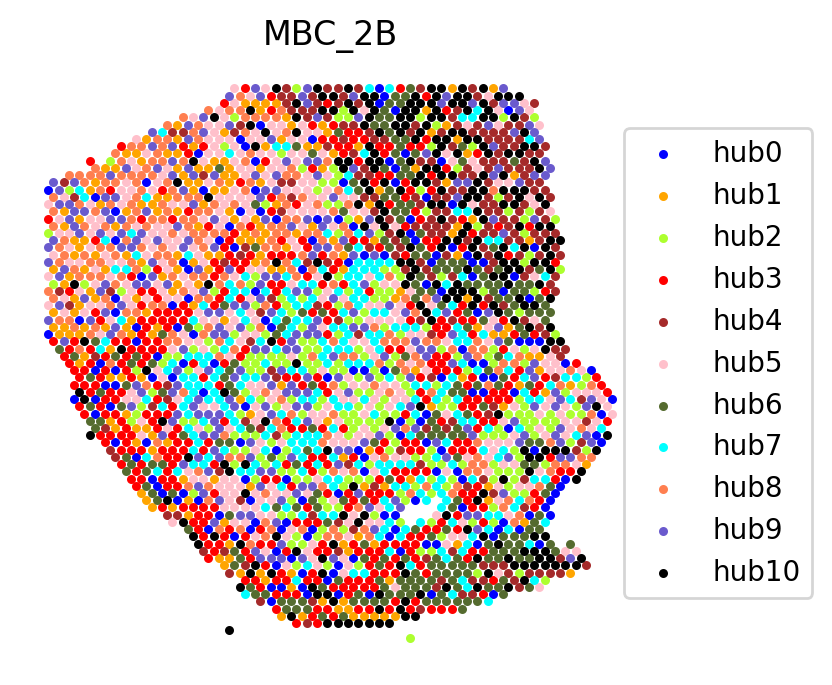

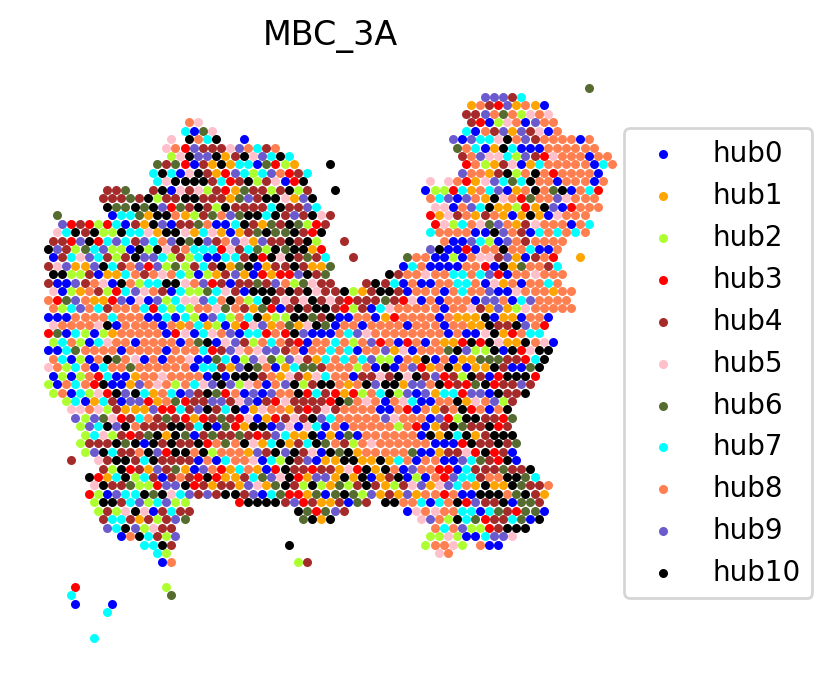

...

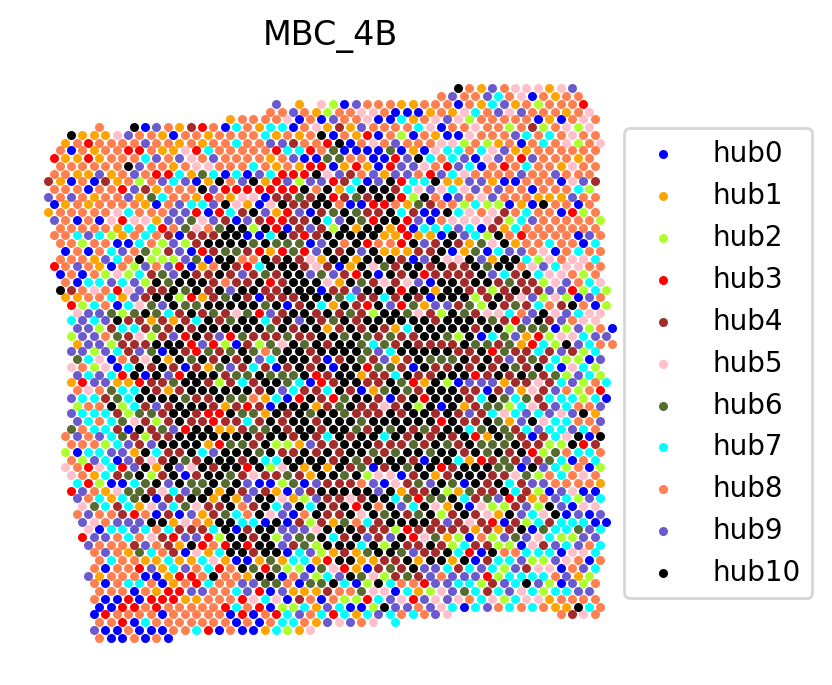

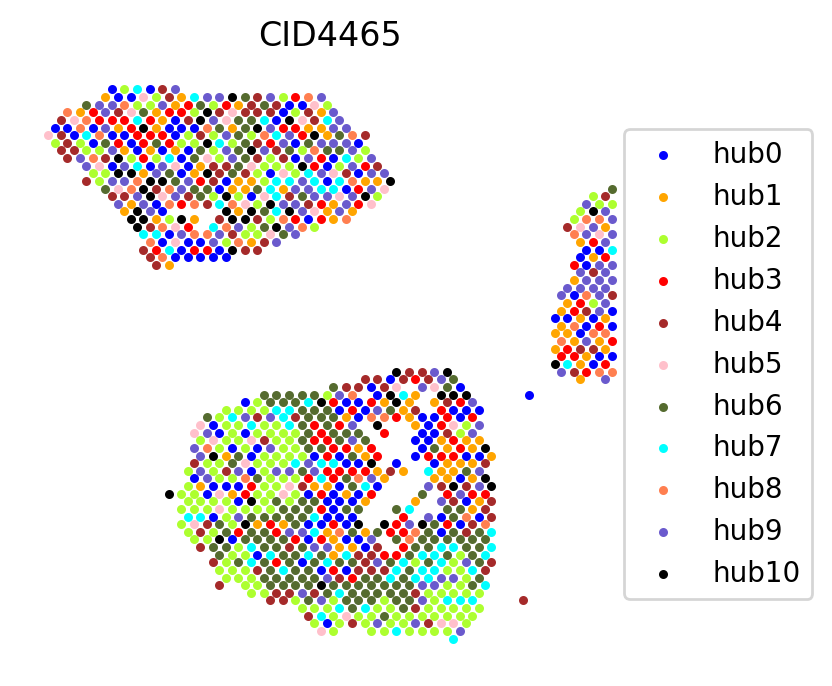

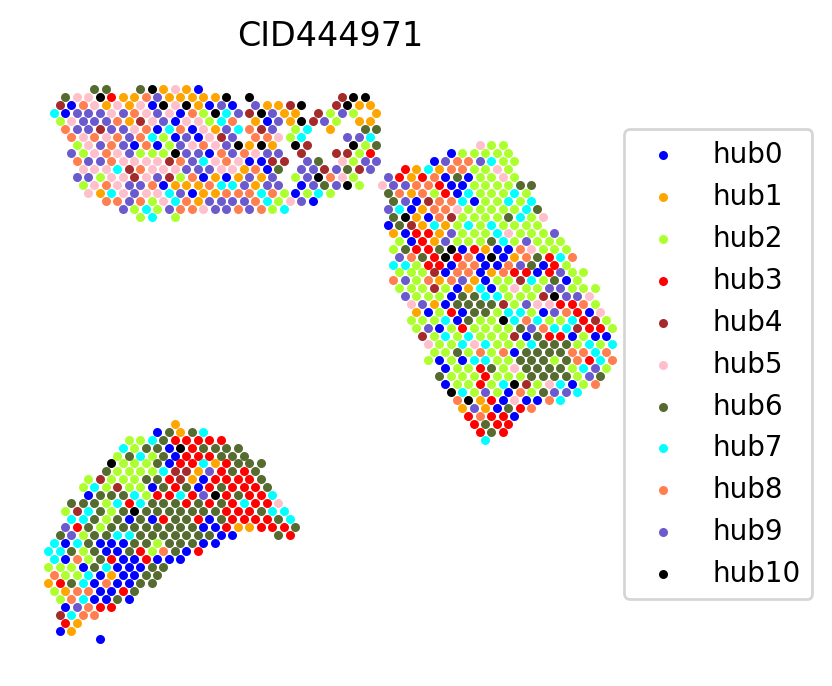

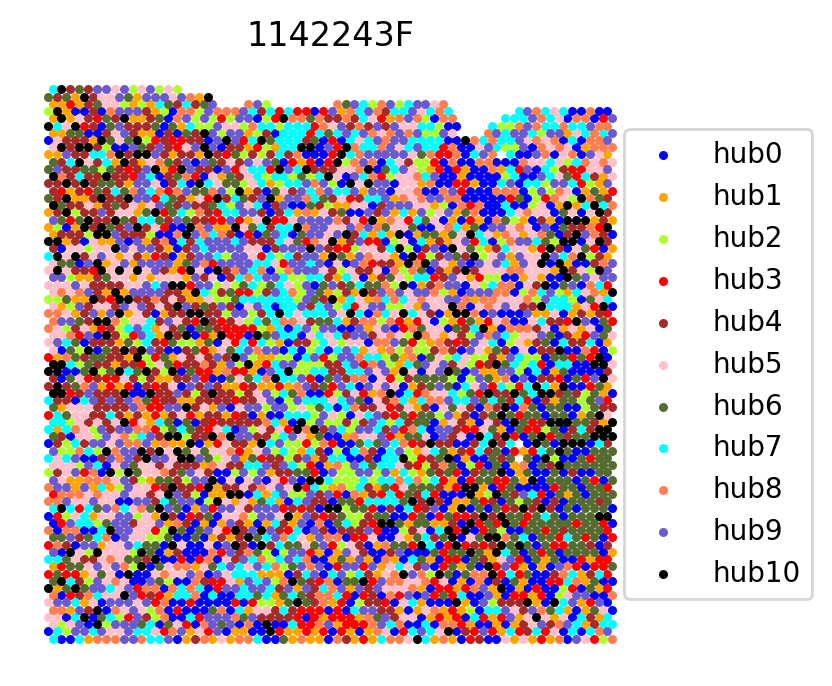

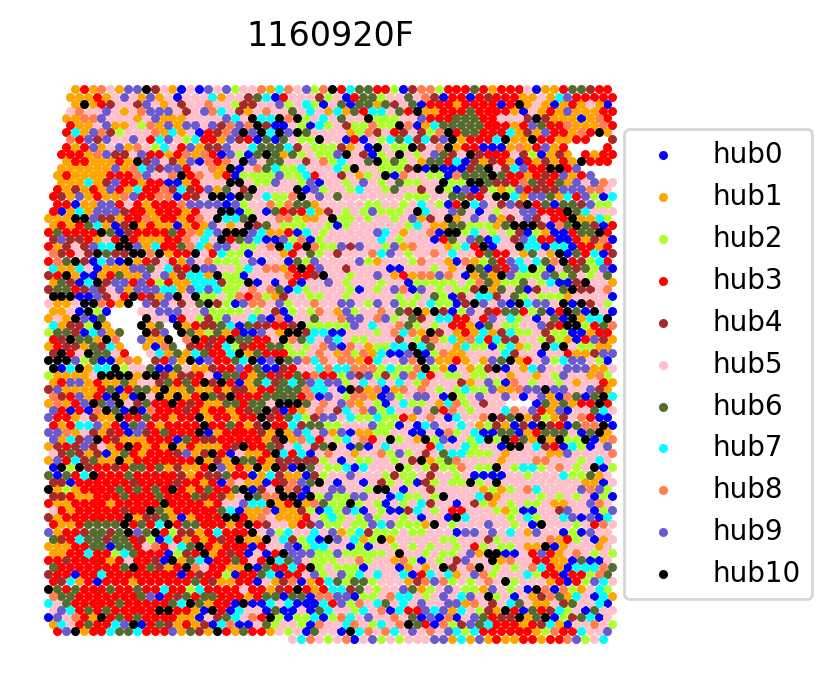

In [322]:
# load all expression data  [spot x gene]
data_path = 'data'
sample_ids = ['MBC_1A',
             'MBC_1B',
             'MBC_2A',
             'MBC_2B',
             'MBC_3A',
             'MBC_3B',
             'MBC_4A',
             'MBC_4B',
             'CID4465',
             'CID444971',
             '1142243F',
             '1160920F'
            ]

for sample_id in sample_ids:
    data_path = '../data'
    if sample_id.startswith('MBC'):

        adata_sample = sc.read_visium(path=os.path.join(data_path, sample_id),library_id =  sample_id)
        adata_sample.var_names_make_unique()
        adata_sample.obs['sample']=sample_id
        adata_sample.obs_names  = adata_sample.obs_names+'-'+sample_id
    else:
        adata_sample = sc.read_h5ad(os.path.join(data_path,sample_id, sample_id+'.h5ad'))
        adata_sample.var_names_make_unique()
        adata_sample.obs['sample']=sample_id
        adata_sample.obs_names  = adata_sample.obs_names+'-'+sample_id
        
    cluster_id = pd.DataFrame((np.zeros(len(adata_sample.obs_names))*(-1)).astype(int),columns=['clusters'],index=adata_sample.obs_names)
    
    col_order_df = pd.read_csv('../results/03_hubs_0105/'+'RNA_alltumors_bicluster_res_col_orders_individual.csv')
    row_order_df = pd.read_csv('../results/03_hubs_0105/'+'RNA_alltumors_bicluster_res_row_orders_individual.csv')
    
    map_info = pd.read_csv("../results/02_PoE_factor_0105/"+sample_id+'map_info.csv',index_col=0)
    
    for i in adata_sample.obs_names:
        if i in np.array(row_order_df.loc[:,'id']):
            cluster_id.loc[i,'clusters']= (row_order_df.loc[np.where(row_order_df['id']==i)[0][0],'cluster']).astype(object)
    adata_sample.obs['hub'] =  cluster_id
    
    
    
    fig,axs=plt.subplots(1,1,figsize=(4,4),dpi=200)

    ax=axs
    for i in range(11):
        all_loc = np.array(map_info.loc[cluster_id[cluster_id.clusters==i].index,:].loc[:,['array_col','array_row']])
        #all_spot = np.array(row_order_df[row_order_df.cluster==i].loc[:,'cluster'])
        ax.scatter(all_loc[:,0],-all_loc[:,1],s=5)
    
    ax.set_aspect("auto")
    ax.legend(['hub0','hub1','hub2','hub3','hub4','hub5','hub6','hub7','hub8','hub9','hub10'],loc='right',bbox_to_anchor=(0,0, 1.3, 1.))
    plt.grid(False),
    plt.axis('off')
    plt.title(sample_id)

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Vari

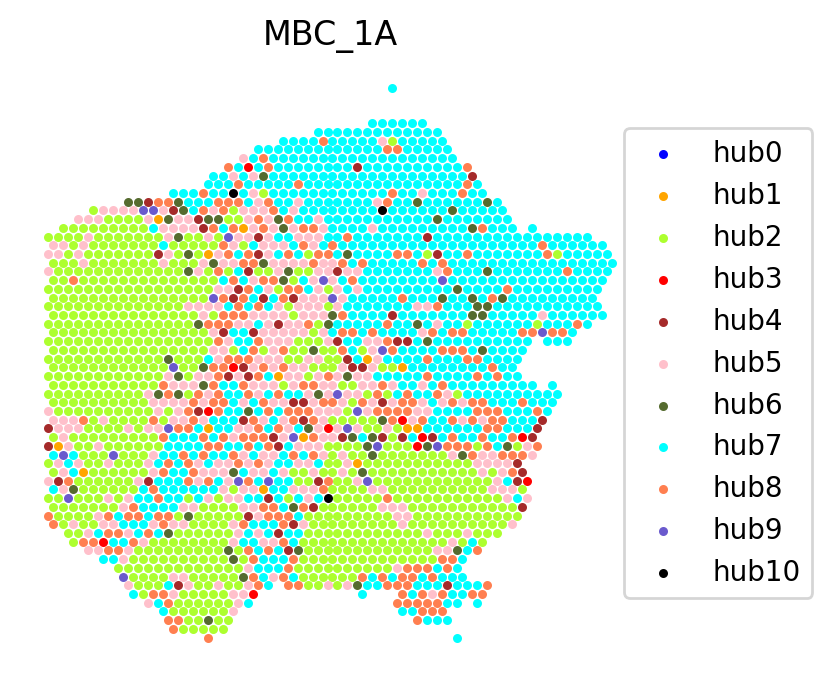

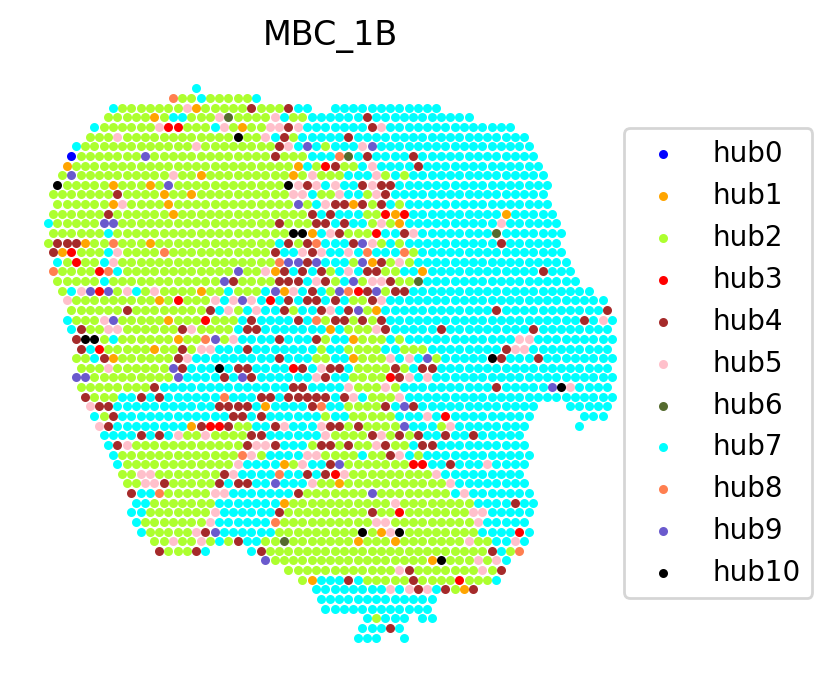

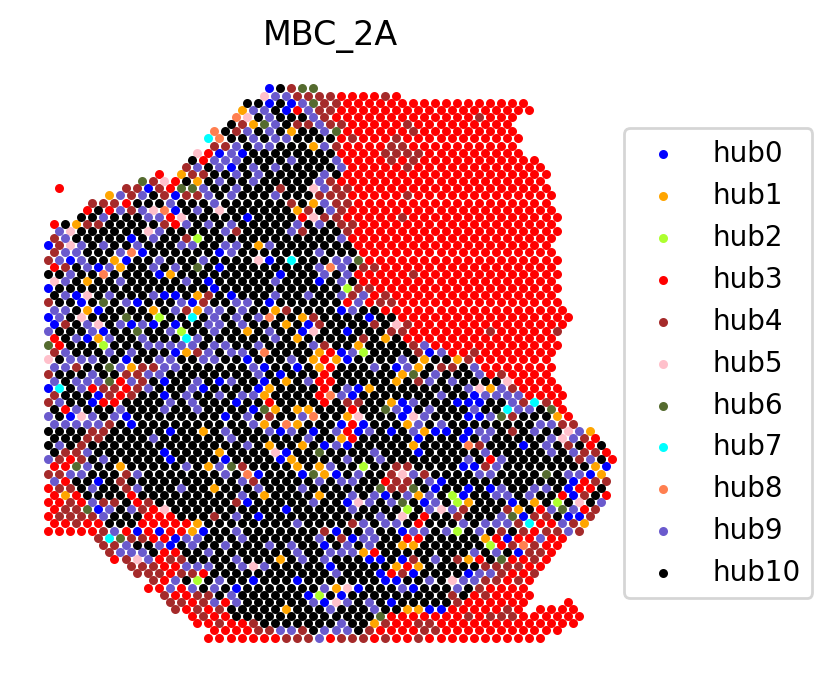

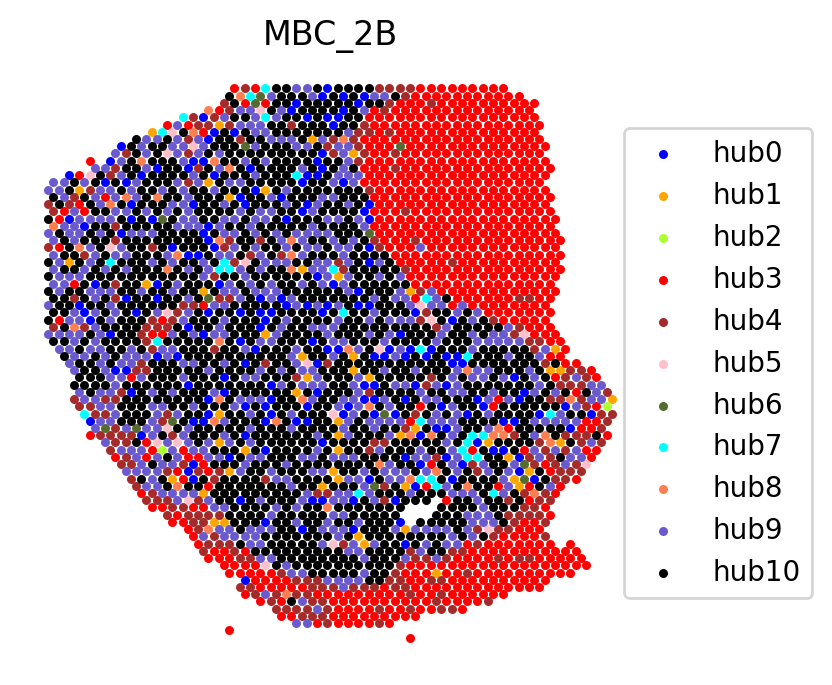

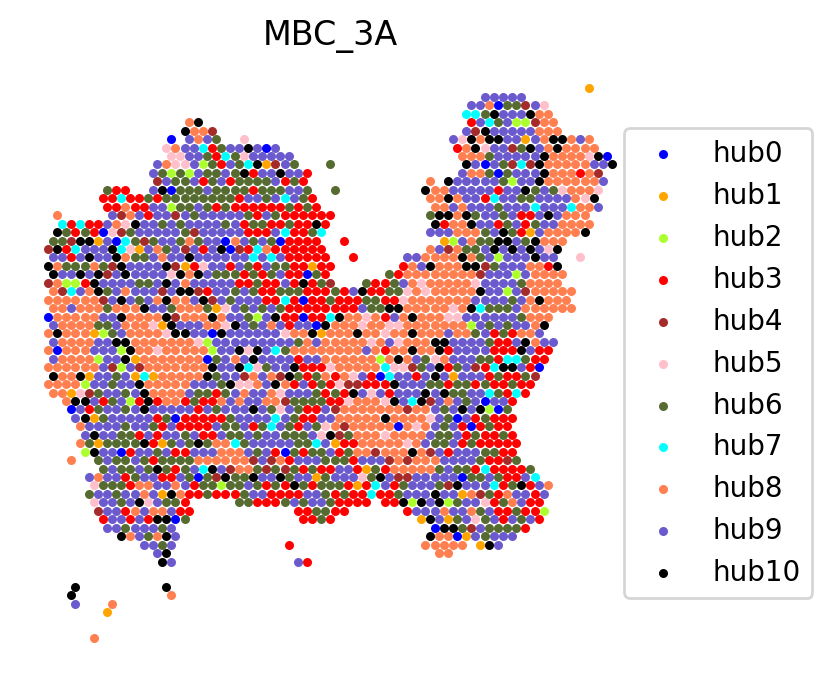

...

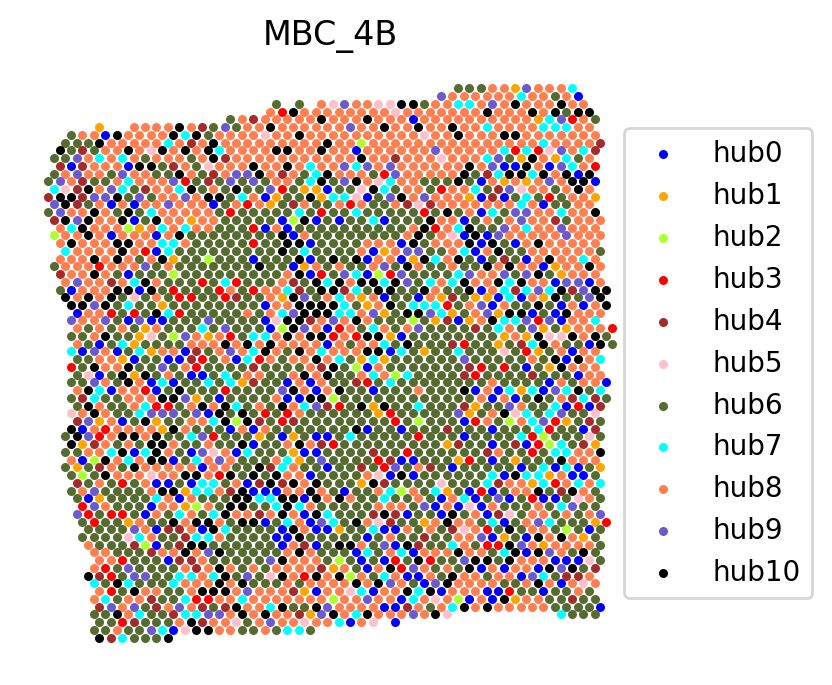

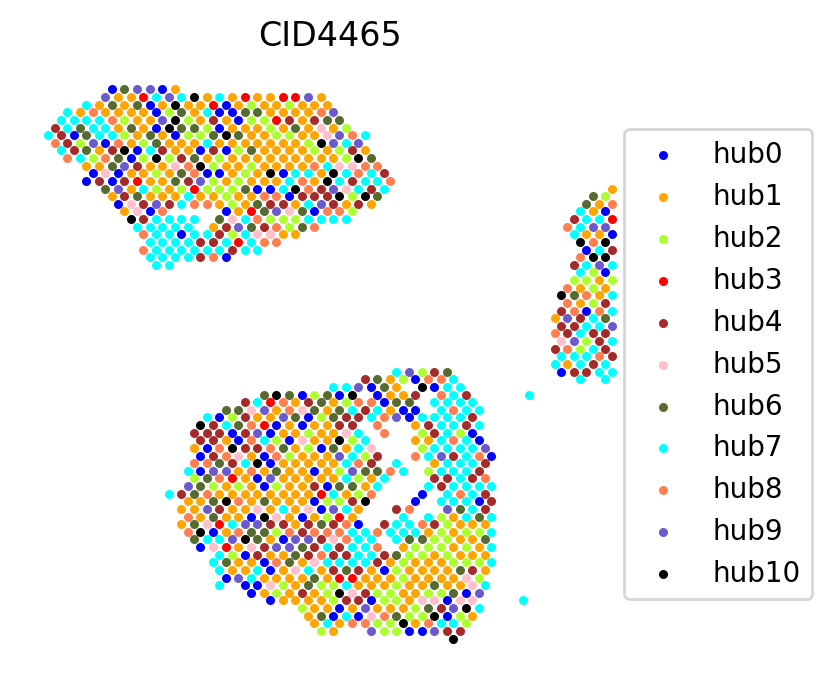

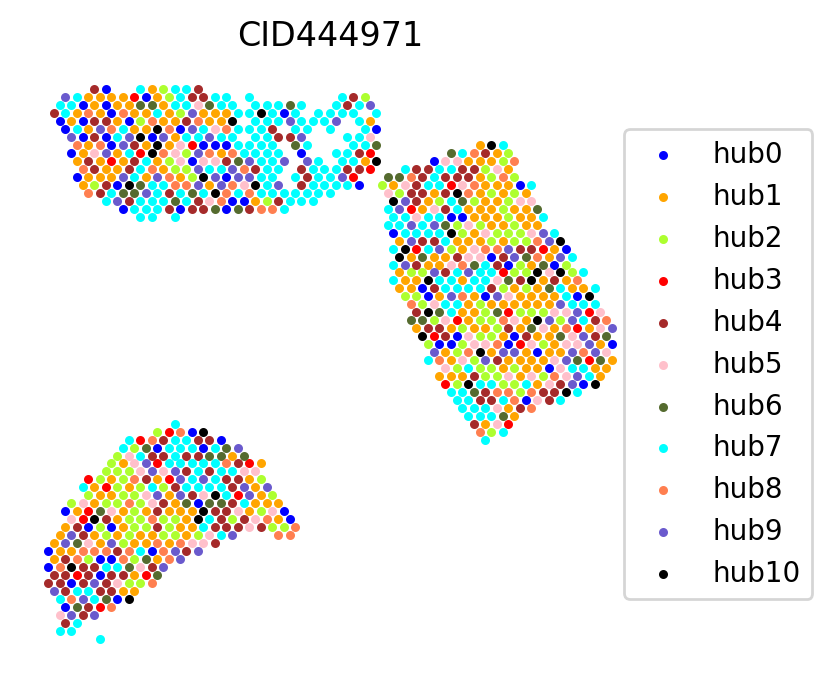

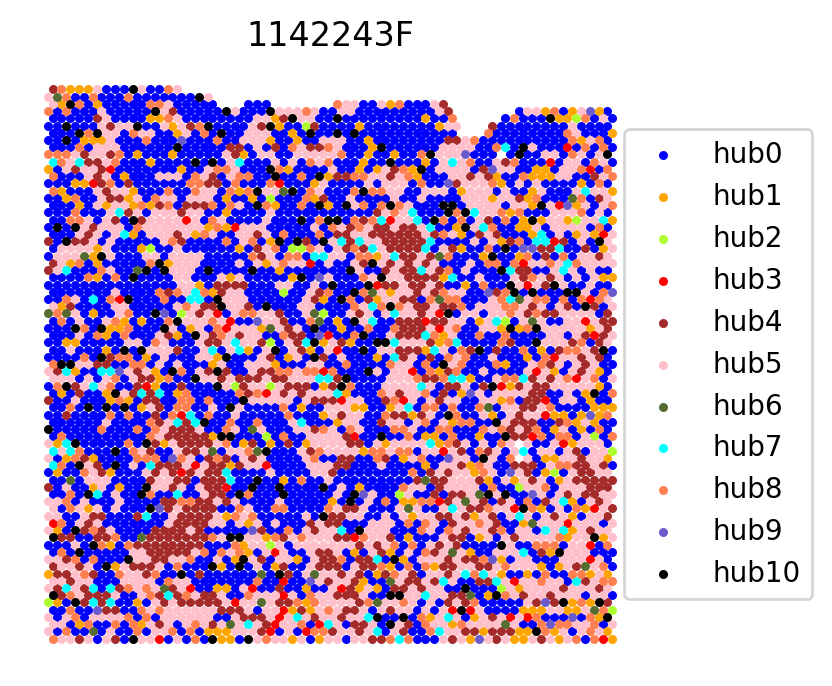

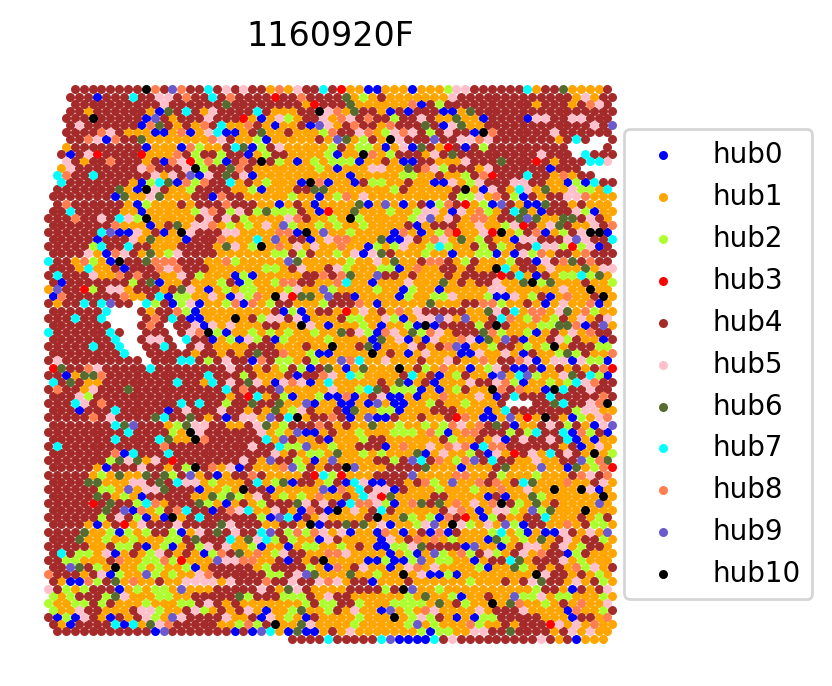

In [188]:
# load all expression data  [spot x gene]
data_path = 'data'
sample_ids = ['MBC_1A',
             'MBC_1B',
             'MBC_2A',
             'MBC_2B',
             'MBC_3A',
             'MBC_3B',
             'MBC_4A',
             'MBC_4B',
             'CID4465',
             'CID444971',
             '1142243F',
             '1160920F'
            ]

for sample_id in sample_ids:
    data_path = '../data'
    if sample_id.startswith('MBC'):

        adata_sample = sc.read_visium(path=os.path.join(data_path, sample_id),library_id =  sample_id)
        adata_sample.var_names_make_unique()
        adata_sample.obs['sample']=sample_id
        adata_sample.obs_names  = adata_sample.obs_names+'-'+sample_id
    else:
        adata_sample = sc.read_h5ad(os.path.join(data_path,sample_id, sample_id+'.h5ad'))
        adata_sample.var_names_make_unique()
        adata_sample.obs['sample']=sample_id
        adata_sample.obs_names  = adata_sample.obs_names+'-'+sample_id
        
    cluster_id = pd.DataFrame((np.zeros(len(adata_sample.obs_names))*(-1)).astype(int),columns=['clusters'],index=adata_sample.obs_names)
    
    col_order_df = pd.read_csv('../results/03_hubs/'+'PoE_alltumors_bicluster_res_col_orders_individual.csv')
    row_order_df = pd.read_csv('../results/03_hubs/'+'PoE_alltumors_bicluster_res_row_orders_individual.csv')
    
    map_info = pd.read_csv("../results/02_PoE_factor/"+sample_id+'map_info.csv',index_col=0)
    
    for i in adata_sample.obs_names:
        if i in np.array(row_order_df.loc[:,'id']):
            cluster_id.loc[i,'clusters']= (row_order_df.loc[np.where(row_order_df['id']==i)[0][0],'cluster']).astype(object)
    adata_sample.obs['hub'] =  cluster_id
    
    
    
    fig,axs=plt.subplots(1,1,figsize=(4,4),dpi=200)

    ax=axs
    for i in range(11):
        all_loc = np.array(map_info.loc[cluster_id[cluster_id.clusters==i].index,:].loc[:,['array_col','array_row']])
        #all_spot = np.array(row_order_df[row_order_df.cluster==i].loc[:,'cluster'])
        ax.scatter(all_loc[:,0],-all_loc[:,1],s=5)
    
    ax.set_aspect("auto")
    ax.legend(['hub0','hub1','hub2','hub3','hub4','hub5','hub6','hub7','hub8','hub9','hub10'],loc='right',bbox_to_anchor=(0,0, 1.3, 1.))
    plt.grid(False),
    plt.axis('off')
    plt.title(sample_id)

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Vari

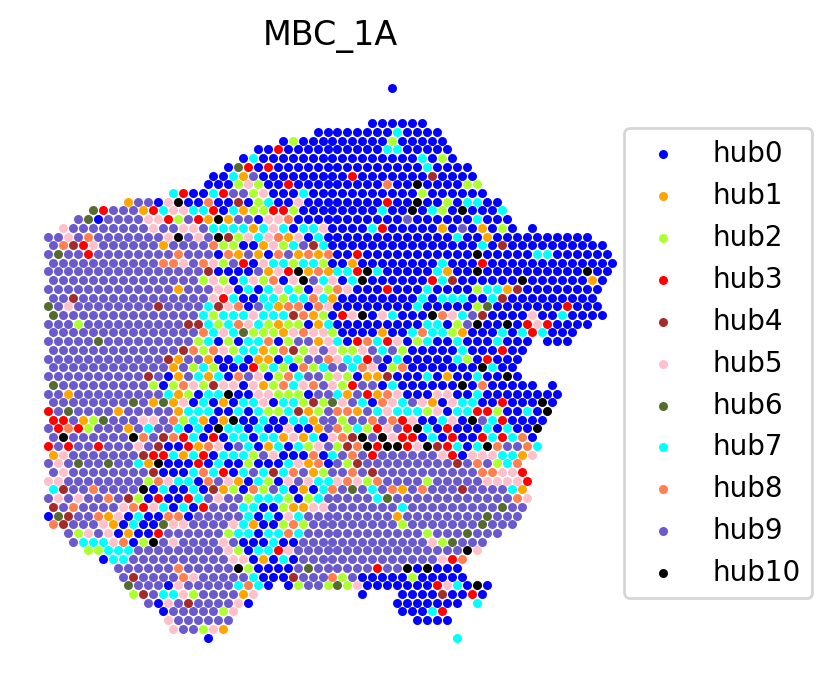

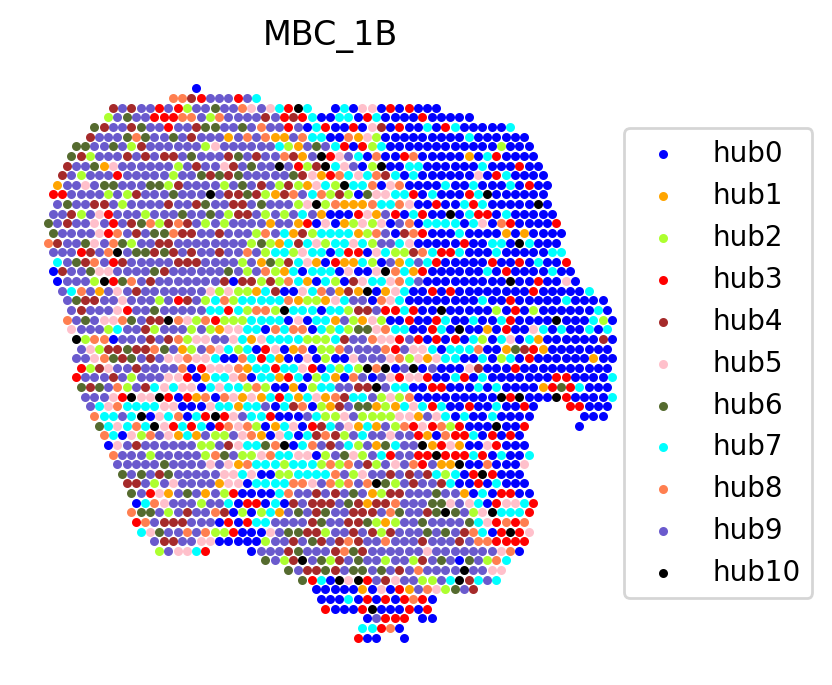

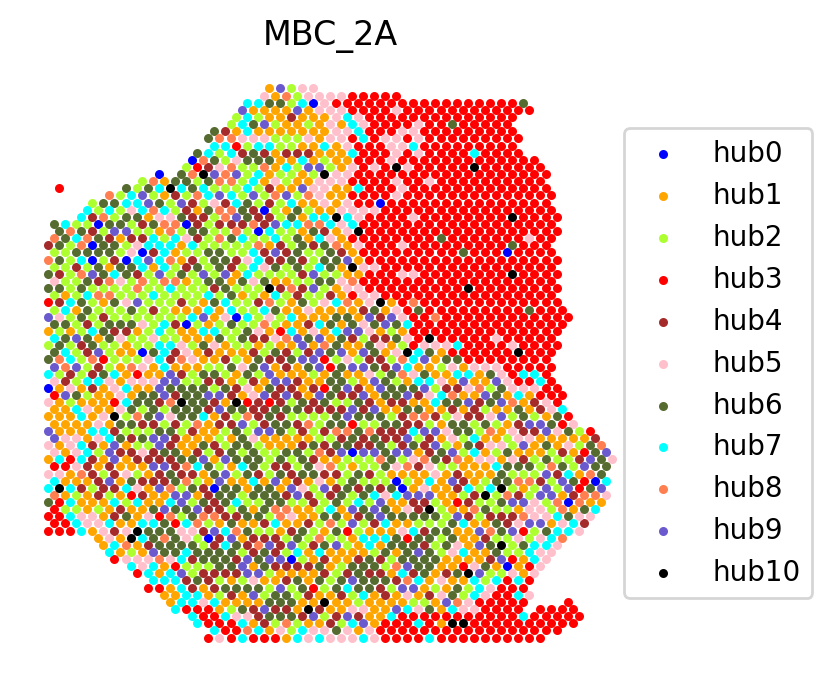

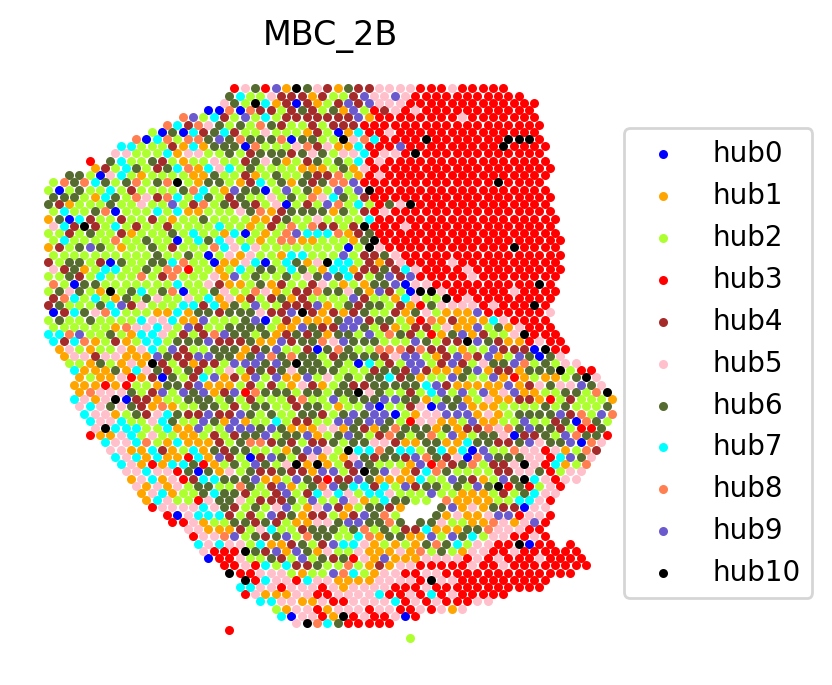

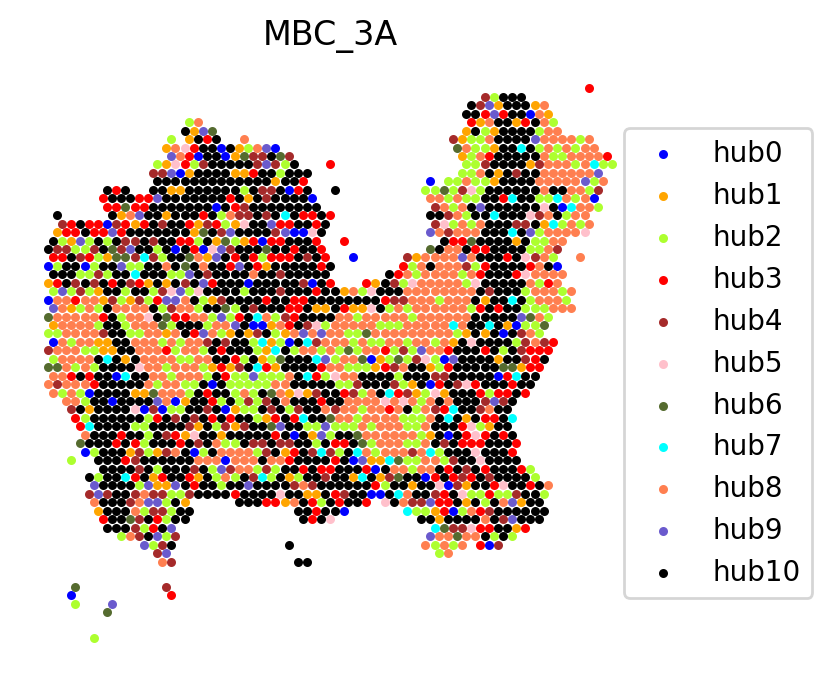

...

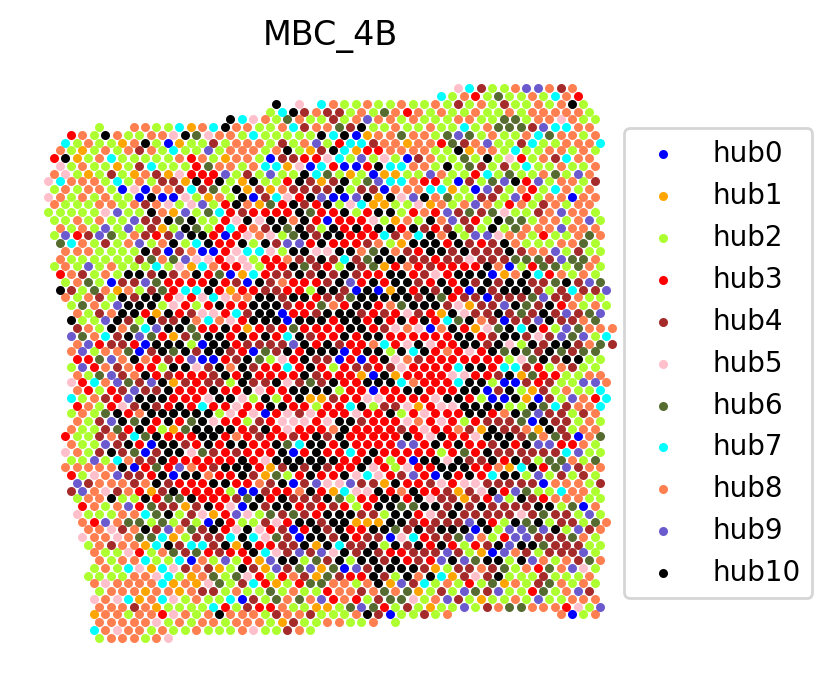

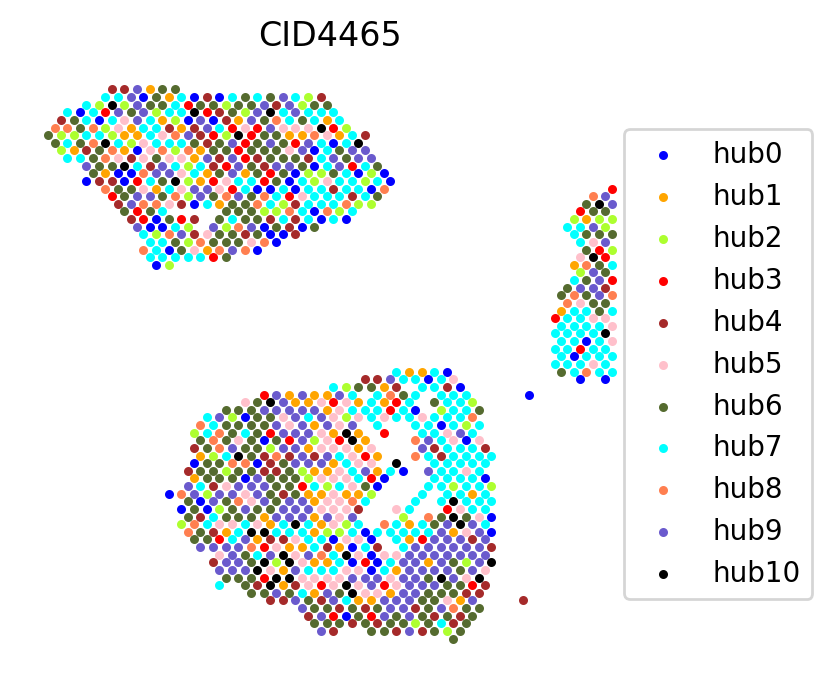

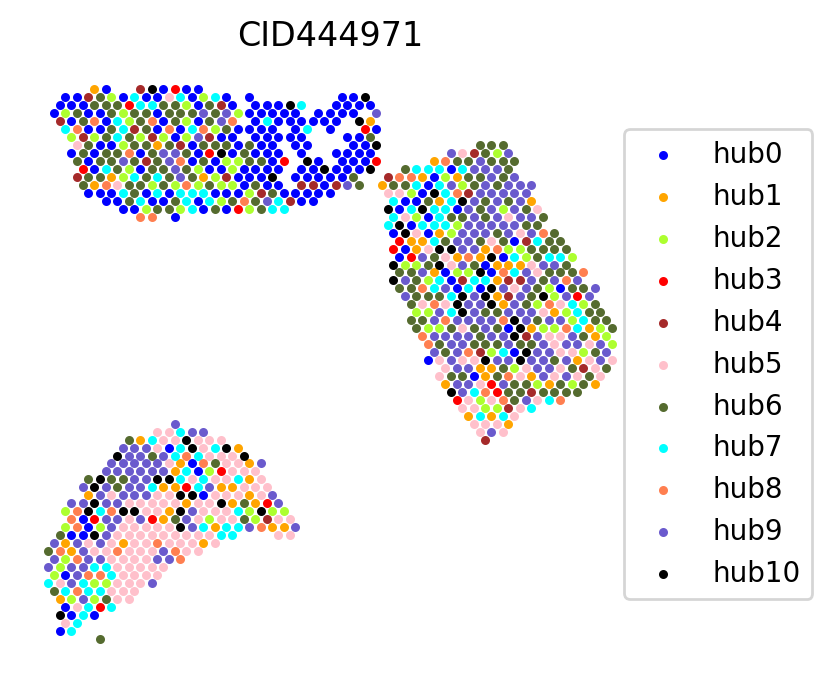

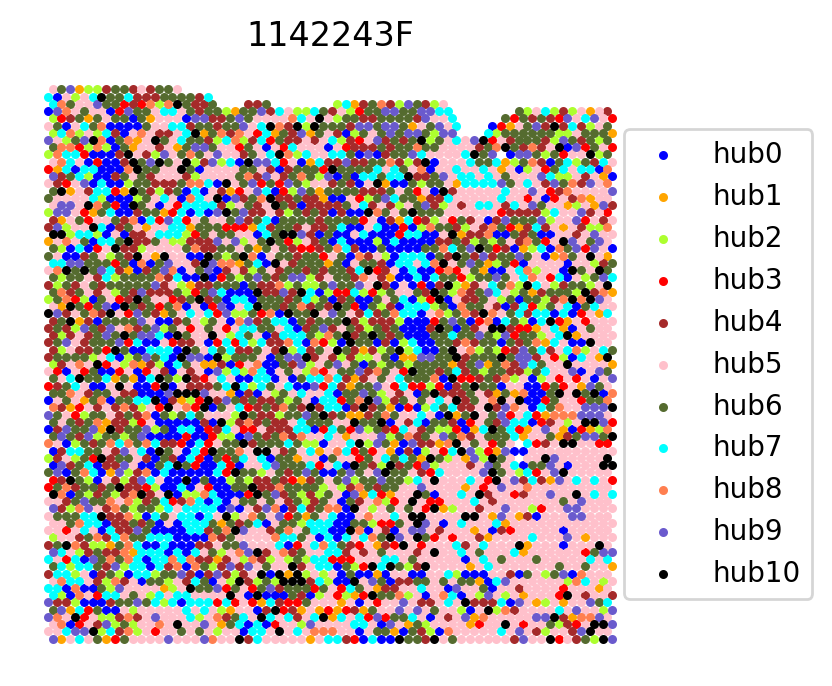

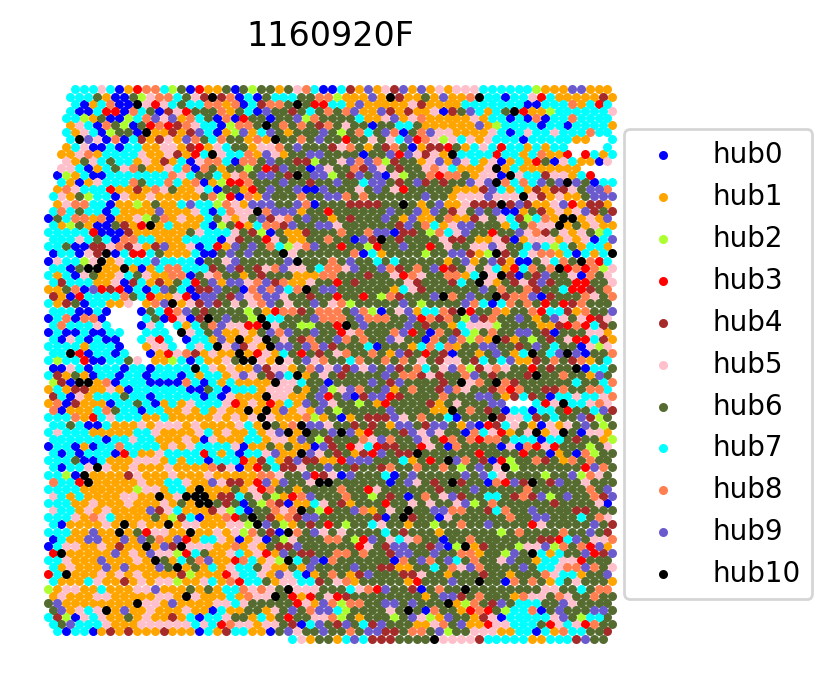

In [158]:
# load all expression data  [spot x gene]
data_path = 'data'
sample_ids = ['MBC_1A',
             'MBC_1B',
             'MBC_2A',
             'MBC_2B',
             'MBC_3A',
             'MBC_3B',
             'MBC_4A',
             'MBC_4B',
             'CID4465',
             'CID444971',
             '1142243F',
             '1160920F'
            ]

for sample_id in sample_ids:
    data_path = '../data'
    if sample_id.startswith('MBC'):

        adata_sample = sc.read_visium(path=os.path.join(data_path, sample_id),library_id =  sample_id)
        adata_sample.var_names_make_unique()
        adata_sample.obs['sample']=sample_id
        adata_sample.obs_names  = adata_sample.obs_names+'-'+sample_id
    else:
        adata_sample = sc.read_h5ad(os.path.join(data_path,sample_id, sample_id+'.h5ad'))
        adata_sample.var_names_make_unique()
        adata_sample.obs['sample']=sample_id
        adata_sample.obs_names  = adata_sample.obs_names+'-'+sample_id
        
    cluster_id = pd.DataFrame((np.zeros(len(adata_sample.obs_names))*(-1)).astype(int),columns=['clusters'],index=adata_sample.obs_names)
    
    col_order_df = pd.read_csv('../results/03_hubs/'+'PoE_alltumors_bicluster_res_col_orders_individual.csv')
    row_order_df = pd.read_csv('../results/03_hubs/'+'PoE_alltumors_bicluster_res_row_orders_individual.csv')
    
    map_info = pd.read_csv("../results/02_PoE_factor/"+sample_id+'map_info.csv',index_col=0)
    
    for i in adata_sample.obs_names:
        if i in np.array(row_order_df.loc[:,'id']):
            cluster_id.loc[i,'clusters']= (row_order_df.loc[np.where(row_order_df['id']==i)[0][0],'cluster']).astype(object)
    adata_sample.obs['hub'] =  cluster_id
    
    
    
    fig,axs=plt.subplots(1,1,figsize=(4,4),dpi=200)

    ax=axs
    for i in range(11):
        all_loc = np.array(map_info.loc[cluster_id[cluster_id.clusters==i].index,:].loc[:,['array_col','array_row']])
        #all_spot = np.array(row_order_df[row_order_df.cluster==i].loc[:,'cluster'])
        ax.scatter(all_loc[:,0],-all_loc[:,1],s=5)
    
    ax.set_aspect("auto")
    ax.legend(['hub0','hub1','hub2','hub3','hub4','hub5','hub6','hub7','hub8','hub9','hub10'],loc='right',bbox_to_anchor=(0,0, 1.3, 1.))
    plt.grid(False),
    plt.axis('off')
    plt.title(sample_id)

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Vari

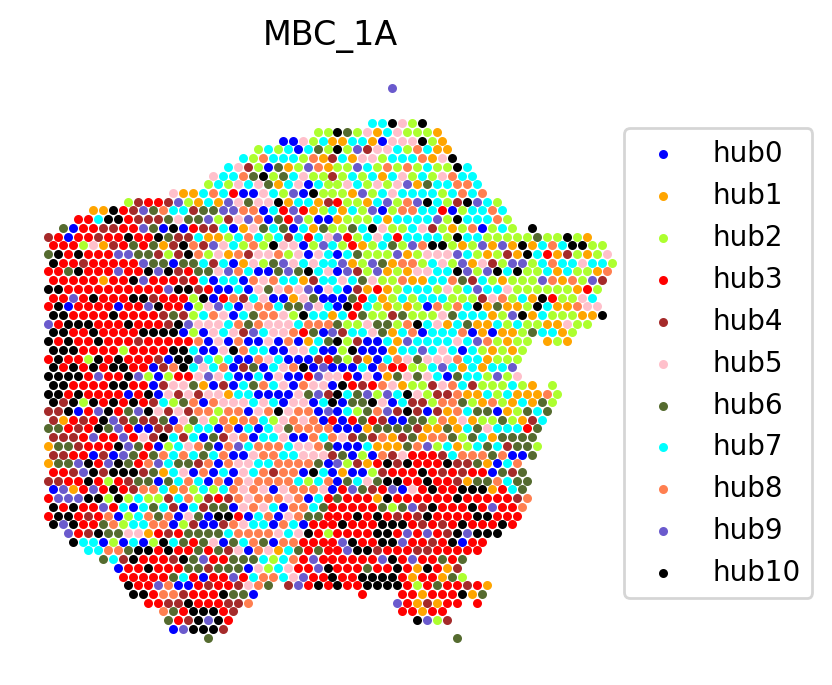

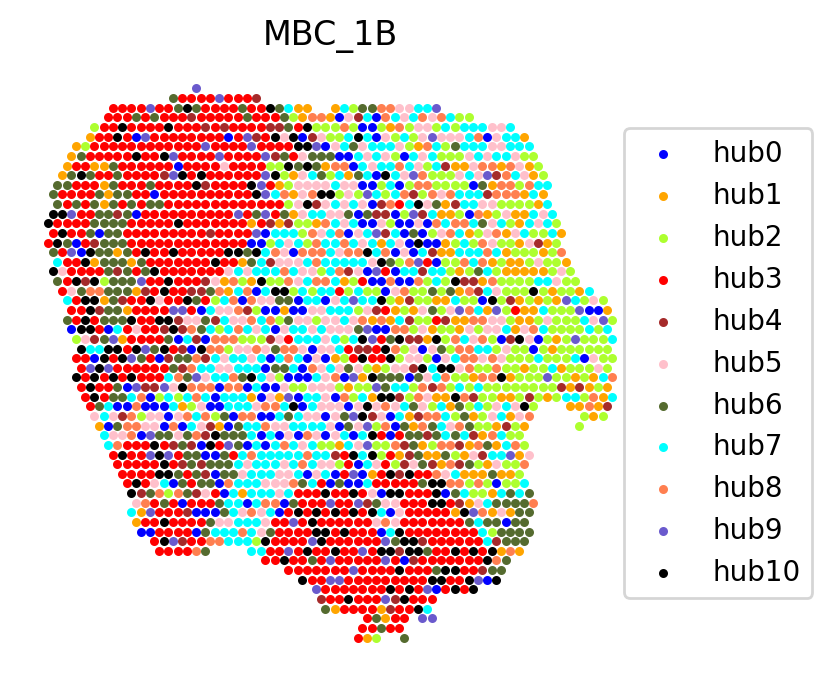

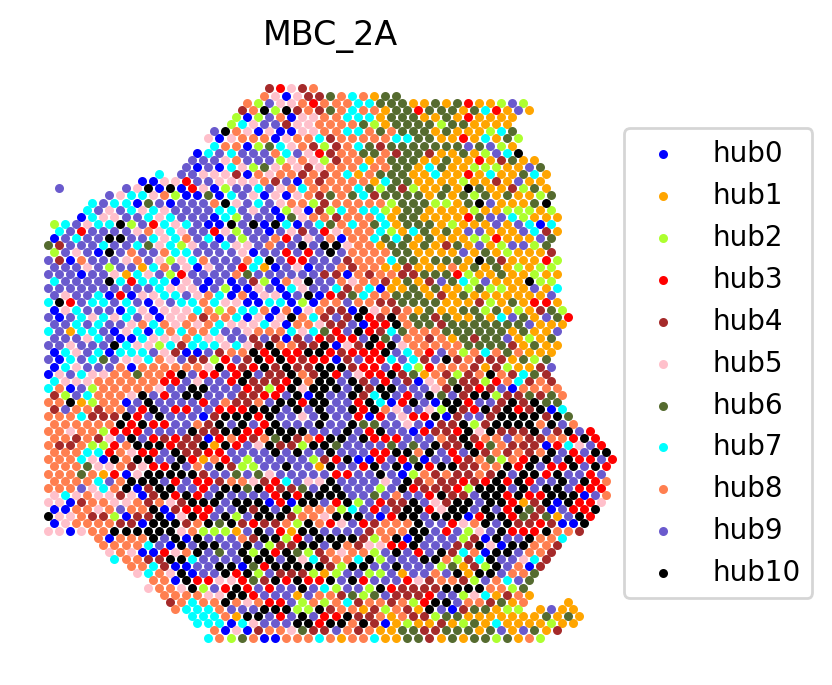

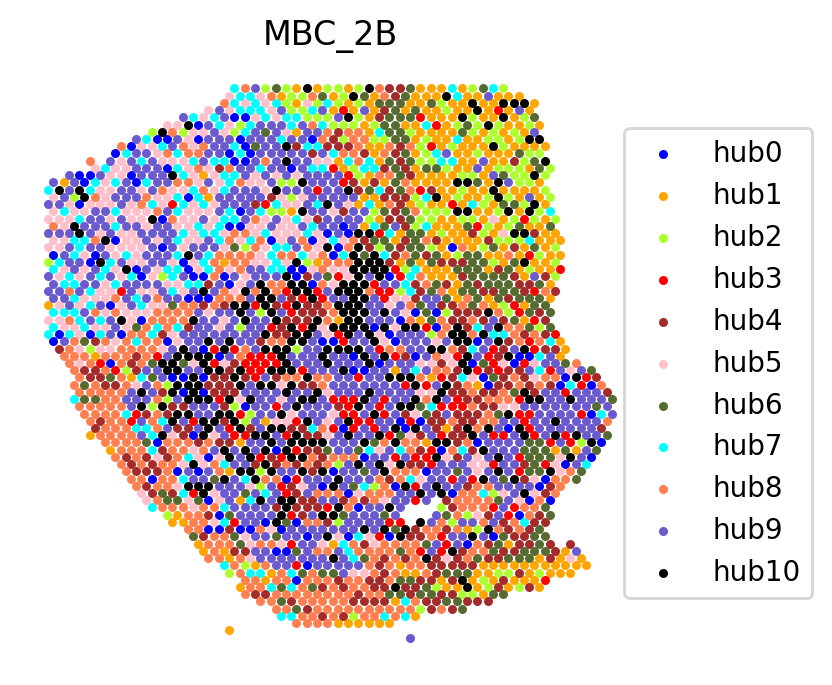

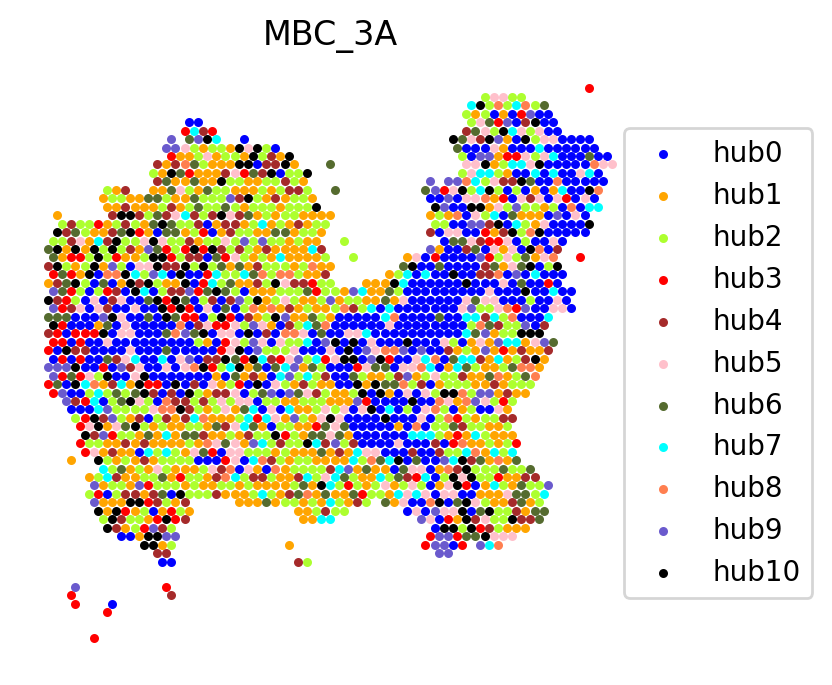

...

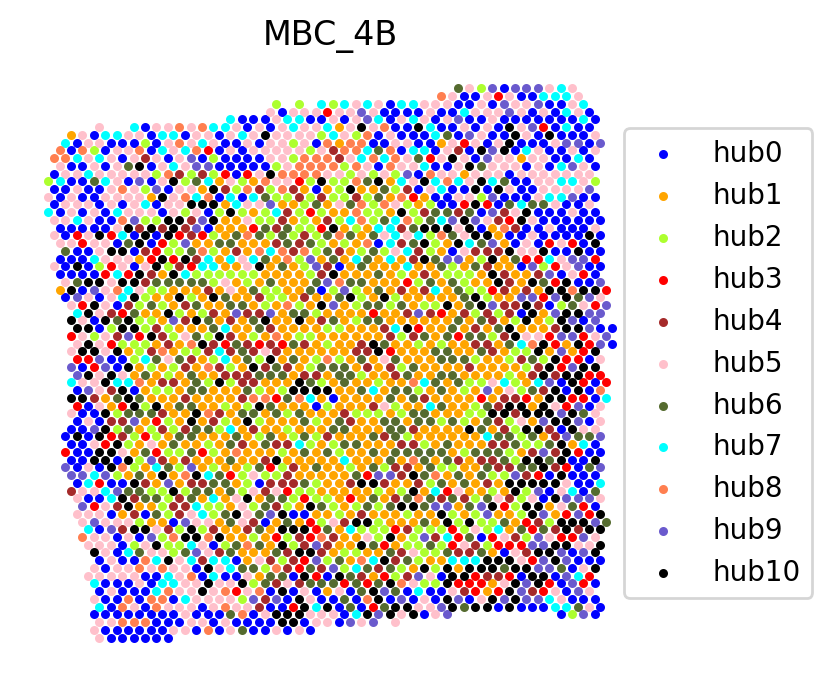

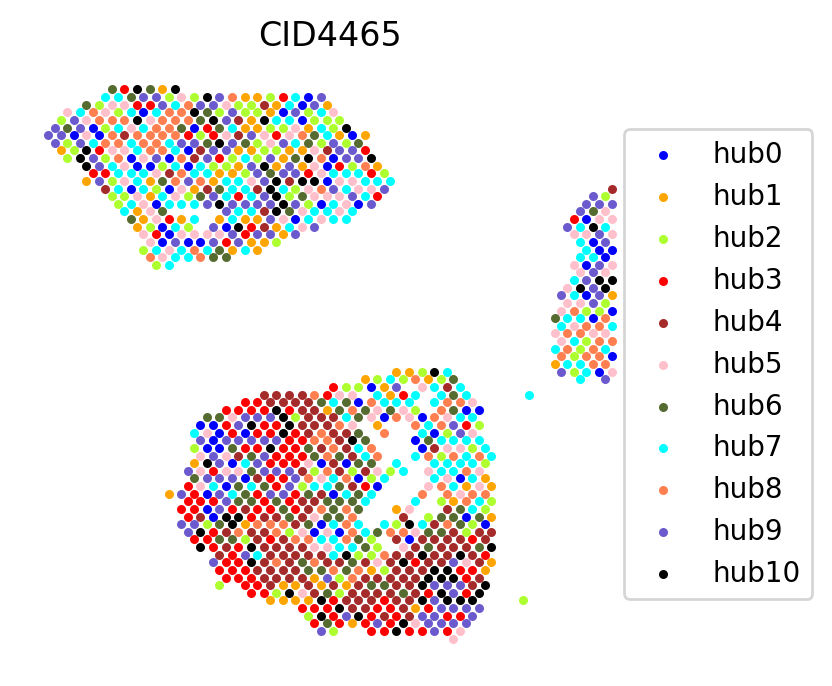

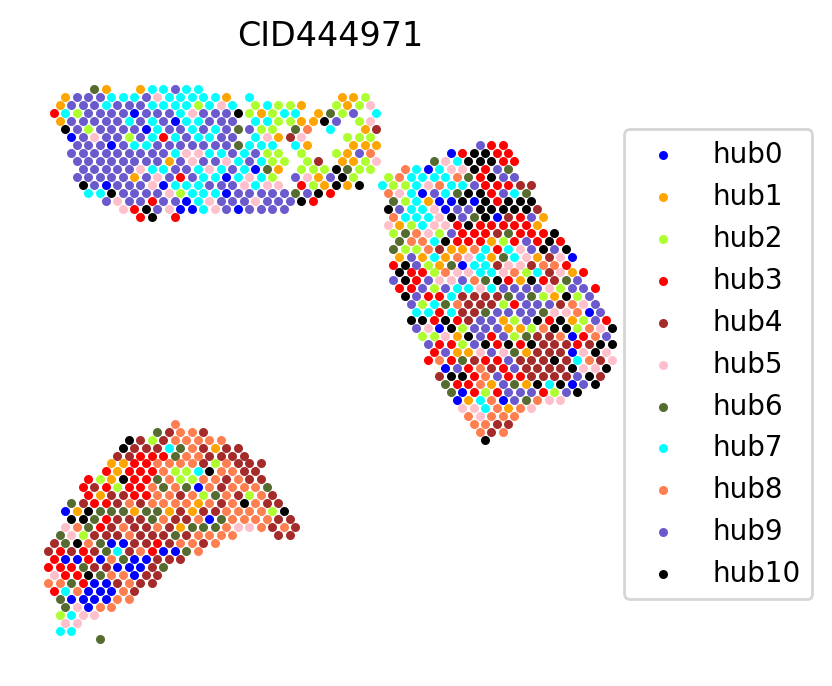

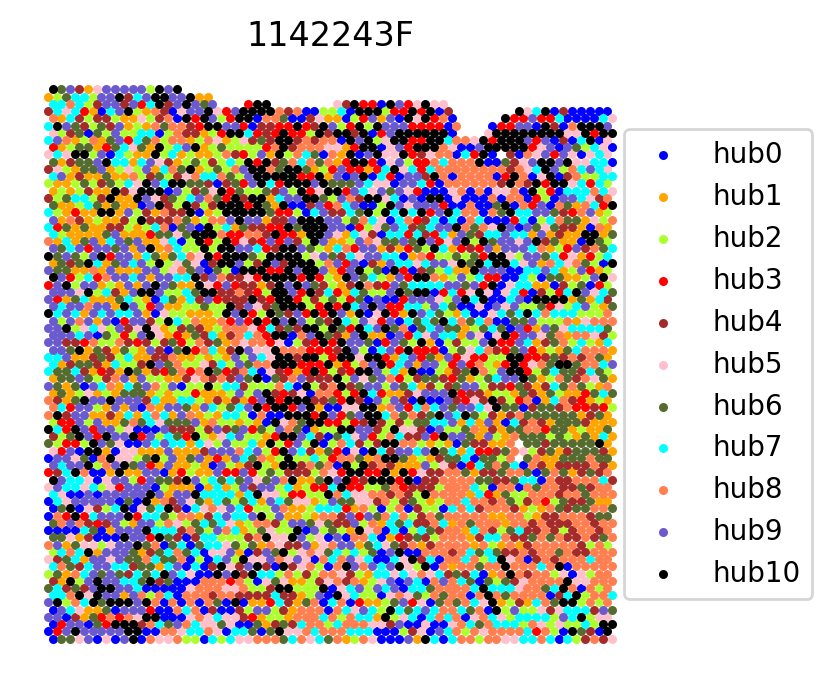

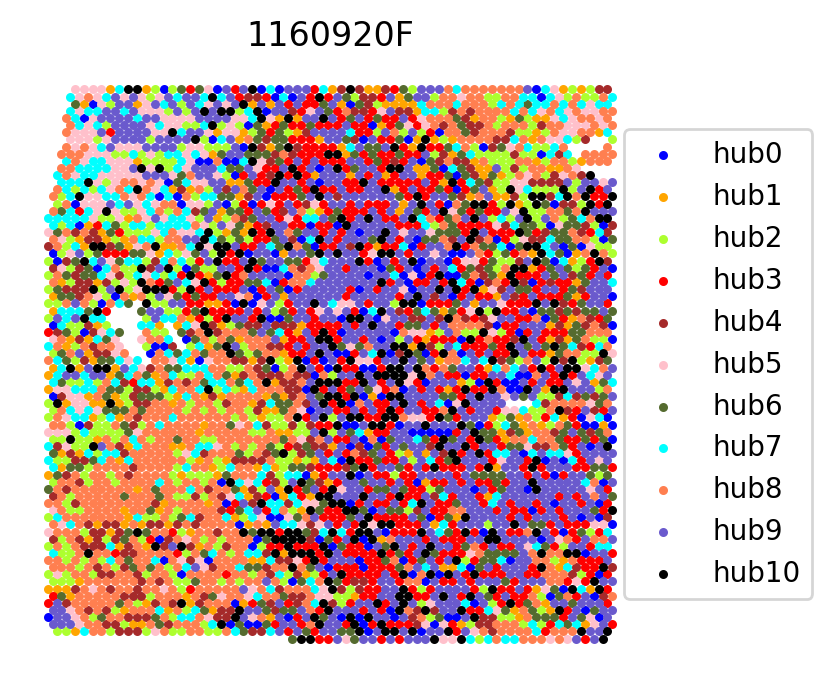

In [155]:
# load all expression data  [spot x gene]
data_path = 'data'
sample_ids = ['MBC_1A',
             'MBC_1B',
             'MBC_2A',
             'MBC_2B',
             'MBC_3A',
             'MBC_3B',
             'MBC_4A',
             'MBC_4B',
             'CID4465',
             'CID444971',
             '1142243F',
             '1160920F'
            ]

for sample_id in sample_ids:
    data_path = '../data'
    if sample_id.startswith('MBC'):

        adata_sample = sc.read_visium(path=os.path.join(data_path, sample_id),library_id =  sample_id)
        adata_sample.var_names_make_unique()
        adata_sample.obs['sample']=sample_id
        adata_sample.obs_names  = adata_sample.obs_names+'-'+sample_id
    else:
        adata_sample = sc.read_h5ad(os.path.join(data_path,sample_id, sample_id+'.h5ad'))
        adata_sample.var_names_make_unique()
        adata_sample.obs['sample']=sample_id
        adata_sample.obs_names  = adata_sample.obs_names+'-'+sample_id
        
    cluster_id = pd.DataFrame((np.zeros(len(adata_sample.obs_names))*(-1)).astype(int),columns=['clusters'],index=adata_sample.obs_names)
    
    col_order_df = pd.read_csv('../results/03_hubs/'+'alltumors_bicluster_res_col_orders_individual.csv')
    row_order_df = pd.read_csv('../results/03_hubs/'+'alltumors_bicluster_res_row_orders_individual.csv')
    
    map_info = pd.read_csv("../results/02_PoE_factor/"+sample_id+'map_info.csv',index_col=0)
    
    for i in adata_sample.obs_names:
        if i in np.array(row_order_df.loc[:,'id']):
            cluster_id.loc[i,'clusters']= (row_order_df.loc[np.where(row_order_df['id']==i)[0][0],'cluster']).astype(object)
    adata_sample.obs['hub'] =  cluster_id
    
    
    
    fig,axs=plt.subplots(1,1,figsize=(4,4),dpi=200)

    ax=axs
    for i in range(11):
        all_loc = np.array(map_info.loc[cluster_id[cluster_id.clusters==i].index,:].loc[:,['array_col','array_row']])
        #all_spot = np.array(row_order_df[row_order_df.cluster==i].loc[:,'cluster'])
        ax.scatter(all_loc[:,0],-all_loc[:,1],s=5)
    
    ax.set_aspect("auto")
    ax.legend(['hub0','hub1','hub2','hub3','hub4','hub5','hub6','hub7','hub8','hub9','hub10'],loc='right',bbox_to_anchor=(0,0, 1.3, 1.))
    plt.grid(False),
    plt.axis('off')
    plt.title(sample_id)

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Vari

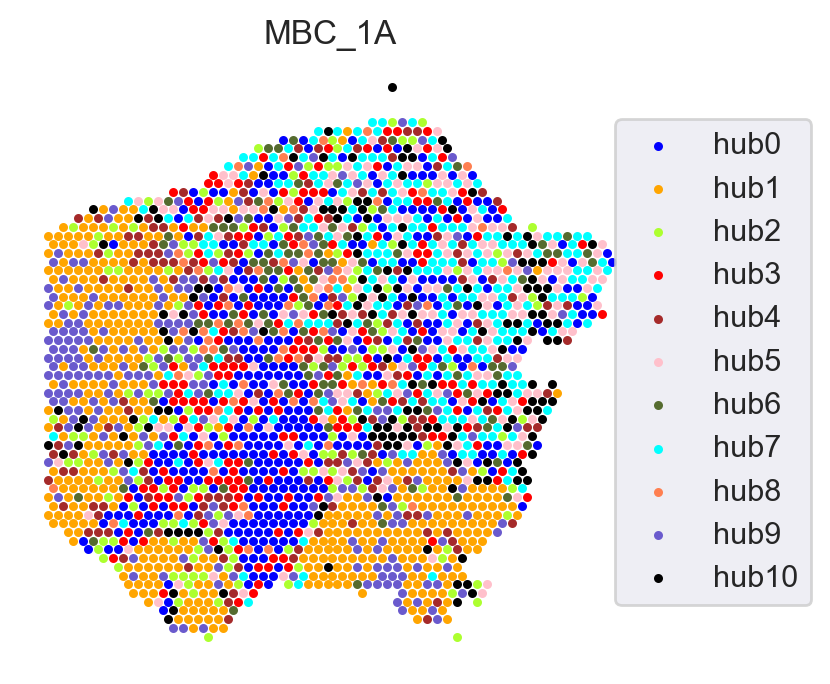

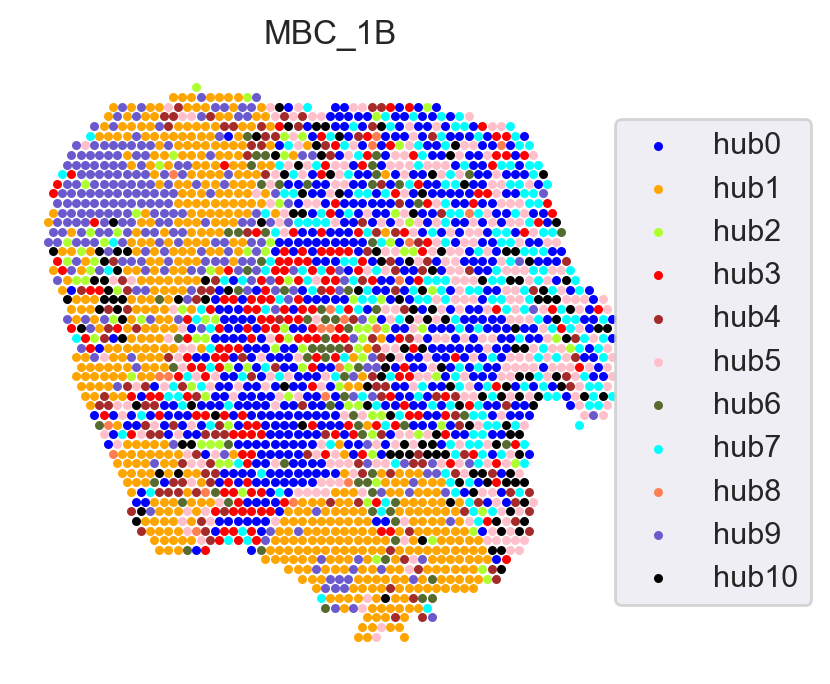

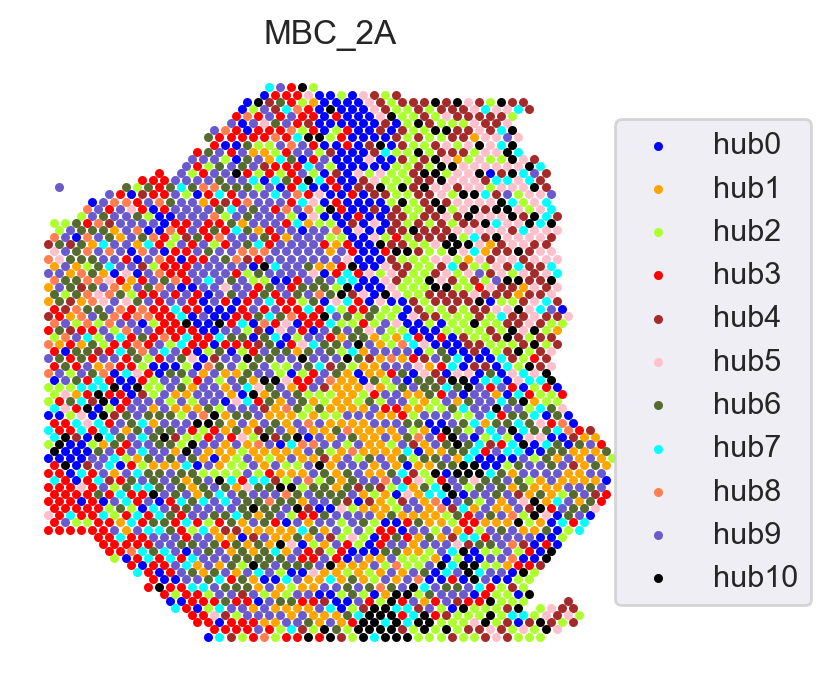

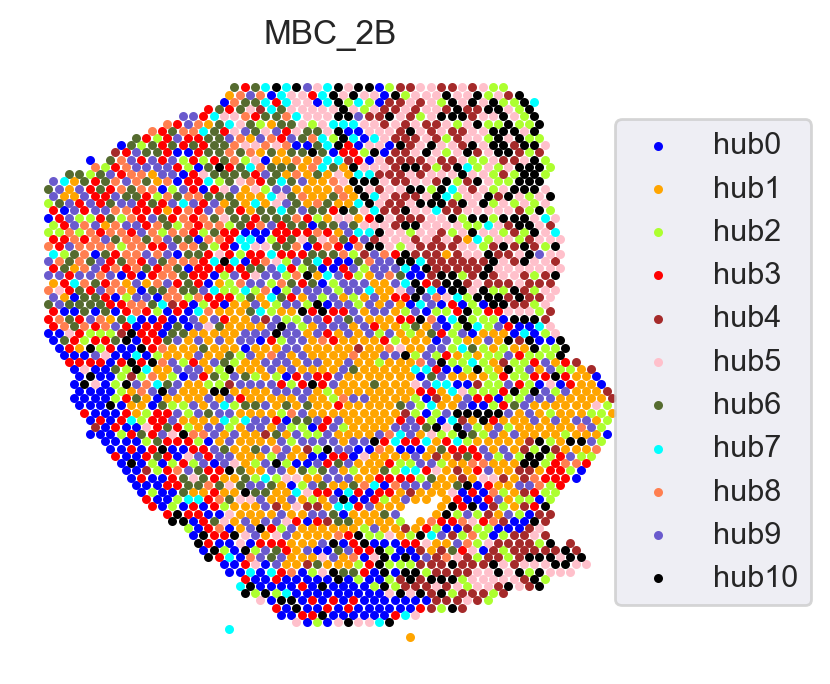

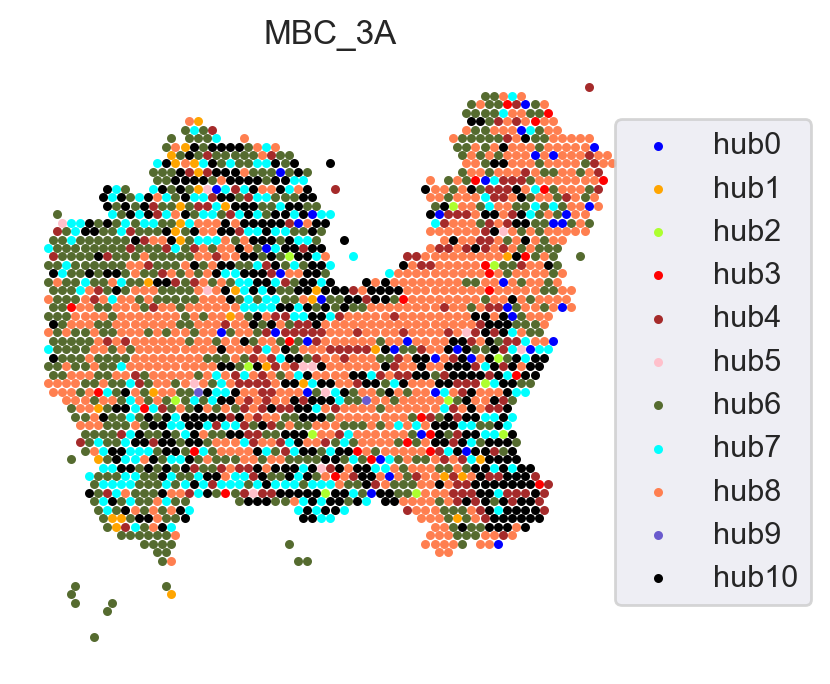

...

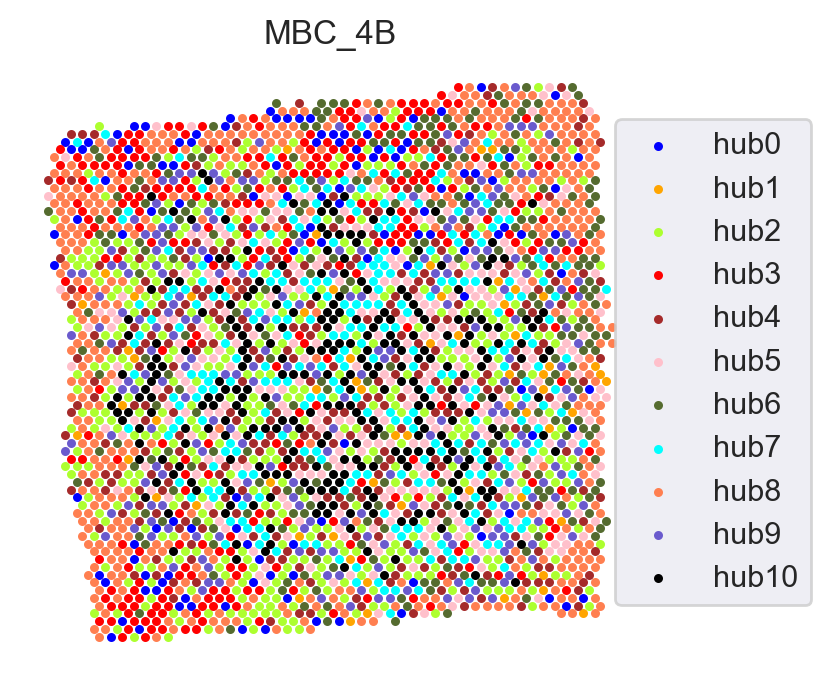

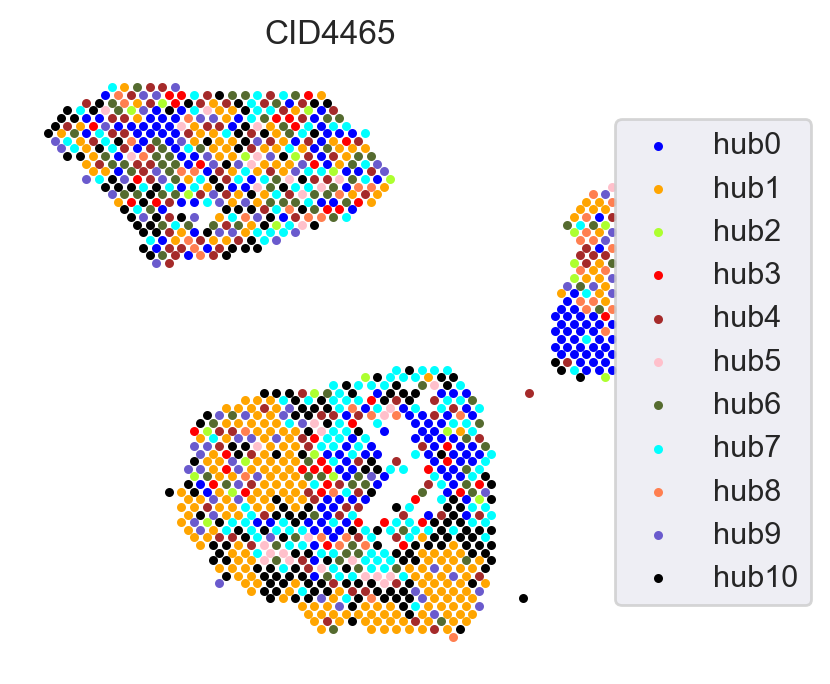

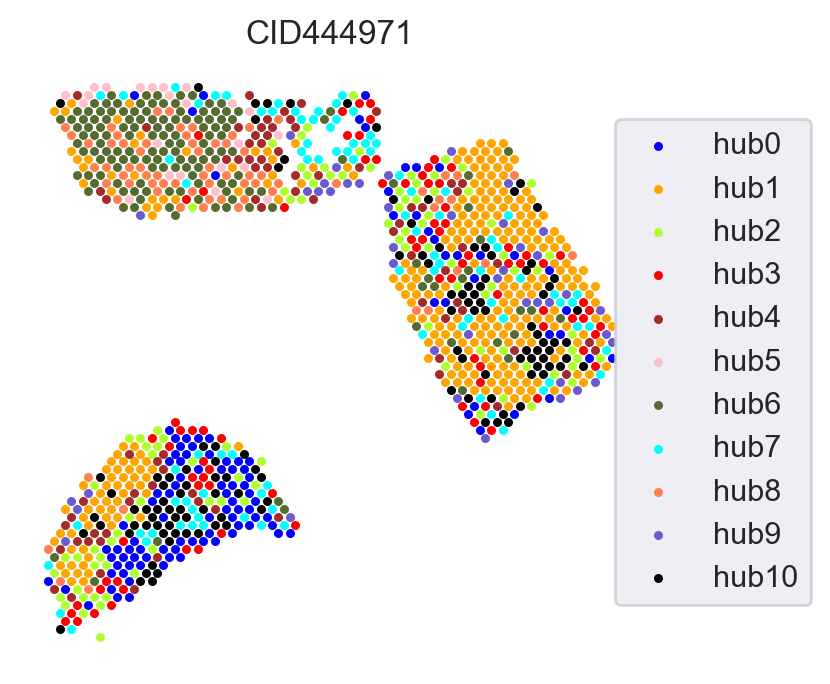

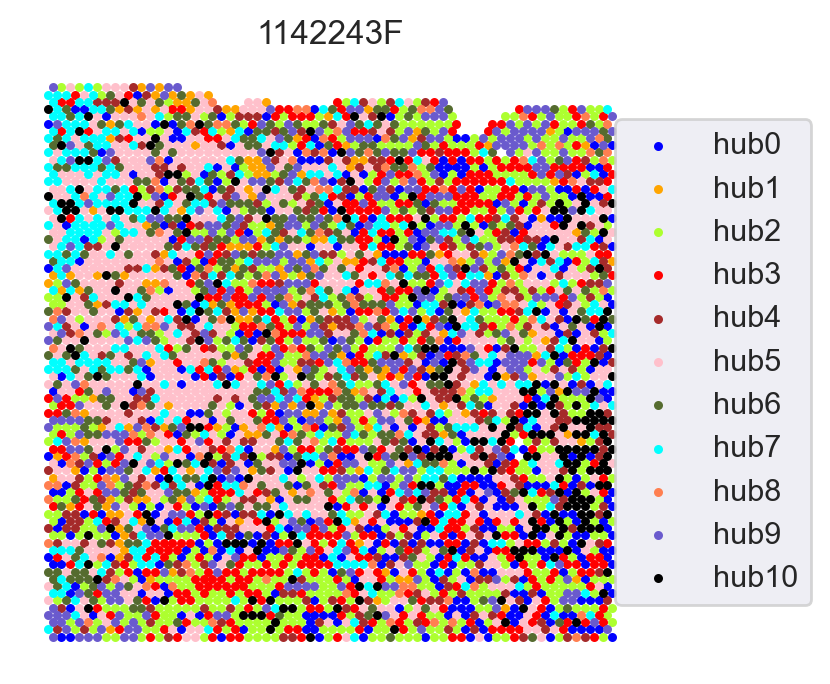

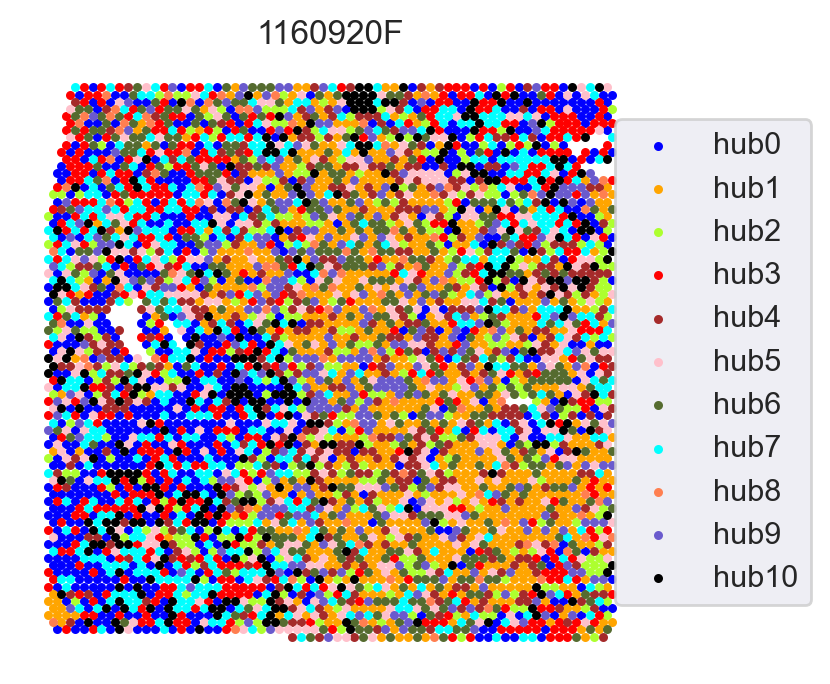

In [231]:
# load all expression data  [spot x gene]
data_path = 'data'
sample_ids = ['MBC_1A',
             'MBC_1B',
             'MBC_2A',
             'MBC_2B',
             'MBC_3A',
             'MBC_3B',
             'MBC_4A',
             'MBC_4B',
             'CID4465',
             'CID444971',
             '1142243F',
             '1160920F'
            ]

for sample_id in sample_ids:
    data_path = '../data'
    if sample_id.startswith('MBC'):

        adata_sample = sc.read_visium(path=os.path.join(data_path, sample_id),library_id =  sample_id)
        adata_sample.var_names_make_unique()
        adata_sample.obs['sample']=sample_id
        adata_sample.obs_names  = adata_sample.obs_names+'-'+sample_id
    else:
        adata_sample = sc.read_h5ad(os.path.join(data_path,sample_id, sample_id+'.h5ad'))
        adata_sample.var_names_make_unique()
        adata_sample.obs['sample']=sample_id
        adata_sample.obs_names  = adata_sample.obs_names+'-'+sample_id
        
    cluster_id = pd.DataFrame((np.zeros(len(adata_sample.obs_names))*(-1)).astype(int),columns=['clusters'],index=adata_sample.obs_names)
    
    col_order_df = pd.read_csv('../results/03_hubs/'+'alltumors_bicluster_res_col_orders_individual.csv')
    row_order_df = pd.read_csv('../results/03_hubs/'+'alltumors_bicluster_res_row_orders_individual.csv')
    
    map_info = pd.read_csv("../results/02_PoE_factor/"+sample_id+'map_info.csv',index_col=0)
    
    for i in adata_sample.obs_names:
        if i in np.array(row_order_df.loc[:,'id']):
            cluster_id.loc[i,'clusters']= (row_order_df.loc[np.where(row_order_df['id']==i)[0][0],'cluster']).astype(object)
    adata_sample.obs['hub'] =  cluster_id
    
    
    
    fig,axs=plt.subplots(1,1,figsize=(4,4),dpi=200)

    ax=axs
    for i in range(11):
        all_loc = np.array(map_info.loc[cluster_id[cluster_id.clusters==i].index,:].loc[:,['array_col','array_row']])
        #all_spot = np.array(row_order_df[row_order_df.cluster==i].loc[:,'cluster'])
        ax.scatter(all_loc[:,0],-all_loc[:,1],s=5)
    
    ax.set_aspect("auto")
    ax.legend(['hub0','hub1','hub2','hub3','hub4','hub5','hub6','hub7','hub8','hub9','hub10'],loc='right',bbox_to_anchor=(0,0, 1.3, 1.))
    plt.grid(False),
    plt.axis('off')
    plt.title(sample_id)

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Vari

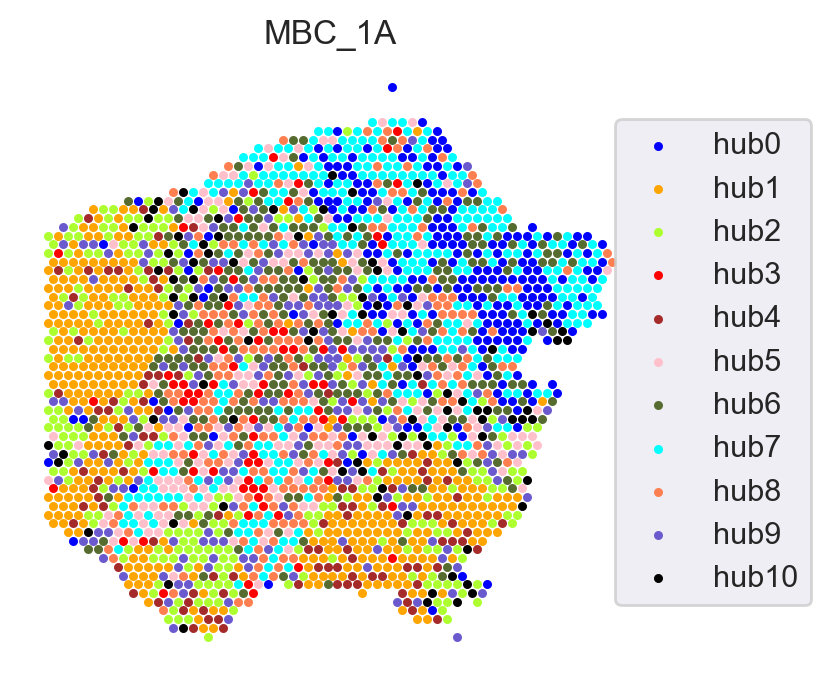

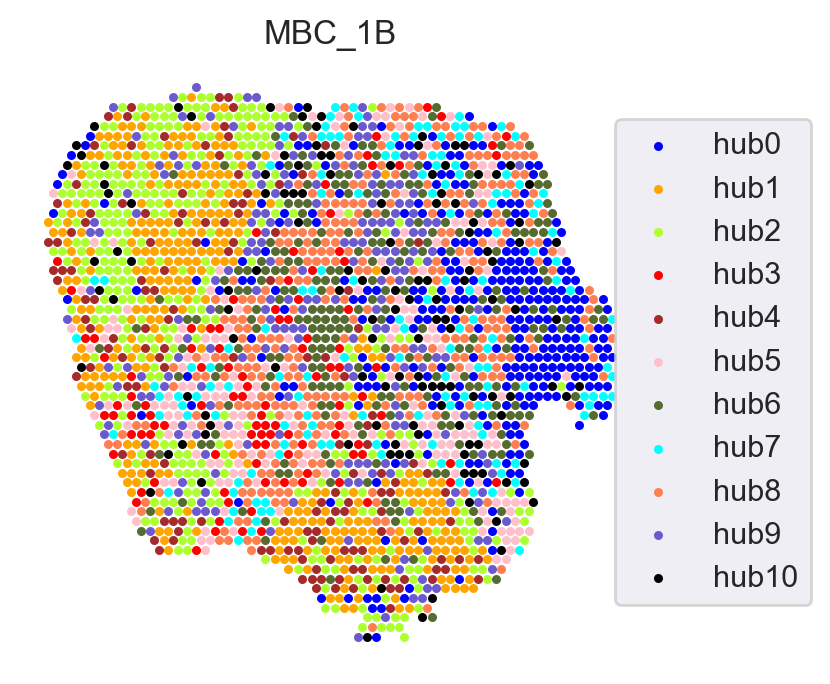

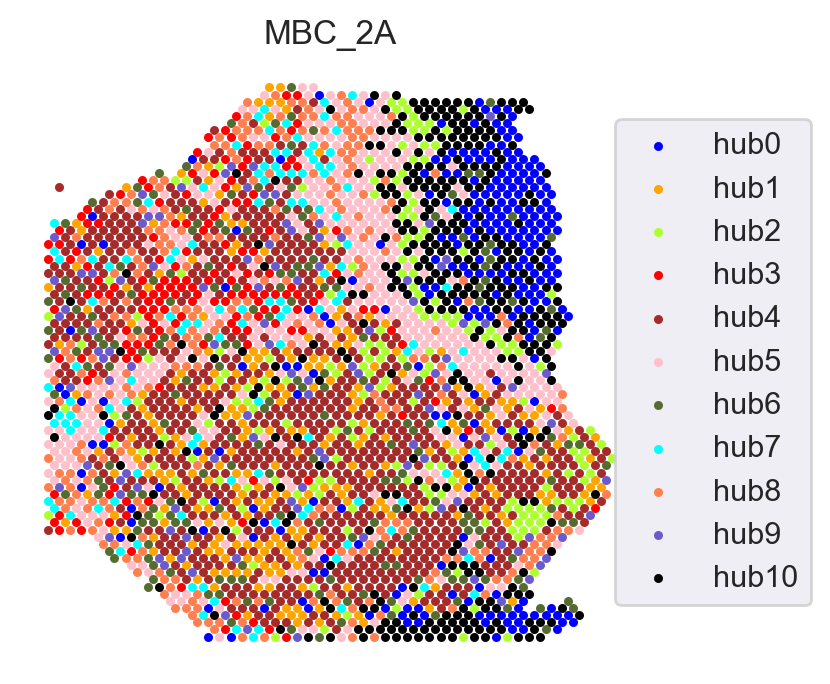

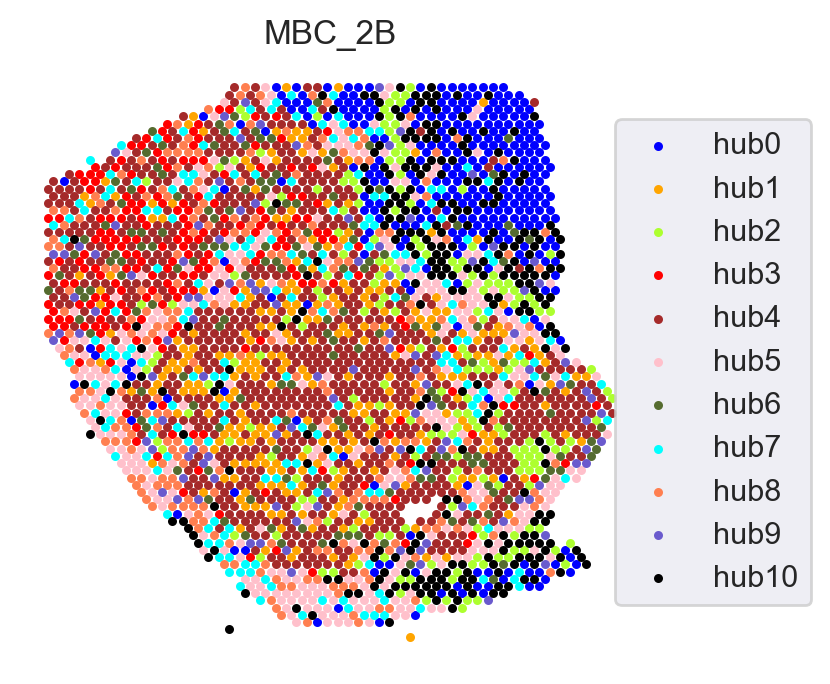

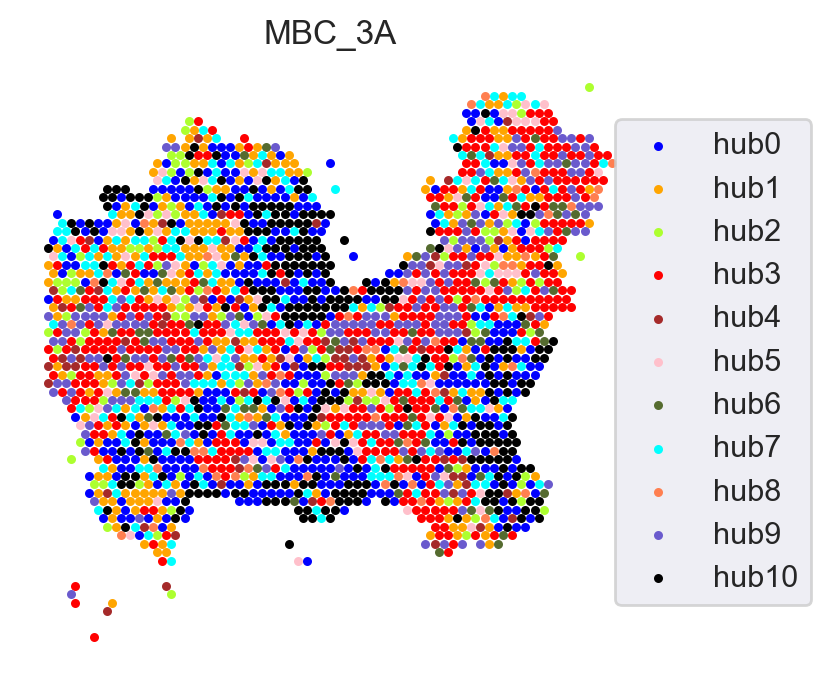

...

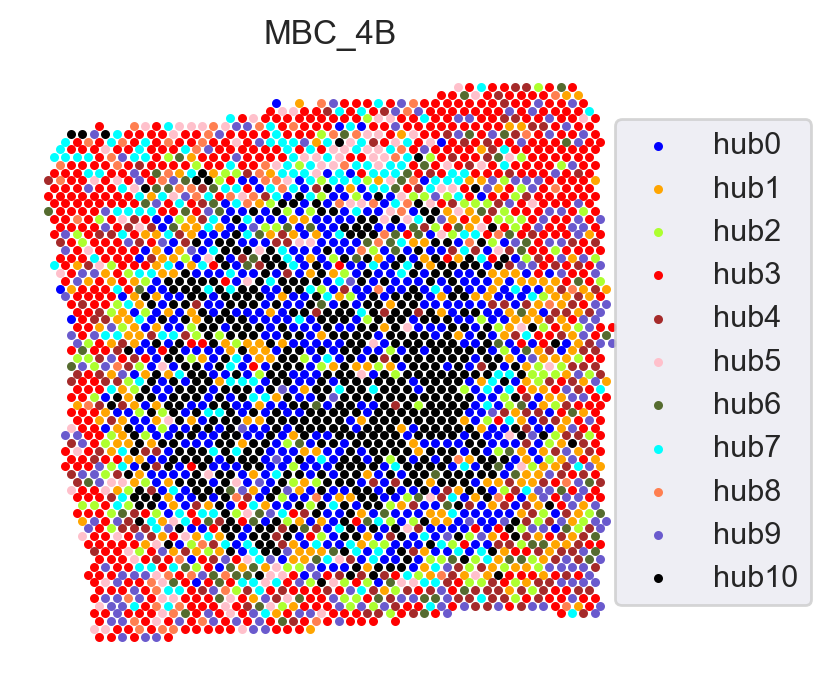

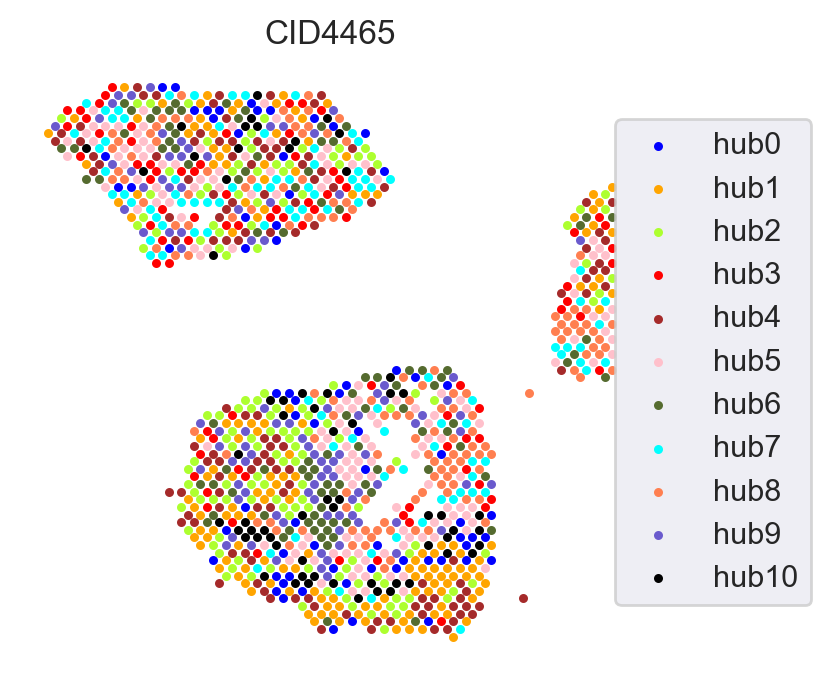

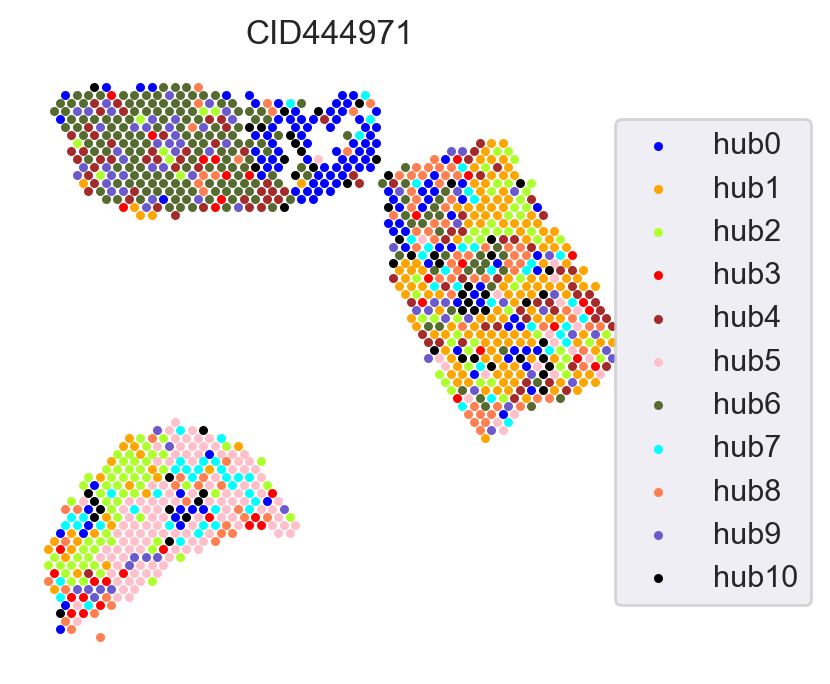

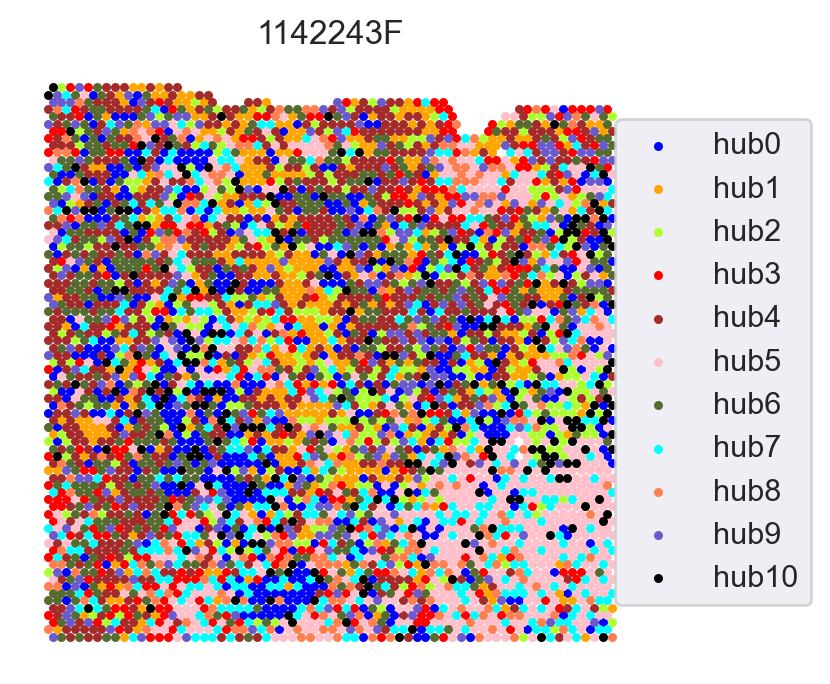

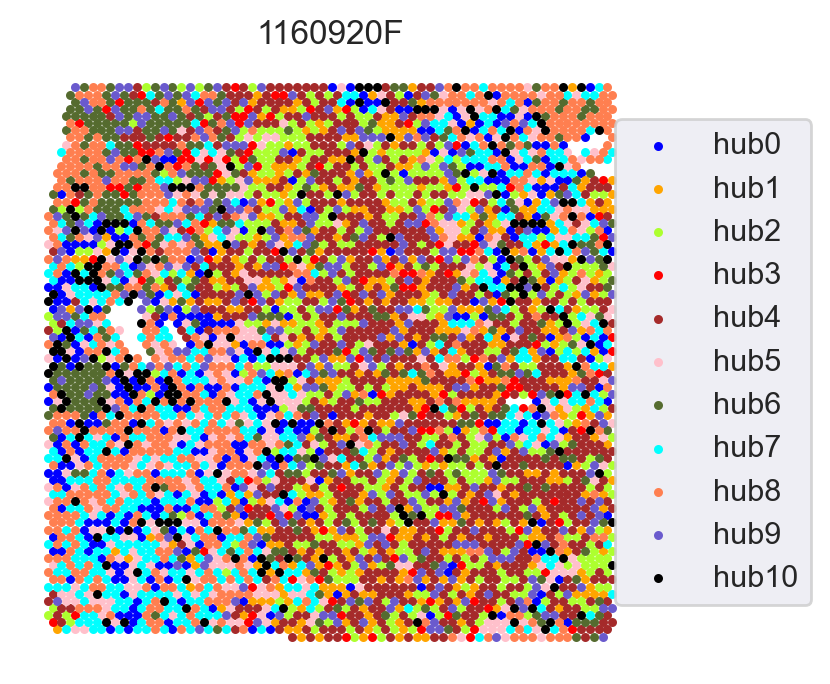

In [219]:
# load all expression data  [spot x gene]
data_path = 'data'
sample_ids = ['MBC_1A',
             'MBC_1B',
             'MBC_2A',
             'MBC_2B',
             'MBC_3A',
             'MBC_3B',
             'MBC_4A',
             'MBC_4B',
             'CID4465',
             'CID444971',
             '1142243F',
             '1160920F'
            ]

for sample_id in sample_ids:
    data_path = '../data'
    if sample_id.startswith('MBC'):

        adata_sample = sc.read_visium(path=os.path.join(data_path, sample_id),library_id =  sample_id)
        adata_sample.var_names_make_unique()
        adata_sample.obs['sample']=sample_id
        adata_sample.obs_names  = adata_sample.obs_names+'-'+sample_id
    else:
        adata_sample = sc.read_h5ad(os.path.join(data_path,sample_id, sample_id+'.h5ad'))
        adata_sample.var_names_make_unique()
        adata_sample.obs['sample']=sample_id
        adata_sample.obs_names  = adata_sample.obs_names+'-'+sample_id
        
    cluster_id = pd.DataFrame((np.zeros(len(adata_sample.obs_names))*(-1)).astype(int),columns=['clusters'],index=adata_sample.obs_names)
    
    col_order_df = pd.read_csv('../results/03_hubs/'+'alltumors_bicluster_res_col_orders_individual.csv')
    row_order_df = pd.read_csv('../results/03_hubs/'+'alltumors_bicluster_res_row_orders_individual.csv')
    
    map_info = pd.read_csv("../results/02_PoE_factor/"+sample_id+'map_info.csv',index_col=0)
    
    for i in adata_sample.obs_names:
        if i in np.array(row_order_df.loc[:,'id']):
            cluster_id.loc[i,'clusters']= (row_order_df.loc[np.where(row_order_df['id']==i)[0][0],'cluster']).astype(object)
    adata_sample.obs['hub'] =  cluster_id
    
    
    
    fig,axs=plt.subplots(1,1,figsize=(4,4),dpi=200)

    ax=axs
    for i in range(11):
        all_loc = np.array(map_info.loc[cluster_id[cluster_id.clusters==i].index,:].loc[:,['array_col','array_row']])
        #all_spot = np.array(row_order_df[row_order_df.cluster==i].loc[:,'cluster'])
        ax.scatter(all_loc[:,0],-all_loc[:,1],s=5)
    
    ax.set_aspect("auto")
    ax.legend(['hub0','hub1','hub2','hub3','hub4','hub5','hub6','hub7','hub8','hub9','hub10'],loc='right',bbox_to_anchor=(0,0, 1.3, 1.))
    plt.grid(False),
    plt.axis('off')
    plt.title(sample_id)
        

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Vari

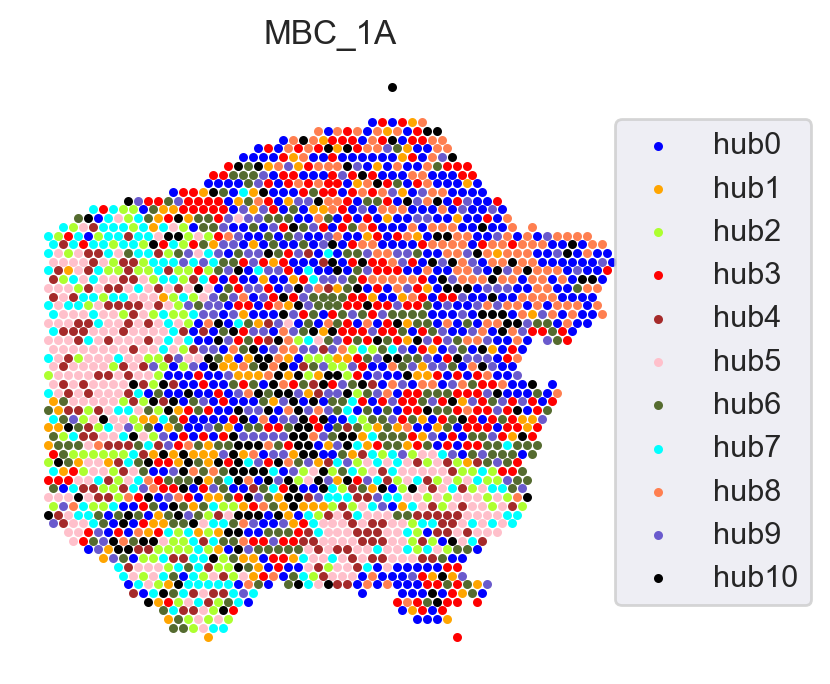

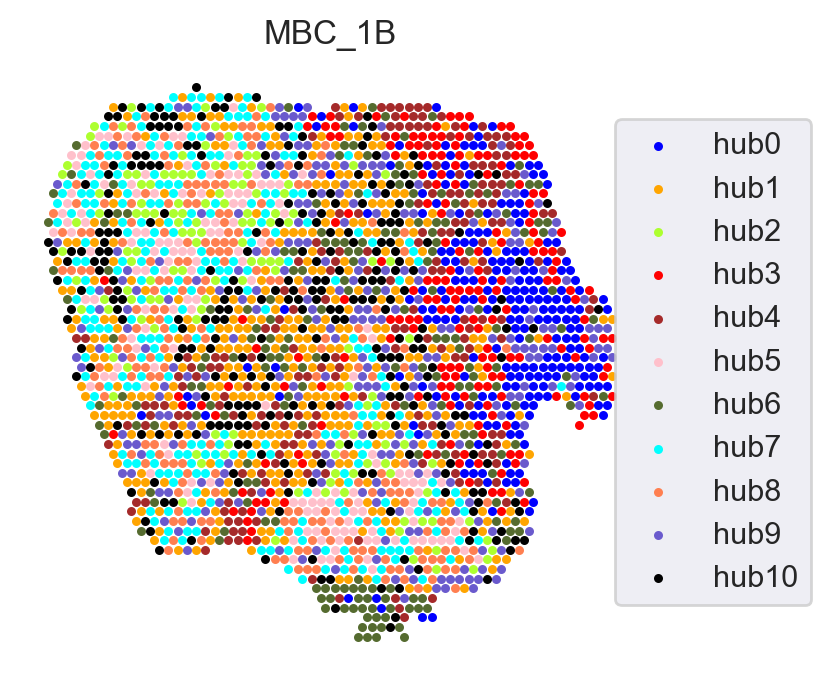

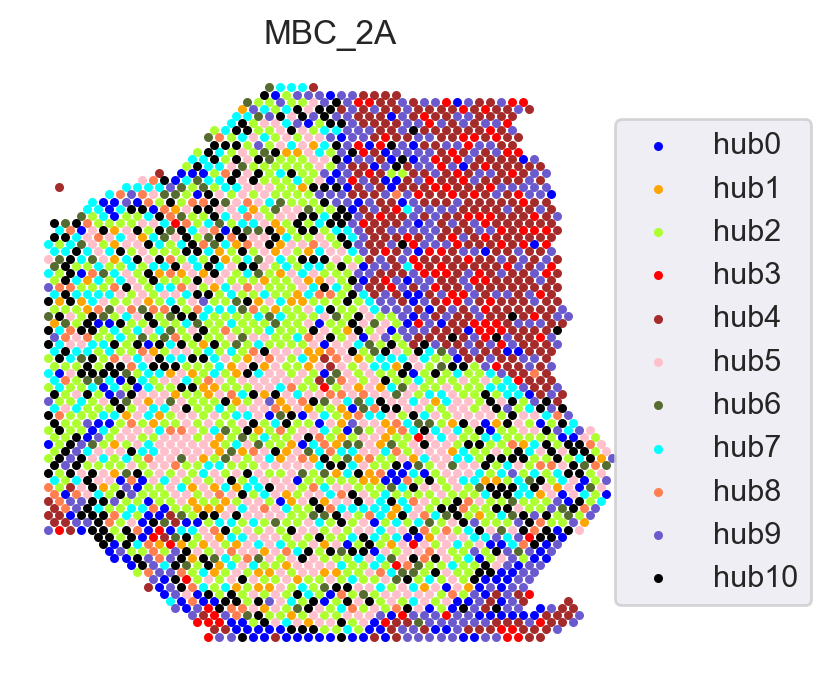

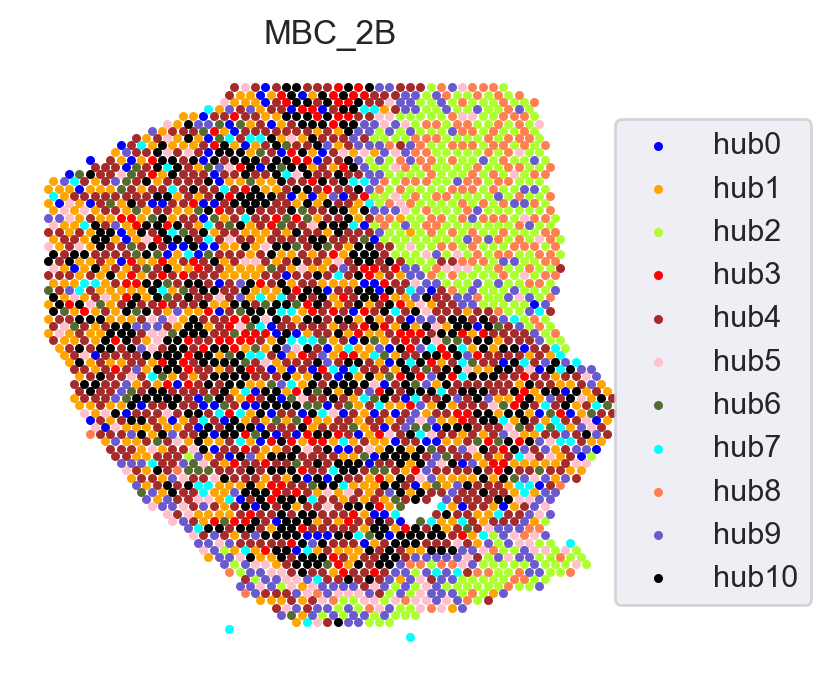

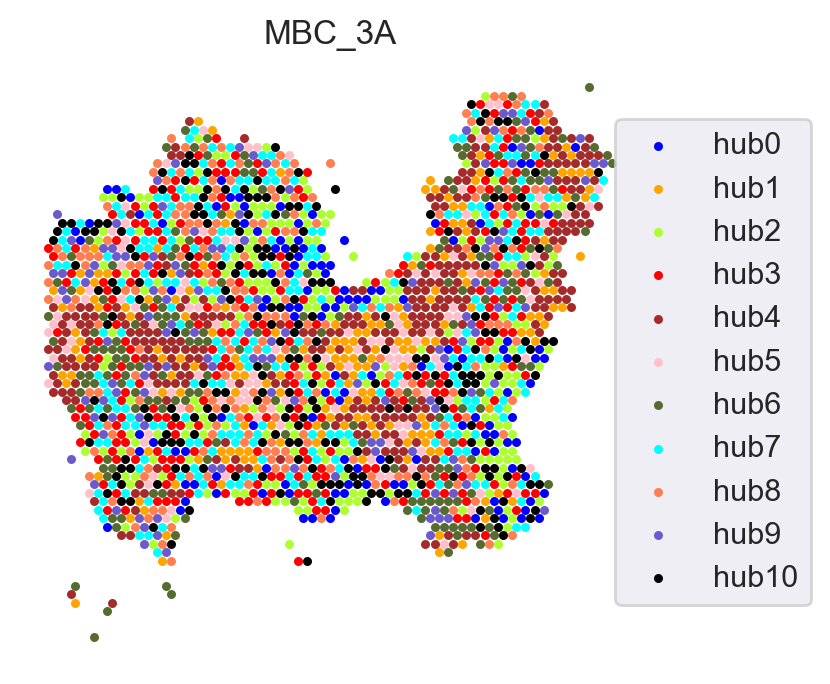

...

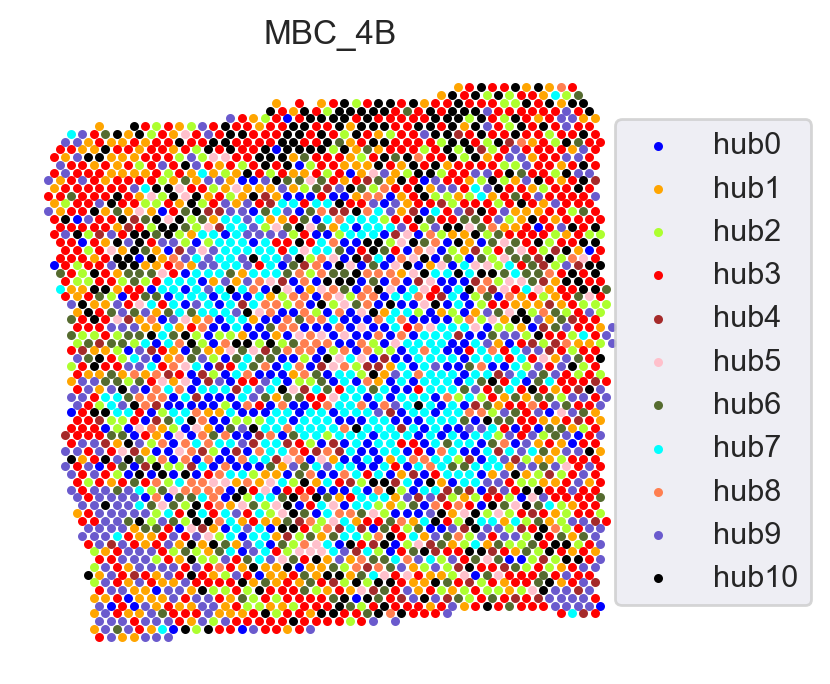

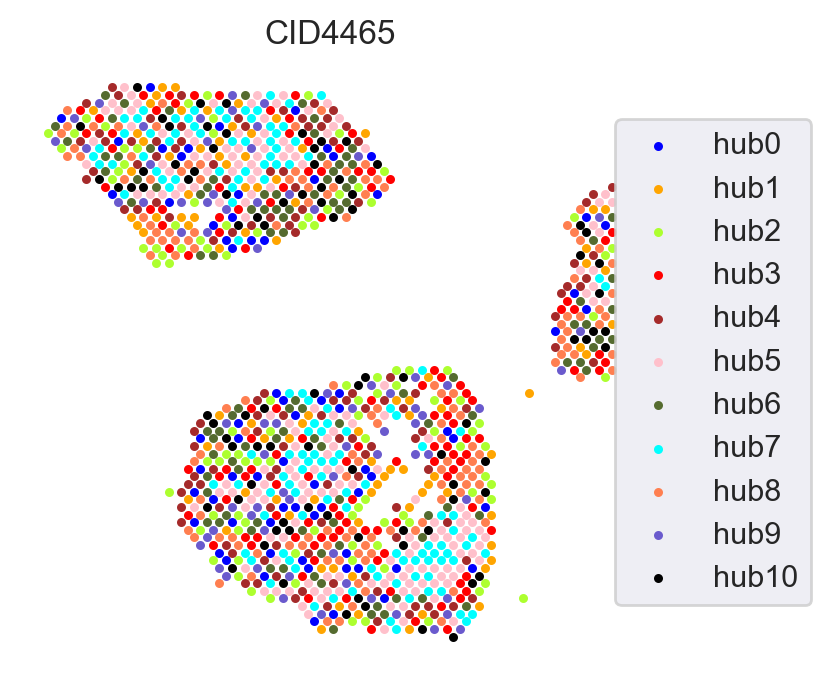

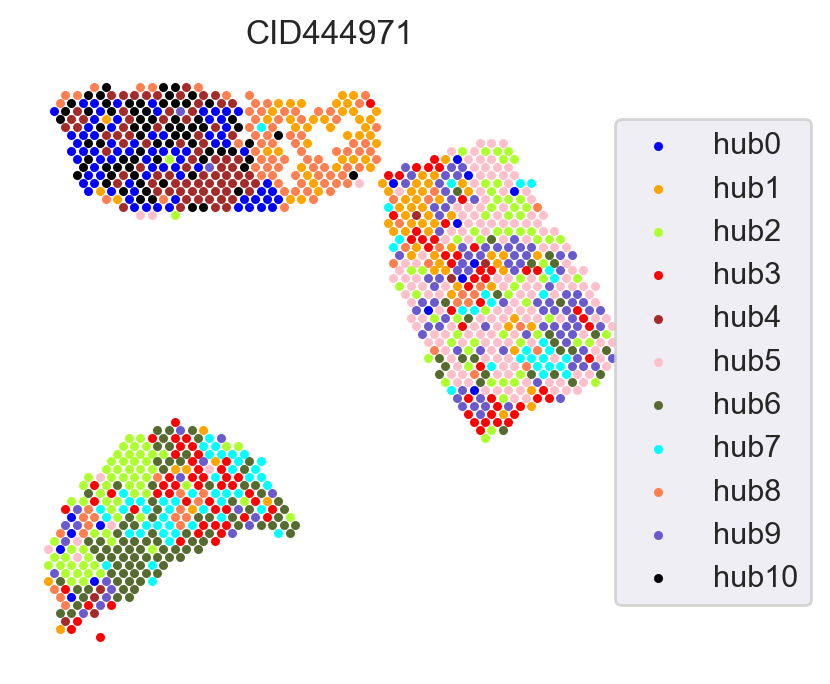

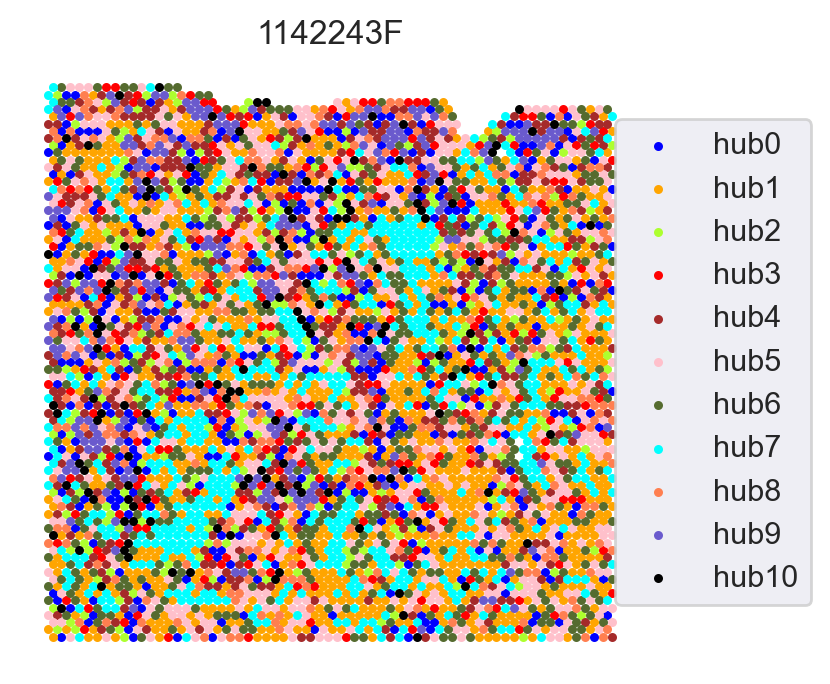

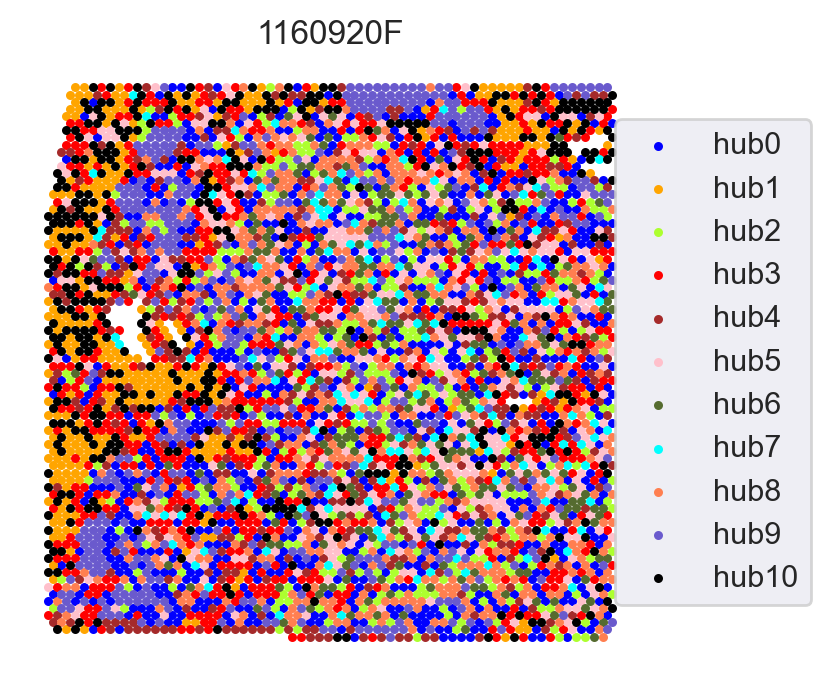

In [218]:
# load all expression data  [spot x gene]
data_path = 'data'
sample_ids = ['MBC_1A',
             'MBC_1B',
             'MBC_2A',
             'MBC_2B',
             'MBC_3A',
             'MBC_3B',
             'MBC_4A',
             'MBC_4B',
             'CID4465',
             'CID444971',
             '1142243F',
             '1160920F'
            ]

for sample_id in sample_ids:
    data_path = '../data'
    if sample_id.startswith('MBC'):

        adata_sample = sc.read_visium(path=os.path.join(data_path, sample_id),library_id =  sample_id)
        adata_sample.var_names_make_unique()
        adata_sample.obs['sample']=sample_id
        adata_sample.obs_names  = adata_sample.obs_names+'-'+sample_id
    else:
        adata_sample = sc.read_h5ad(os.path.join(data_path,sample_id, sample_id+'.h5ad'))
        adata_sample.var_names_make_unique()
        adata_sample.obs['sample']=sample_id
        adata_sample.obs_names  = adata_sample.obs_names+'-'+sample_id
        
    cluster_id = pd.DataFrame((np.zeros(len(adata_sample.obs_names))*(-1)).astype(int),columns=['clusters'],index=adata_sample.obs_names)
    
    col_order_df = pd.read_csv('../results/03_hubs/'+sample_id+'_bicluster_res_col_orders_individual.csv')
    row_order_df = pd.read_csv('../results/03_hubs/'+sample_id+'_bicluster_res_row_orders_individual.csv')
    
    map_info = pd.read_csv("../results/02_PoE_factor/"+sample_id+'map_info.csv',index_col=0)
    
    for i in adata_sample.obs_names:
        if i in np.array(row_order_df.loc[:,'id']):
            cluster_id.loc[i,'clusters']= (row_order_df.loc[np.where(row_order_df['id']==i)[0][0],'cluster']).astype(object)
    adata_sample.obs['hub'] =  cluster_id
    
    
    
    fig,axs=plt.subplots(1,1,figsize=(4,4),dpi=200)

    ax=axs
    for i in range(11):
        all_loc = np.array(map_info.loc[cluster_id[cluster_id.clusters==i].index,:].loc[:,['array_col','array_row']])
        #all_spot = np.array(row_order_df[row_order_df.cluster==i].loc[:,'cluster'])
        ax.scatter(all_loc[:,0],-all_loc[:,1],s=5)
    
    ax.set_aspect("auto")
    ax.legend(['hub0','hub1','hub2','hub3','hub4','hub5','hub6','hub7','hub8','hub9','hub10'],loc='right',bbox_to_anchor=(0,0, 1.3, 1.))
    plt.grid(False),
    plt.axis('off')
    plt.title(sample_id)